#### Libraries

In [2]:
import pandas as pd
import numpy as np
import os
from tqdm import tqdm
import matplotlib.pyplot as plt
import plotly.express as px
import requests
import time
import xml.etree.ElementTree as ET
from sklearn.preprocessing import MinMaxScaler
### multiple testing
from scipy.stats import hypergeom
from statsmodels.stats.multitest import multipletests


import networkx as nx
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from matplotlib.colors import LinearSegmentedColormap

## Data

#### Drug bank

In [3]:
# import xml.etree.ElementTree as ET

# # Load XML
# drugbank_xml = 'Data/DGIDB/drug_bank.xml'
# tree = ET.parse(drugbank_xml)
# root = tree.getroot()

# # Namespace
# ns = {'db': 'http://www.drugbank.ca'}

# Helper to clean tag names
def clean_tag(tag):
    return tag.split('}')[-1] if '}' in tag else tag

# Recursive function to print structure
def print_structure(elem, level=0):
    indent = '  ' * level
    print(f"{indent}- {clean_tag(elem.tag)}")
    for child in elem:
        print_structure(child, level + 1)

# # Get first drug
# first_drug = root.find('db:drug', ns)

# print("🌿 Structure of First Drug Entry:")
# print_structure(first_drug)
# print("\n🌳 Structure of First 3 Drug Entries:")
# drugs = root.findall('db:drug', ns)

# for i, drug in enumerate(drugs[:3]):
#     print(f"\n🔬 Drug {i+1}:")
#     print_structure(drug)


In [4]:
def structure_drug_bank_data(drug_bank_file = 'Data/DGIDB/drug_bank.xml'):
    """
    Function to structure the drug bank data from the XML file.
    :param drug_bank_file: Path to the drug bank XML file.
    :return: DataFrame containing structured drug bank data.
    """
    ### FYI the .find command only finds the first instance of a tag, 
    ### while .findall retrieves all instances of the specified tag within the current element.

    tree = ET.parse(drug_bank_file)
    root = tree.getroot()

    # DrugBank uses a specific namespace
    ns = {'db': 'http://www.drugbank.ca'}
    ### extract all drug elements
    drugs = root.findall('db:drug', ns)
    print(f"Found {len(drugs)} drugs in the DrugBank XML.")
    # Extract drug-gene interactions
    interactions = []
    # The interactions list will store dictionaries with 'drug' and 'gene' keys.
    for drug in root.findall('db:drug', ns): # root.findall('db:drug', ns): Finds all <drug> elements using the namespace.
        drug_name  = drug.find('db:name', ns).text  # drug.find('db:name', ns): Gets the drug's name.
        # print(drug_name)
        for target in drug.findall('db:targets/db:target', ns):  # drug.findall('db:targets/db:target', ns): Finds all <target> elements within <targets>.
            # print(target.tag)
            gene_description = target.find('db:name', ns)  # target.find('db:name', ns): Extracts the gene name for each target.
            poly = target.find('db:polypeptide', ns)  # target.find('db:polypeptide', ns): Extracts the polypeptide information.
            action = target.find('db:actions/db:action', ns) # target.find('db:actions/db:action', ns): Extracts the action of the drug on the target.
            if poly is not None:
                poly_name = poly.find('db:name', ns)
                gene_name = poly.find('db:gene-name', ns)
                specific_function = poly.find('db:specific-function', ns)
                interactions.append({
                    'drug': drug_name,
                    'polypeptide': poly_name.text if poly_name is not None else None,
                    'gene': gene_name.text if gene_name is not None else None,
                    'gene_description': gene_description.text if gene_description is not None else None,
                    'action': action.text if action is not None else None,
                    'specific_function': specific_function.text if specific_function is not None else None
                })
            ############# if polypeptide is not present, we still want to add the drug and gene information
            ############# this is because some drugs may not have a polypeptide associated with them
            ############# but we still want to capture the drug and gene information
            ############# this is common in the DrugBank database, where some drugs target genes directly
            ############# and do not have a polypeptide associated with them

            else:
                gene_name = None
                specific_function = None
                poly_name = None
                action = None
                gene_description = None
                resource = None
                identifier = None
  
                interactions.append({
                        'drug': drug_name,
                        'polypeptide': poly_name.text if poly_name is not None else None,
                        'gene': gene_name.text if gene_name is not None else None,
                        'gene_description': gene_description.text if gene_description is not None else None,
                        'action': action.text if action is not None else None,
                        'specific_function': specific_function.text if specific_function is not None else None
                    })
        
    # Convert to DataFrame
    # Converts the list of dictionaries into a pandas DataFrame, which is easier to analyze, filter, and export.
    df = pd.DataFrame(interactions)

    return df

In [5]:
Drug_bank = structure_drug_bank_data('Data/DGIDB/drug_bank.xml')

Found 17430 drugs in the DrugBank XML.


In [6]:
print(f"{len(set(Drug_bank['drug']))} unique drugs found in DrugBank.")
print(f"{len(set(Drug_bank['gene']))} unique genes found in DrugBank.")
print(f"{len(set(tuple(Drug_bank['drug'] + Drug_bank['gene'])))} unique drug-gene pairs found in DrugBank.")
print(f"{len(Drug_bank)} size of DrugBank interactions found in DrugBank.")

9368 unique drugs found in DrugBank.
4187 unique genes found in DrugBank.
21714 unique drug-gene pairs found in DrugBank.
23136 size of DrugBank interactions found in DrugBank.


#### Known cancer medications

In [7]:
chemotherapy_medications = ['cisplatin', 'carboplatin', 'paclitaxel', 'docetaxel', '5-fluorouracil', '5-fu', 'fluorouracil','capecitabine', 'gemcitabine', 'doxorubicin', 'adriamycin', 'epirubicin', 'cyclophosphamide', 'cyclophosphamide', 'ifosfamide', 'etoposide', 'irinotecan', 'topotecan', 'vinorelbine', 'vinblastine', 'vincristine', 'bleomycin', 'mitomycin', 'mitoxantrone', 'oxaliplatin', 'pemetrexed', 'docetaxel', 'paclit', 'hydroxyurea', 'taxotere']
immuno_medications = ['pembrolizumab', 'toripalimab', 'nivolumab', 'avastin', 'bevacizumab', 'erbitux', 'cetuximab', 'keytruda', 'opdivo', 'yervoy', 'ipilimumab', 'revlimid', 'lenalidomide', 'thalomid', 'thalidomide']
known_hnc_medications = ['cisplatin', 'carboplatin', 'paclitaxel', 'docetaxel', '5-fluorouracil', '5-fu', 'fluorouracil','capecitabine', 'gemcitabine', 'doxorubicin', 'adriamycin',
                          'epirubicin', 'cyclophosphamide', 'cyclophosphamide', 'ifosfamide', 'etoposide', 'irinotecan', 'topotecan', 'vinorelbine', 'vinblastine', 'vincristine', 
                          'bleomycin', 'mitomycin', 'mitoxantrone', 'oxaliplatin', 'pemetrexed', 'docetaxel', 'paclit', 'hydroxyurea', 'taxotere', 'pembrolizumab', 'toripalimab', 'nivolumab',
                          'avastin', 'bevacizumab', 'erbitux', 'cetuximab', 'keytruda', 'opdivo', 'yervoy', 'ipilimumab', 'revlimid', 'lenalidomide', 'thalomid', 'thalidomide']

In [8]:
head_and_neck_medications = ['Bleomycin Sulfate','Cetuximab','Docetaxel', 'Erbitux', 'cetuximab', 'Hydrea', 'hydroxyurea', 'Hydroxyurea', 'Keytruda', 'Pembrolizumab',
                             'Loqtorzi','Toripalimab', 'Methotrexate','Nivolumab','Hyaluronidase','Opdivo','nivolumab','Opdivo Qvantigo', 'Penpulimab',
                             'Taxotere', 'Toripalimab-tpzi', 'carboplatin','cisplatin', 'trexall']
head_and_neck_medications = [med.lower() for med in head_and_neck_medications]
head_and_neck_medications = [med.lower() for med in known_hnc_medications]


In [9]:
cancer_medications = [
    'bevacizumab', 'cetuximab', 'cisplatin', 'carboplatin', 'docetaxel', 'paclitaxel', 
    '5-fluorouracil', 'methotrexate', 'doxorubicin', 'cyclophosphamide', 'ifosfamide', 
    'etoposide', 'gemcitabine', 'irinotecan', 'oxaliplatin', 'temozolomide', 'vincristine', 
    'vinblastine', 'bleomycin', 'mitomycin', 'topotecan', 'capecitabine', 'pemetrexed', 
    'sunitinib', 'sorafenib', 'imatinib', 'erlotinib', 'gefitinib', 'lapatinib', 
    'trastuzumab', 'rituximab', 'alemtuzumab', 'bortezomib', 'lenalidomide', 'thalidomide',
    'temsirolimus', 'everolimus', 'abiraterone', 'enzalutamide', 'apalutamide', 'olaparib', 'niraparib',
    'rucaparib', 'talazoparib', 'pazopanib', 'axitinib', 'cabozantinib', 'vandetanib', 'crizotinib',
    'alectinib', 'brigatinib', 'lorlatinib', 'ceritinib', 'dabrafenib', 'trametinib', 'vemurafenib',
    'cobimetinib', 'binimetinib', 'ipilimumab', 'nivolumab', 'pembrolizumab', 'atezolizumab', 'durvalumab',
    'avelumab', 'nivolumab', 'cemiplimab', 'tivozanib', 'lenvatinib', 'regorafenib', 'ramucirumab',
    'trastuzumab emtansine', 'trastuzumab deruxtecan', 'polatuzumab vedotin', 'brentuximab vedotin',
    'inotuzumab ozogamicin', 'moxetumomab pasudotox', 'tagraxofusp', 'belantamab mafodotin', 'zinc', 'nivitolumab', 'zinc chloride', 'zinc acetate', 'copper',
    'pralsetinib', 'erdafitinib']

#### PPI

In [10]:
protein_interaction = pd.read_csv('Data/Protein-protein interaction data/9606.protein.links.v12.0.txt', sep= ' ')
protein_interaction_full = pd.read_csv('Data/Protein-protein interaction data/9606.protein.links.full.v12.0.txt', sep= ' ')
protein_interaction_detailed = pd.read_csv('Data/Protein-protein interaction data/9606.protein.links.detailed.v12.0.txt', sep= ' ')
### convert proteins to their true names
protein_info = pd.read_csv('Data/Protein-protein interaction data/9606.protein.info.v12.0.txt', on_bad_lines='skip', sep='\t')
protein_aliases= pd.read_csv('Data/Protein-protein interaction data/9606.protein.aliases.v12.0.txt', on_bad_lines='skip', sep='\t')

In [11]:
### convert proteins to their true names
protein_info = pd.read_csv('Data/Protein-protein interaction data/9606.protein.info.v12.0.txt', on_bad_lines='skip', sep='\t')
protein_aliases= pd.read_csv('Data/Protein-protein interaction data/9606.protein.aliases.v12.0.txt', on_bad_lines='skip', sep='\t')

# Method 1: Using the to_dict() method with 'index' as orient
protein_info_translate_name_dict = protein_info.set_index('#string_protein_id')['preferred_name'].to_dict()
protein_alias_translate_name_dict = protein_aliases.set_index('#string_protein_id')['alias'].to_dict()
#print(protein_info_translate_name_dict)

### Protein1
protein1_name = []
for prot_id in tqdm(protein_interaction['protein1']):
    if prot_id in protein_info_translate_name_dict:
        protein1_name.append(protein_info_translate_name_dict[prot_id])
    elif prot_id in protein_alias_translate_name_dict:
        protein1_name.append(protein_alias_translate_name_dict[prot_id])
    else:
        protein1_name.append('')

### Protein 2
protein2_name = []
for prot_id in tqdm(protein_interaction['protein2']):
    if prot_id in protein_info_translate_name_dict:
        protein2_name.append(protein_info_translate_name_dict[prot_id])
    elif prot_id in protein_alias_translate_name_dict:
        protein2_name.append(protein_alias_translate_name_dict[prot_id])
    else:
        protein2_name.append('')

protein_interaction['Translated_protein_1'] = protein1_name
protein_interaction['Translated_protein_2'] = protein2_name

# Create a set of all (protein1, protein2) pairs
ppi_pairs = set(zip(protein_interaction['Translated_protein_1'], protein_interaction['Translated_protein_2']))
# Check for missing reverse pairs
missing_reverse = []
for a, b in ppi_pairs:
    if (b, a) not in ppi_pairs:
        missing_reverse.append((a, b))

print(f"Number of pairs missing their reverse: {len(missing_reverse)}")
if missing_reverse:
    print("Examples:", missing_reverse[:10])
else:
    print("All pairs have their reverse present.")

100%|██████████| 13715404/13715404 [00:02<00:00, 5177181.09it/s]


Number of pairs missing their reverse: 0
All pairs have their reverse present.


In [12]:
protein_interaction

,protein1,protein2,combined_score,Translated_protein_1,Translated_protein_2
0,9606.ENSP00000000233,9606.ENSP00000356607,173,ARF5,RALGPS2
1,9606.ENSP00000000233,9606.ENSP00000427567,154,ARF5,FHDC1
2,9606.ENSP00000000233,9606.ENSP00000253413,151,ARF5,ATP6V1E1
3,9606.ENSP00000000233,9606.ENSP00000493357,471,ARF5,CYTH2
4,9606.ENSP00000000233,9606.ENSP00000324127,201,ARF5,PSD3
...,...,...,...,...,...
13715399,9606.ENSP00000501317,9606.ENSP00000475489,195,RFX7,MPHOSPH9
13715400,9606.ENSP00000501317,9606.ENSP00000370447,158,RFX7,VCX
13715401,9606.ENSP00000501317,9606.ENSP00000312272,226,RFX7,YPEL2
13715402,9606.ENSP00000501317,9606.ENSP00000402092,169,RFX7,SAMD3


#### CNV Results

In [13]:
hpv_positive_amplification_top_genes = pd.read_csv('Results/CNV results/HPV positive amplification top genes.csv')
hpv_positive_amplification_df = pd.read_csv('Results/CNV results/HPV positive amplification genes.csv')
hpv_positive_deletion_top_genes = pd.read_csv('Results/CNV results/HPV positive deletion top genes.csv')
hpv_positive_deletion_df = pd.read_csv('Results/CNV results/HPV positive deletion genes.csv')
hpv_negative_amplification_top_genes = pd.read_csv('Results/CNV results/HPV negative amplification top genes.csv')
hpv_negative_amplification_df = pd.read_csv('Results/CNV results/HPV negative amplification genes.csv')
hpv_negative_deletion_top_genes = pd.read_csv('Results/CNV results/HPV negative deletion top genes.csv')
hpv_negative_deletion_df = pd.read_csv('Results/CNV results/HPV negative deletion genes.csv')

In [14]:
hpv_positive_amplification_top_genes[hpv_positive_amplification_top_genes['gene_name'].isin(protein_interaction['Translated_protein_1'])]['gene_name'].unique()

array(['SOX2', 'RTP2', 'SST', 'LPP', 'TPRG1', 'TP63', 'RTP1', 'MASP1',
       'RTP4', 'BCL6', 'RFC4', 'DGKG', 'DNAJB11', 'TTC14', 'TBCCD1',
       'ST6GAL1', 'FXR1', 'NDUFB5', 'IGF2BP2', 'TRA2B', 'ZMAT3', 'GNB4',
       'MRPL47', 'USP13', 'ACTL6A', 'MFN1', 'P3H2', 'CCDC39', 'EIF4A2',
       'ZNF639', 'KCNMB3', 'PIK3CA', 'DNAJC19', 'KNG1', 'FETUB', 'AHSG',
       'ETV5', 'ADIPOQ', 'HRG', 'CRYGS', 'RPL39L', 'IL1RAP', 'PEX5L',
       'GMNC', 'TMEM207', 'PYDC2', 'CLDN1', 'CLDN16'], dtype=object)

In [15]:
protein_interaction[protein_interaction['Translated_protein_1'].isin(hpv_positive_amplification_top_genes['gene_name'])][protein_interaction['combined_score']>700]['Translated_protein_2'].nunique()

/var/folders/5p/swntgnbj3fbfxkx02kt3fq980000gn/T/ipykernel_51208/985899911.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  protein_interaction[protein_interaction['Translated_protein_1'].isin(hpv_positive_amplification_top_genes['gene_name'])][protein_interaction['combined_score']>700]['Translated_protein_2'].nunique()


1874

In [16]:
hpv_positive_amplification_top_genes[hpv_positive_amplification_top_genes['gene_name'].isin(Drug_bank['gene']) | hpv_positive_amplification_top_genes['gene_name'].isin(protein_interaction['Translated_protein_1']) ].sort_values(by = ['gistic_score',  'q_value'], ascending = [False, True])

,gene,gene_name,Sample_size,amplification_count,Amplification_sum (i.e. total log2(amplification CNV) across samples),Amplification_sum_prevalence,frequency_percentage,gistic_score,p_value,q_value,significant,empirical_p_value,empirical_q_value,empirical_significant,chromosome,start,end,length,coverage_percentage
14,ENSG00000198471.1,RTP2,221,76,201.976241,0.913920,34.389140,0.314289,2.876220e-42,9.686950e-39,True,0.000999,0.011719,True,chr3,187698259,187702557,4299,0.002168
16,ENSG00000157005.4,SST,221,76,201.976241,0.913920,34.389140,0.314289,2.876220e-42,9.686950e-39,True,0.000999,0.011719,True,chr3,187668912,187670394,1483,0.000748
12,ENSG00000181449.4,SOX2,221,76,201.479589,0.911672,34.389140,0.313516,2.876220e-42,9.686950e-39,True,0.000999,0.011719,True,chr3,181711925,181714436,2512,0.001267
36,ENSG00000113916.18,BCL6,221,75,201.391278,0.911273,33.936652,0.309255,2.850984e-41,4.671222e-38,True,0.000999,0.011719,True,chr3,187721377,187745725,24349,0.012279
31,ENSG00000136514.3,RTP4,221,75,200.601845,0.907701,33.936652,0.308043,2.850984e-41,4.671222e-38,True,0.000999,0.011719,True,chr3,187368385,187372076,3692,0.001862
28,ENSG00000127241.18,MASP1,221,75,200.186808,0.905823,33.936652,0.307406,2.850984e-41,4.671222e-38,True,0.000999,0.011719,True,chr3,187217282,187291980,74699,0.037671
26,ENSG00000175077.6,RTP1,221,75,199.923773,0.904632,33.936652,0.307002,2.850984e-41,4.671222e-38,True,0.000999,0.011719,True,chr3,187197486,187201462,3977,0.002006
25,ENSG00000073282.14,TP63,221,75,199.536855,0.902882,33.936652,0.306408,2.850984e-41,4.671222e-38,True,0.000999,0.011719,True,chr3,189631389,189897276,265888,0.134087
21,ENSG00000145012.13,LPP,221,75,199.121817,0.901004,33.936652,0.305770,2.850984e-41,4.671222e-38,True,0.000999,0.011719,True,chr3,188153284,188890671,737388,0.371863
23,ENSG00000188001.10,TPRG1,221,75,199.121817,0.901004,33.936652,0.305770,2.850984e-41,4.671222e-38,True,0.000999,0.011719,True,chr3,188947214,189325304,378091,0.190670


## Drug repurposing candidates

#### Drug candidate extraction

In [17]:
def top_drug_candidates(top_gene_df, protein_intereaction_df, Drug_bank = Drug_bank, known_hnc_medications = head_and_neck_medications, plotting = True):
    """
    Function to identify top drug candidates based on gene data and PPI scores.
    :param df: DataFrame containing gene data with necessary columns.
    :param ppi_scores: DataFrame containing PPI scores with necessary columns.
    :param drug_bank: DataFrame containing drug-gene interaction data.
    :param known_hnc_medications: List of known head and neck cancer medications.
    :return: DataFrame of top drug candidates with relevant information.
    """
    # Merge gene data with PPI scores
    top_genes_connected = protein_intereaction_df[protein_intereaction_df['Translated_protein_1'].isin(top_gene_df['gene_name'])]
    top_genes_connected = top_genes_connected[top_genes_connected['combined_score']>700] # PPI cut off for high confidence protien protein interactions
    
    total_genes = len(set(top_genes_connected['Translated_protein_1']).union(set(top_genes_connected['Translated_protein_2'])))

    print(f'Total number of genes in the protein interaction database: {total_genes}')
    print("These are the top gene candidates along with the genes found to be immediate neighbors through the STRING protein interaction database.")

    final_db = pd.DataFrame()
    df_row_list = []

    for j,gene in tqdm(enumerate(top_genes_connected['Translated_protein_2']), desc='Processing connected genes'):
            protein_1 = top_genes_connected.iloc[j]['Translated_protein_1']
            PPI_score = top_genes_connected.iloc[j]['combined_score']
            identified_meds = Drug_bank[Drug_bank['gene'] == gene]
            if identified_meds.empty:
                continue
            for i,med in enumerate(identified_meds['drug']):
                # if pd.isnull(identified_meds.iloc[i]['drug_name']) or identified_meds.iloc[i]['drug_name'] == '':
                #     med = identified_meds.iloc[i]['drug_claim_name']
                new_data = {
                    'GENE_TARGET': gene,
                    'CONNECTED_TO': protein_1,
                    'PPI_SCORE': PPI_score,
                    'DRUG': med,
                    'GISTIC2.0': top_gene_df[top_gene_df['gene_name'] == protein_1]['GISTIC2.0'].values[0] if not top_gene_df[top_gene_df['gene_name'] == protein_1].empty else np.nan,
                    'normalized_gistic_2.0_score': top_gene_df[top_gene_df['gene_name'] == protein_1]['normalized_gistic_2.0_score'].values[0] if not top_gene_df[top_gene_df['gene_name'] == protein_1].empty else np.nan,
                    'frequency_percentage': top_gene_df[top_gene_df['gene_name'] == protein_1]['frequency_percentage'].values[0] if not top_gene_df[top_gene_df['gene_name'] == protein_1].empty else np.nan,
                    'SIGNIFICANT': top_gene_df[top_gene_df['gene_name'] == protein_1]['significant'].values[0] if not top_gene_df[top_gene_df['gene_name'] == protein_1].empty else np.nan,
                    #'DRUGNOME AI_SCORE': drugnome_scores[drugnome_scores['Gene Name'] == gene]['drugnome_score'].values[0] if not drugnome_scores[drugnome_scores['Gene Name'] == gene].empty else np.nan,
                    'ACTION': identified_meds.iloc[i]['action'] if 'action' in identified_meds.columns else np.nan,
                    'SPECIFIC_FUNCTION': identified_meds.iloc[i]['specific_function'] if 'specific_function' in identified_meds.columns else np.nan
                    }
                new_row = pd.DataFrame(new_data, index=[0])
                df_row_list.append(new_row)

    ### add in direct hits as well
    for gene in tqdm(top_gene_df['gene_name'], desc='Processing direct genes'):
            identified_meds = Drug_bank[Drug_bank['gene'] == gene]
            if identified_meds.empty:
                continue
            for i,med in enumerate(identified_meds['drug']):
                # if pd.isnull(identified_meds.iloc[i]['drug_name']) or identified_meds.iloc[i]['drug_name'] == '':
                #     med = identified_meds.iloc[i]['drug_claim_name']
                new_data = {
                    'GENE_TARGET': gene,
                    'CONNECTED_TO': 'NAN',
                    'PPI_SCORE': 0,
                    'DRUG': med,
                    'GISTIC2.0': top_gene_df[top_gene_df['gene_name'] == gene]['GISTIC2.0'].values[0] if not top_gene_df[top_gene_df['gene_name'] == gene].empty else np.nan,
                    'normalized_gistic_2.0_score': top_gene_df[top_gene_df['gene_name'] == gene]['normalized_gistic_2.0_score'].values[0] if not top_gene_df[top_gene_df['gene_name'] == gene].empty else np.nan,
                    'frequency_percentage': top_gene_df[top_gene_df['gene_name'] == gene]['frequency_percentage'].values[0] if not top_gene_df[top_gene_df['gene_name'] == gene].empty else np.nan,
                    'SIGNIFICANT': top_gene_df[top_gene_df['gene_name'] == gene]['significant'].values[0] if not top_gene_df[top_gene_df['gene_name'] == gene].empty else np.nan,
                    'DRUGNOME AI_SCORE': drugnome_scores[drugnome_scores['Gene Name'] == gene]['drugnome_score'].values[0] if not drugnome_scores[drugnome_scores['Gene Name'] == gene].empty else np.nan,
                    'ACTION': identified_meds.iloc[i]['action'] if 'action' in identified_meds.columns else np.nan,
                    'SPECIFIC_FUNCTION': identified_meds.iloc[i]['specific_function'] if 'specific_function' in identified_meds.columns else np.nan
                    }
                new_row = pd.DataFrame(new_data, index=[0])
                df_row_list.append(new_row)

    final_db = pd.concat(df_row_list, ignore_index=True)
    final_db = final_db[final_db['SIGNIFICANT'] == True]  # Filter for significant genes only, probably not needed as we already filtered the top genes

    #### approved medications fall in the hnc medications
    final_db['approved'] = False
    for i,row in tqdm(final_db.iterrows(), desc = 'check for approved medications'):
        if str.lower(row['DRUG']) in known_hnc_medications:
            final_db.at[i, 'approved'] = True
        else:
            final_db.at[i, 'approved'] = False

    for col in ['GISTIC2.0','PPI_SCORE', 'DRUGNOME AI_SCORE', 'drugnome_score', 'drugnome_score']:
        if col in final_db.columns:
            final_db[col] = final_db[col].fillna(0)
            ### convert 'NA' to 0 for numerical columns
            ### infer_objects is to maintain the old behavior of pandas where it tries to infer the type of the column
            final_db[col] = final_db[col].replace('NA', 0).infer_objects(copy=False)
            final_db[col] = final_db[col].astype(float)
            final_db[f'normalized_{col}'] = MinMaxScaler().fit_transform(final_db[[col]])  # Normalize the columns

    final_db['IS_DIRECT_HIT'] = final_db['CONNECTED_TO'].apply(lambda x: True if x == 'NAN' else False)
    final_db['priority'] = 0
    direct = final_db[final_db['IS_DIRECT_HIT'] == True]
    indirect = final_db[final_db['IS_DIRECT_HIT'] == False]

    #### determine best coefficients for the priority score
    ### make sure coefficients are not zero
    coefficients = {
        'PPI_score': np.arange(0.1, 1.1, 0.1),
        'DrugnomeAI_score': np.arange(0.1, 1.1, 0.1),
        'GISTIC2.0_score': np.arange(0.1, 1.1, 0.1)
    }

    ### need to determine scores on direct and indirect hits
    ### direct calculation
    best_gistic_direct = 0
    best_drugnome_direct = 0
    best_ppi_direct = 0
    best_approved_accuracy_direct = 0
    best_cutoff_direct = 0
    ### make sure direct ppi is zero and not null
    direct['normalized_PPI_SCORE'] = 0
    for ppi_coeff in coefficients['PPI_score']:
        for drugnomeai_coeff in coefficients['DrugnomeAI_score']:
            for gistic_coeff in coefficients['GISTIC2.0_score']:
                if gistic_coeff + ppi_coeff + drugnomeai_coeff != 1.0:
                    continue  # Ensure coefficients sum to 1
                direct['priority'] = (direct['normalized_PPI_SCORE'] * ppi_coeff) + (direct['normalized_DRUGNOME AI_SCORE'] * drugnomeai_coeff) + (direct['normalized_GISTIC2.0'] * gistic_coeff)
                ### need to evaluate different cut off points for the score
                for cutoff in np.arange(0, 1.01, 0.05):
                    direct['PREDICTED_APPROVED'] = direct['priority'] >= cutoff
                    accuracy = (direct['PREDICTED_APPROVED'] == direct['approved']).mean()
                    if accuracy > best_approved_accuracy_direct:
                        best_approved_accuracy_direct = accuracy
                        best_ppi_direct = ppi_coeff
                        best_drugnome_direct = drugnomeai_coeff
                        best_gistic_direct = gistic_coeff
                        best_cutoff_direct = cutoff

    print("before using cutoff:")
    print(f"number of unique genes in direct hits: {len(direct['GENE_TARGET'].unique())}")
    print(f"number of unique drugs in direct hits: {len(direct['DRUG'].unique())}")
    print(f"Best cutoff for direct hits: {best_cutoff_direct}")
    print("Best coefficients for direct hits:")
    print(f"Best coefficients for direct hits: PPI: {best_ppi_direct}, DrugnomeAI: {best_drugnome_direct}, GISTIC2.0: {best_gistic_direct}")
    print(f"Best approved accuracy for direct hits: {best_approved_accuracy_direct * 100:.2f}%")
    print(f"Best cutoff for direct hits: {best_cutoff_direct}")
    direct['priority'] = (direct['normalized_PPI_SCORE'] * best_ppi_direct) + (direct['normalized_DRUGNOME AI_SCORE'] * best_drugnome_direct) + (direct['normalized_GISTIC2.0'] * best_gistic_direct)
    top_direct = direct[direct['priority'] >= best_cutoff_direct].copy()
    print(f"Number of direct hits with priority score above cutoff: {len(top_direct)}")
    print(f"number of unique genes in direct hits: {len(top_direct['GENE_TARGET'].unique())}")
    print(f"number of unique drugs in direct hits: {len(top_direct['DRUG'].unique())}")
    best_direct_coefficients = {
        'PPI_score': best_ppi_direct,
        'DrugnomeAI_score': best_drugnome_direct,
        'GISTIC2.0_score': best_gistic_direct
    }

    ##### Calculate prirortty score for indirect hits
    best_gistic_indirect = 0
    best_drugnome_indirect = 0
    best_ppi_indirect = 0
    best_approved_accuracy_indirect = 0
    best_cutoff_indirect = 0
    indirect['normalized_PPI_SCORE'] = MinMaxScaler().fit_transform(indirect[['PPI_SCORE']])
    for ppi_coeff in coefficients['PPI_score']:
        for drugnomeai_coeff in coefficients['DrugnomeAI_score']:
            for gistic_coeff in coefficients['GISTIC2.0_score']:
                if gistic_coeff + ppi_coeff + drugnomeai_coeff != 1.0:
                    continue  # Ensure coefficients sum to 1
                indirect['priority'] = (indirect['normalized_PPI_SCORE'] * ppi_coeff) + (indirect['normalized_DRUGNOME AI_SCORE'] * drugnomeai_coeff) + (indirect['normalized_GISTIC2.0'] * gistic_coeff)
                ### need to evaluate different cut off points for the score
                for cutoff in np.arange(0, 1.01, 0.05):
                    indirect['PREDICTED_APPROVED'] = indirect['priority'] >= cutoff
                    accuracy = (indirect['PREDICTED_APPROVED'] == indirect['approved']).mean()
                    if accuracy > best_approved_accuracy_indirect:
                        best_approved_accuracy_indirect = accuracy
                        best_ppi_indirect = ppi_coeff
                        best_drugnome_indirect = drugnomeai_coeff
                        best_gistic_indirect = gistic_coeff
                        best_cutoff_indirect = cutoff
    print(f"Best cutoff for indirect hits: {best_cutoff_indirect}")
    print(f"Number of indirect hits with priority score above cutoff: {len(indirect[indirect['PRIORITY_SCORE'] >= best_cutoff_indirect])}")
    print("Before using cutoff:")
    print(f"number of unique genes in indirect hits: {len(indirect['GENE_TARGET'].unique())}")
    print(f"number of unique drugs in indirect hits: {len(indirect['DRUG'].unique())}")
    print(f"number of unique genes in indirect hits: {len(indirect['GENE_TARGET'].unique())}")
    print(f"Best coefficients for indirect hits: PPI: {best_ppi_indirect}, DrugnomeAI: {best_drugnome_indirect}, GISTIC2.0: {best_gistic_indirect}")
    print(f"Best approved accuracy for indirect hits: {best_approved_accuracy_indirect * 100:.2f}%")
    indirect['priority'] = (indirect['normalized_PPI_SCORE'] * best_ppi_indirect) + (indirect['normalized_DRUGNOME AI_SCORE'] * best_drugnome_indirect) + (indirect['normalized_GISTIC2.0'] * best_gistic_indirect)
    top_indirect = indirect[indirect['priority'] >= best_cutoff_indirect].copy()
    print(f"Number of indirect hits with priority score above cutoff: {len(top_indirect)}")
    print(f"number of unique genes in indirect hits: {len(top_indirect['GENE_TARGET'].unique())}")
    print(f"number of unique drugs in indirect hits: {len(top_indirect['DRUG'].unique())}")
    
    best_indirect_coefficients = {
        'PPI_score': best_ppi_indirect,
        'DrugnomeAI_score': best_drugnome_indirect,
        'GISTIC2.0_score': best_gistic_indirect
    }

    ### combine the direct and indirect hits
    top_drugs = pd.concat([direct, indirect], ignore_index=True)

    if plotting:
        ### plot distribtion of prority scores for all
        plt.figure(figsize=(12, 8))
        plt.hist(top_drugs['PRIORITY_SCORE'], bins=30, alpha=0.5, label='Priority Score')
        plt.title('Distribution of Priority Scores for Top Drug Candidates')
        plt.xlabel('Priority Score')
        plt.ylabel('Frequency')
        plt.axvline(x=top_drugs['PRIORITY_SCORE'].mean(), color='red', linestyle='dashed', linewidth=1, label=f'Mean Priority Score: {top_drugs["PRIORITY_SCORE"].mean():.2f}')
        ### both axvlines for direct and indirect hits
        plt.axvline(x=direct['PRIORITY_SCORE'].mean(), color='green', linestyle='dashed', linewidth=1, label=f'Mean Priority Score (Direct Hits): {direct["PRIORITY_SCORE"].mean():.2f}')
        plt.axvline(x=indirect['PRIORITY_SCORE'].mean(), color='blue', linestyle='dashed', linewidth=1, label=f'Mean Priority Score (Indirect Hits): {indirect["PRIORITY_SCORE"].mean():.2f}')
        plt.legend()
        plt.grid(axis='y', alpha=0.75)
        plt.show()

        ### plot distribution of priority scores for direct hits
        plt.figure(figsize=(12, 8))
        plt.hist(direct['PRIORITY_SCORE'], bins=30, alpha=0.5, label='Priority Score (Direct Hits)')
        plt.title('Distribution of Priority Scores for Direct Hits')
        plt.xlabel('Priority Score')
        plt.ylabel('Frequency')
        plt.axvline(x=direct['PRIORITY_SCORE'].mean(), color='red', linestyle='dashed', linewidth=1, label=f'Mean Priority Score (Direct Hits): {direct["PRIORITY_SCORE"].mean():.2f}')
        plt.legend()
        plt.grid(axis='y', alpha=0.75)
        plt.show()

        ### plot distribution of priority scores for indirect hits
        plt.figure(figsize=(12, 8))
        plt.hist(indirect['PRIORITY_SCORE'], bins=30, alpha=0.5, label='Priority Score (Indirect Hits)')
        plt.title('Distribution of Priority Scores for Indirect Hits')
        plt.xlabel('Priority Score')
        plt.ylabel('Frequency')
        plt.axvline(x=indirect['PRIORITY_SCORE'].mean(), color='red', linestyle='dashed', linewidth=1, label=f'Mean Priority Score (Indirect Hits): {indirect["PRIORITY_SCORE"].mean():.2f}')
        plt.legend()
        plt.grid(axis='y', alpha=0.75)
        plt.show()

    return best_direct_coefficients, best_indirect_coefficients, top_drugs

In [18]:
def top_drug_candidates(top_gene_df, protein_intereaction_df, Drug_bank = Drug_bank, known_hnc_medications = head_and_neck_medications, plotting = True):
    """
    Function to identify top drug candidates based on gene data and PPI scores.
    :param df: DataFrame containing gene data with necessary columns.
    :param ppi_scores: DataFrame containing PPI scores with necessary columns.
    :param drug_bank: DataFrame containing drug-gene interaction data.
    :param known_hnc_medications: List of known head and neck cancer medications.
    :return: DataFrame of top drug candidates with relevant information.
    """
    # Merge gene data with PPI scores
    top_genes_connected = protein_intereaction_df[protein_intereaction_df['Translated_protein_1'].isin(top_gene_df['gene_name'])]
    top_genes_connected = top_genes_connected[top_genes_connected['combined_score']>700] # PPI cut off for high confidence protien protein interactions

        ### ensure each df has a normalized gistic_2.0 score column
    top_gene_df['normalized_gistic_2.0_score'] = MinMaxScaler().fit_transform(top_gene_df[['GISTIC2.0']])

        
    total_genes = len(set(top_genes_connected['Translated_protein_1']).union(set(top_genes_connected['Translated_protein_2'])))

    print(f'Total number of genes in the protein interaction database: {total_genes}')
    print("These are the top gene candidates along with the genes found to be immediate neighbors through the STRING protein interaction database.")

    final_db = pd.DataFrame()
    df_row_list = []

    for j,gene in tqdm(enumerate(top_genes_connected['Translated_protein_2']), desc='Processing connected genes'):
            protein_1 = top_genes_connected.iloc[j]['Translated_protein_1']
            PPI_score = top_genes_connected.iloc[j]['combined_score']
            identified_meds = Drug_bank[Drug_bank['gene'] == gene]
            if identified_meds.empty:
                continue
            for i,med in enumerate(identified_meds['drug']):
                # if pd.isnull(identified_meds.iloc[i]['drug_name']) or identified_meds.iloc[i]['drug_name'] == '':
                #     med = identified_meds.iloc[i]['drug_claim_name']
                new_data = {
                    'GENE_TARGET': gene,
                    'CONNECTED_TO': protein_1,
                    'PPI_SCORE': PPI_score,
                    'DRUG': med,
                    'GISTIC2.0': top_gene_df[top_gene_df['gene_name'] == protein_1]['GISTIC2.0'].values[0] if not top_gene_df[top_gene_df['gene_name'] == protein_1].empty else np.nan,
                    'normalized_gistic_2.0_score': top_gene_df[top_gene_df['gene_name'] == protein_1]['normalized_gistic_2.0_score'].values[0] if not top_gene_df[top_gene_df['gene_name'] == protein_1].empty else np.nan,
                    'frequency_percentage': top_gene_df[top_gene_df['gene_name'] == protein_1]['frequency_percentage'].values[0] if not top_gene_df[top_gene_df['gene_name'] == protein_1].empty else np.nan,
                    'SIGNIFICANT': top_gene_df[top_gene_df['gene_name'] == protein_1]['significant'].values[0] if not top_gene_df[top_gene_df['gene_name'] == protein_1].empty else np.nan,
                    #'DRUGNOME AI_SCORE': drugnome_scores[drugnome_scores['Gene Name'] == gene]['drugnome_score'].values[0] if not drugnome_scores[drugnome_scores['Gene Name'] == gene].empty else np.nan,
                    'ACTION': identified_meds.iloc[i]['action'] if 'action' in identified_meds.columns else np.nan,
                    'SPECIFIC_FUNCTION': identified_meds.iloc[i]['specific_function'] if 'specific_function' in identified_meds.columns else np.nan
                    }
                new_row = pd.DataFrame(new_data, index=[0])
                df_row_list.append(new_row)

    ### add in direct hits as well
    for gene in tqdm(top_gene_df['gene_name'], desc='Processing direct genes'):
            identified_meds = Drug_bank[Drug_bank['gene'] == gene]
            if identified_meds.empty:
                continue
            for i,med in enumerate(identified_meds['drug']):
                # if pd.isnull(identified_meds.iloc[i]['drug_name']) or identified_meds.iloc[i]['drug_name'] == '':
                #     med = identified_meds.iloc[i]['drug_claim_name']
                new_data = {
                    'GENE_TARGET': gene,
                    'CONNECTED_TO': 'NAN',
                    'PPI_SCORE': 0,
                    'DRUG': med,
                    'GISTIC2.0': top_gene_df[top_gene_df['gene_name'] == gene]['GISTIC2.0'].values[0] if not top_gene_df[top_gene_df['gene_name'] == gene].empty else np.nan,
                    'normalized_gistic_2.0_score': top_gene_df[top_gene_df['gene_name'] == gene]['normalized_gistic_2.0_score'].values[0] if not top_gene_df[top_gene_df['gene_name'] == gene].empty else np.nan,
                    'frequency_percentage': top_gene_df[top_gene_df['gene_name'] == gene]['frequency_percentage'].values[0] if not top_gene_df[top_gene_df['gene_name'] == gene].empty else np.nan,
                    'SIGNIFICANT': top_gene_df[top_gene_df['gene_name'] == gene]['significant'].values[0] if not top_gene_df[top_gene_df['gene_name'] == gene].empty else np.nan,
                    #'DRUGNOME AI_SCORE': drugnome_scores[drugnome_scores['Gene Name'] == gene]['drugnome_score'].values[0] if not drugnome_scores[drugnome_scores['Gene Name'] == gene].empty else np.nan,
                    'ACTION': identified_meds.iloc[i]['action'] if 'action' in identified_meds.columns else np.nan,
                    'SPECIFIC_FUNCTION': identified_meds.iloc[i]['specific_function'] if 'specific_function' in identified_meds.columns else np.nan
                    }
                new_row = pd.DataFrame(new_data, index=[0])
                df_row_list.append(new_row)

    final_db = pd.concat(df_row_list, ignore_index=True)
    final_db = final_db[final_db['SIGNIFICANT'] == True]  # Filter for significant genes only, probably not needed as we already filtered the top genes

    #### approved medications fall in the hnc medications
    final_db['approved'] = False
    for i,row in tqdm(final_db.iterrows(), desc = 'check for approved medications'):
        if str.lower(row['DRUG']) in known_hnc_medications:
            final_db.at[i, 'approved'] = True
        else:
            final_db.at[i, 'approved'] = False

    for col in ['GISTIC2.0', 'PPI_SCORE', 'drugnome_score']:
        if col in final_db.columns:
            final_db[col] = final_db[col].fillna(0)
            ### convert 'NA' to 0 for numerical columns
            ### infer_objects is to maintain the old behavior of pandas where it tries to infer the type of the column
            final_db[col] = final_db[col].replace('NA', 0).infer_objects(copy=False)
            final_db[col] = final_db[col].astype(float)
            final_db[f'normalized_{col}'] = MinMaxScaler().fit_transform(final_db[[col]])  # Normalize the columns

    final_db['IS_DIRECT_HIT'] = final_db['CONNECTED_TO'].apply(lambda x: True if x == 'NAN' else False)
    final_db['priority'] = 0
    direct = final_db[final_db['IS_DIRECT_HIT'] == True]
    indirect = final_db[final_db['IS_DIRECT_HIT'] == False]

    #### determine best coefficients for the priority score

    ### need to determine scores on direct and indirect hits
    ### direct calculation
    best_gistic_direct = 0
    best_drugnome_direct = 0
    best_ppi_direct = 0
    best_approved_accuracy_direct = 0
    best_cutoff_direct = 0
    ### make sure direct ppi is zero and not null

    direct['priority'] = (direct['normalized_PPI_SCORE']) + (direct['normalized_DRUGNOME AI_SCORE']) + (direct['normalized_GISTIC2.0'])
    ### need to evaluate different cut off points for the score
    for cutoff in np.arange(0, 1.01, 0.05):
        direct['PREDICTED_APPROVED'] = direct['priority'] >= cutoff
        accuracy = (direct['PREDICTED_APPROVED'] == direct['approved']).mean()
        if accuracy > best_approved_accuracy_direct:
            best_approved_accuracy_direct = accuracy
            best_cutoff_direct = cutoff

    print(f"Best cutoff for direct hits: {best_cutoff_direct}")
    print(f"Percentage before was: {direct['approved'].mean() * 100:.2f}%")
    print(f"Best approved accuracy for direct hits after cutoff: {best_approved_accuracy_direct * 100:.2f}%")
    print(f"number of unique genes in direct hits: {len(direct['GENE_TARGET'].unique())}")
    print(f"number of unique drugs in direct hits: {len(direct['DRUG'].unique())}")
    top_direct = direct[direct['priority'] >= best_cutoff_direct].copy()


    ##### Calculate indirect hits
    best_approved_accuracy_indirect = 0
    best_cutoff_indirect = 0
    indirect['normalized_PPI_SCORE'] = MinMaxScaler().fit_transform(indirect[['PPI_SCORE']])
    indirect['priority'] = (indirect['normalized_PPI_SCORE']) + (indirect['normalized_DRUGNOME AI_SCORE']) + (indirect['normalized_GISTIC2.0'])
    ### need to evaluate different cut off points for the score
    for cutoff in np.arange(0, 1.01, 0.05):
        indirect['PREDICTED_APPROVED'] = indirect['priority'] >= cutoff
        accuracy = (indirect['PREDICTED_APPROVED'] == indirect['approved']).mean()
        if accuracy > best_approved_accuracy_indirect:
            best_approved_accuracy_indirect = accuracy
            best_cutoff_indirect = cutoff

    print(f"Percentage before was: {indirect['approved'].mean() * 100:.2f}%")
    print(f"Best approved accuracy for indirect hits after cutoff: {best_approved_accuracy_indirect * 100:.2f}%")
    print(f"number of unique genes in indirect hits: {len(indirect['GENE_TARGET'].unique())}")
    print(f"number of unique drugs in indirect hits: {len(indirect['DRUG'].unique())}")
    top_indirect = indirect[indirect['priority'] >= best_cutoff_indirect].copy()
    ### combine the direct and indirect hits
    top_drugs = pd.concat([top_direct, top_indirect], ignore_index=True)

    if plotting:
        ### plot distribtion of prority scores for all
        plt.figure(figsize=(12, 8))
        plt.hist(top_drugs['priority'], bins=30, alpha=0.5, label='Priority Score')
        plt.title('Distribution of Priority Scores for Top Drug Candidates')
        plt.xlabel('Priority Score')
        plt.ylabel('Frequency')
        plt.axvline(x=top_drugs['priority'].mean(), color='red', linestyle='dashed', linewidth=1, label=f'Mean Priority Score: {top_drugs["priority"].mean():.2f}')
        ### both axvlines for direct and indirect hits
        plt.axvline(x=direct['priority'].mean(), color='green', linestyle='dashed', linewidth=1, label=f'Mean Priority Score (Direct Hits): {direct["priority"].mean():.2f}')
        plt.axvline(x=indirect['priority'].mean(), color='blue', linestyle='dashed', linewidth=1, label=f'Mean Priority Score (Indirect Hits): {indirect["priority"].mean():.2f}')
        plt.legend()
        plt.grid(axis='y', alpha=0.75)
        plt.show()

        ### plot distribution of priority scores for direct hits
        plt.figure(figsize=(12, 8))
        plt.hist(direct['priority'], bins=30, alpha=0.5, label='Priority Score (Direct Hits)')
        plt.title('Distribution of Priority Scores for Direct Hits')
        plt.xlabel('Priority Score')
        plt.ylabel('Frequency')
        plt.axvline(x=direct['priority'].mean(), color='red', linestyle='dashed', linewidth=1, label=f'Priority Score cutoff: {best_cutoff_direct:.2f}')
        plt.legend()
        plt.grid(axis='y', alpha=0.75)
        plt.show()

        ### plot distribution of priority scores for indirect hits
        plt.figure(figsize=(12, 8))
        plt.hist(indirect['priority'], bins=30, alpha=0.5, label='Priority Score (Indirect Hits)')
        plt.title('Distribution of Priority Scores for Indirect Hits')
        plt.xlabel('Priority Score')
        plt.ylabel('Frequency')
        plt.axvline(x=indirect['priority'].mean(), color='red', linestyle='dashed', linewidth=1, label=f'Priority Score cutoff: {best_cutoff_indirect:.2f}')
        plt.legend()
        plt.grid(axis='y', alpha=0.75)
        plt.show()

    return best_cutoff_direct, best_cutoff_indirect, top_drugs

In [19]:
def top_candidates_direct_genes(top_gene_df, Drug_bank = Drug_bank, known_hnc_medications = head_and_neck_medications, plotting = True):
    """
    Function to identify top drug candidates based on gene data and PPI scores.
    :param df: DataFrame containing gene data with necessary columns.
    :param ppi_scores: DataFrame containing PPI scores with necessary columns.
    :param drug_bank: DataFrame containing drug-gene interaction data.
    :param known_hnc_medications: List of known head and neck cancer medications.
    :return: DataFrame of top drug candidates with relevant information.
    """

    ## ensure each df has a normalized gistic_2.0 score column
    top_gene_df['normalized_gistic_2.0_score'] = MinMaxScaler().fit_transform(top_gene_df[['GISTIC2.0']])
    # top_gene_df['normalized_drugnome_score'] = MinMaxScaler().fit_transform(top_gene_df[['drugnome_score']])

    total_genes = list(set(top_gene_df['gene_name']))
    print(f'Total number of genes in the direct drug gene interaction database: {len(total_genes)}')
    print("These are the top gene candidates along with the genes of direct drug-drug interactions:")

    final_db = pd.DataFrame()
    df_row_list = []

    ### add in direct hits as well
    for gene in tqdm(top_gene_df['gene_name'], desc='Processing direct genes'):
            identified_meds = Drug_bank[Drug_bank['gene'] == gene]
            if identified_meds.empty:
                continue
            for i,med in enumerate(identified_meds['drug']):
                # if pd.isnull(identified_meds.iloc[i]['drug_name']) or identified_meds.iloc[i]['drug_name'] == '':
                #     med = identified_meds.iloc[i]['drug_claim_name']
                new_data = {
                    'GENE_TARGET': gene,
                    'CONNECTED_TO': 'NAN',
                    'PPI_SCORE': 0,
                    'DRUG': med,
                    'GISTIC2.0': top_gene_df[top_gene_df['gene_name'] == gene]['GISTIC2.0'].values[0] if not top_gene_df[top_gene_df['gene_name'] == gene].empty else np.nan,
                    'normalized_gistic_2.0_score': top_gene_df[top_gene_df['gene_name'] == gene]['normalized_gistic_2.0_score'].values[0] if not top_gene_df[top_gene_df['gene_name'] == gene].empty else np.nan,
                    'frequency_percentage': top_gene_df[top_gene_df['gene_name'] == gene]['frequency_percentage'].values[0] if not top_gene_df[top_gene_df['gene_name'] == gene].empty else np.nan,
                    'SIGNIFICANT': top_gene_df[top_gene_df['gene_name'] == gene]['significant'].values[0] if not top_gene_df[top_gene_df['gene_name'] == gene].empty else np.nan,
                    #'DRUGNOME AI_SCORE': drugnome_scores[drugnome_scores['Gene Name'] == gene]['drugnome_score'].values[0] if not drugnome_scores[drugnome_scores['Gene Name'] == gene].empty else np.nan,
                    'ACTION': identified_meds.iloc[i]['action'] if 'action' in identified_meds.columns else np.nan,
                    'SPECIFIC_FUNCTION': identified_meds.iloc[i]['specific_function'] if 'specific_function' in identified_meds.columns else np.nan
                    }
                new_row = pd.DataFrame(new_data, index=[0])
                df_row_list.append(new_row)

    final_db = pd.concat(df_row_list, ignore_index=True)
    final_db = final_db[final_db['SIGNIFICANT'] == True]  # Filter for significant genes only, probably not needed as we already filtered the top genes
    final_db['normalized_drugnome_score'] = MinMaxScaler().fit_transform(final_db[['DRUGNOME AI_SCORE']])

    #### approved medications fall in the hnc medications
    final_db['approved'] = False
    for i,row in tqdm(final_db.iterrows(), desc = 'check for approved medications'):
        if str.lower(row['DRUG']) in known_hnc_medications:
            final_db.at[i, 'approved'] = True
        else:
            final_db.at[i, 'approved'] = False
    

    print(f"Number of unique drugs in the final database: {len(final_db['DRUG'].unique())}")
    print(f"Number of unique genes in the final database: {len(final_db['GENE_TARGET'].unique())}")
    print(f"Number of approved drugs in the final database: {final_db['approved'].sum()}")
    
    # print(f"Best cutoff for direct hits: {best_cutoff_direct}")
    # print(f"Best approved accuracy for direct hits after cutoff: {best_approved_accuracy_direct * 100:.2f}%")
    # print(f"number of unique genes in direct hits: {len(final_db['GENE_TARGET'].unique())}")
    # print(f"number of unique drugs in direct hits: {len(final_db['DRUG'].unique())}")
    # top_direct = final_db[final_db['normalized_drugnome_score'] >= best_cutoff_direct].copy()
    # print("After applying the cutoff:")
    # print(f"number of unique genes in direct hits: {len(top_direct['GENE_TARGET'].unique())}")
    # print(f"number of unique drugs in direct hits: {len(top_direct['DRUG'].unique())}")

    if plotting:
        ### plot distribtion of drugnome scores for direct hits
        plt.figure(figsize=(12, 8))
        plt.hist(final_db['normalized_drugnome_score'], bins=30, alpha=0.5, label='Drugnome AI Score')
        plt.title('Distribution of Drugnome AI Scores for Top Drug Candidates')
        plt.xlabel('Drugnome AI Score')
        plt.ylabel('Frequency')
        plt.axvline(x=final_db['normalized_drugnome_score'].mean(), color='red', linestyle='dashed', linewidth=1, label=f'Mean Drugnome AI Score: {final_db["normalized_drugnome_score"].mean():.2f}')
        #plt.axvline(x =best_cutoff_direct, color='green', linestyle='dashed', linewidth=1, label=f'Cutoff: {best_cutoff_direct:.2f}')
        plt.legend()
        plt.grid(axis='y', alpha=0.75)
        plt.show()
    
    return final_db

In [20]:
def top_candidates_indirect_genes(top_gene_df, protein_interaction_df = protein_interaction, Drug_bank = Drug_bank, known_hnc_medications = head_and_neck_medications, plotting = True):
    """
    Function to identify top drug candidates based on gene data and PPI scores.
    :param df: DataFrame containing gene data with necessary columns.
    :param ppi_scores: DataFrame containing PPI scores with necessary columns.
    :param drug_bank: DataFrame containing drug-gene interaction data.
    :param known_hnc_medications: List of known head and neck cancer medications.
    :return: DataFrame of top drug candidates with relevant information.
    """
    # Merge gene data with PPI scores
    top_genes_connected = protein_interaction_df[protein_interaction_df['Translated_protein_1'].isin(top_gene_df['gene_name'])]
    top_genes_connected = top_genes_connected[top_genes_connected['combined_score']>700] # PPI cut off for high confidence protien protein interactions

    total_genes = len(set(top_genes_connected['Translated_protein_1']).union(set(top_genes_connected['Translated_protein_2'])))
    print(f'Total number of genes both risk genes and immediate neighbors in the protein interaction database: {total_genes}')
    print(f"Total number of top genes identified as risk genes from CNV analysis: {len(top_gene_df['gene_name'].unique())}")
    print(f"Number of risk genes available in the PPI database: {len((top_genes_connected['Translated_protein_1'].unique()))}")
    print(f"Total number of immediate neighbors found through PPI: {len(top_genes_connected['Translated_protein_2'].unique())}")
    print("These are the top gene candidates along with the genes found to be immediate neighbors through the STRING protein interaction database.")
    final_db = pd.DataFrame()
    df_row_list = []

    ### ensure each df has a normalized gistic_2.0 score column
    top_gene_df['normalized_gistic_2.0_score'] = MinMaxScaler().fit_transform(top_gene_df[['GISTIC2.0']])

    for j,gene in tqdm(enumerate(top_genes_connected['Translated_protein_2']), desc='Processing connected genes'):
            protein_1 = top_genes_connected.iloc[j]['Translated_protein_1']
            PPI_score = top_genes_connected.iloc[j]['combined_score']
            identified_meds = Drug_bank[Drug_bank['gene'] == gene]
            if identified_meds.empty:
                continue
            for i,med in enumerate(identified_meds['drug']):
                # if pd.isnull(identified_meds.iloc[i]['drug_name']) or identified_meds.iloc[i]['drug_name'] == '':
                #     med = identified_meds.iloc[i]['drug_claim_name']
                new_data = {
                    'GENE_TARGET': gene,
                    'CONNECTED_TO': protein_1,
                    'PPI_SCORE': PPI_score,
                    'DRUG': med,
                    'GISTIC2.0': top_gene_df[top_gene_df['gene_name'] == protein_1]['GISTIC2.0'].values[0] if not top_gene_df[top_gene_df['gene_name'] == protein_1].empty else np.nan,
                    'normalized_gistic_2.0_score': top_gene_df[top_gene_df['gene_name'] == protein_1]['normalized_gistic_2.0_score'].values[0] if not top_gene_df[top_gene_df['gene_name'] == protein_1].empty else np.nan,
                    'frequency_percentage': top_gene_df[top_gene_df['gene_name'] == protein_1]['frequency_percentage'].values[0] if not top_gene_df[top_gene_df['gene_name'] == protein_1].empty else np.nan,
                    'SIGNIFICANT': top_gene_df[top_gene_df['gene_name'] == protein_1]['significant'].values[0] if not top_gene_df[top_gene_df['gene_name'] == protein_1].empty else np.nan,
                    ### this information from gistic to significance is based on the risk genes qualities, not the target gene
                    ### so this information is only relevant to the risk gene, not the target gene
                    #'DRUGNOME AI_SCORE': drugnome_scores[drugnome_scores['Gene Name'] == gene]['drugnome_score'].values[0] if not drugnome_scores[drugnome_scores['Gene Name'] == gene].empty else np.nan,
                    ### calculate drugnome on the gene target, not the original risk gene,
                    ### This is because we are looking for drugs that target the gene in the PPI network,
                    ### we need the higher druggable genes connected to the risk gene
                    'ACTION': identified_meds.iloc[i]['action'] if 'action' in identified_meds.columns else np.nan,
                    'SPECIFIC_FUNCTION': identified_meds.iloc[i]['specific_function'] if 'specific_function' in identified_meds.columns else np.nan
                }
                new_row = pd.DataFrame(new_data, index=[0])
                df_row_list.append(new_row)
    ### add to final_db
    final_db = pd.concat(df_row_list, ignore_index=True)
    final_db = final_db[final_db['SIGNIFICANT'] == True]  # Filter for significant genes only, probably not needed as we already filtered the top genes
    final_db['normalized_drugnome_score'] = MinMaxScaler().fit_transform(final_db[['DRUGNOME AI_SCORE']])
    
    print(f"Number of unique genes in indirect hits: {len(final_db['GENE_TARGET'].unique())}")
    print(f"Number of unique drugs in indirect hits: {len(final_db['DRUG'].unique())}")

    #### approved medications fall in the hnc medications
    final_db['approved'] = False
    for i,row in tqdm(final_db.iterrows(), desc = 'check for approved medications'):
        if str.lower(row['DRUG']) in known_hnc_medications:
            final_db.at[i, 'approved'] = True
        else:
            final_db.at[i, 'approved'] = False

    print(f"Number of approved medications identified: {final_db['approved'].sum()}")

    ##### Calculate indirect hits
    best_approved_percentage_indirect = 0
    best_cutoff_indirect = 0
    for cutoff in np.arange(0, 1.01, 0.001):
        filtered_df = final_db[final_db['normalized_drugnome_score'] >= cutoff]
        if filtered_df.empty:
            continue
        approved_percentage = (filtered_df['approved'] == True).mean() * 100
        #print(approved_percentage)
        if approved_percentage >= best_approved_percentage_indirect:
            best_approved_percentage_indirect = approved_percentage
            best_cutoff_indirect = cutoff

    print(f"Best cutoff for indirect hits: {best_cutoff_indirect}")
    print(f"Best approved percentage for indirect hits after cutoff: {best_approved_percentage_indirect:.2f}%")
    top_indirect = final_db[final_db['normalized_drugnome_score'] >= best_cutoff_indirect].copy()
    print("After using cutoff:")
    print(f"number of unique genes in indirect hits: {len(top_indirect['GENE_TARGET'].unique())}")
    print(f"Number of direct risk genes target after cutoff: {len(top_indirect[top_indirect['CONNECTED_TO']=='NA']['GENE_TARGET'].unique())}")
    print(f"number of unique drugs in indirect hits: {len(top_indirect['DRUG'].unique())}")
    print(f"Number of approved medications in indirect hits: {top_indirect['approved'].sum()}")
    print(F"Number of unique drug-gene interactions in indirect hits: {len(top_indirect)}")
    
    if plotting:
        ### plot distribtion of drugnome scores for indirect hits
        plt.figure(figsize=(12, 8))
        plt.hist(top_indirect['normalized_drugnome_score'], bins=30, alpha=0.5, label='Drugnome AI Score')
        plt.title('Distribution of Drugnome AI Scores for Top Drug Candidates')
        plt.xlabel('Drugnome AI Score')
        plt.ylabel('Frequency')
        plt.axvline(x=top_indirect['normalized_drugnome_score'].mean(), color='red', linestyle='dashed', linewidth=1, label=f'Mean Drugnome AI Score: {top_indirect["normalized_drugnome_score"].mean():.2f}')
        plt.axvline(x =best_cutoff_indirect, color='green', linestyle='dashed', linewidth=1, label=f'Cutoff: {best_cutoff_indirect:.2f}')
        plt.legend()
        plt.grid(axis='y', alpha=0.75)
        plt.show()

        ### plot distribtion of drugnome scores for indirect hits
        plt.figure(figsize=(12, 8))
        plt.hist(final_db['normalized_drugnome_score'], bins=30, alpha=0.5, label='Drugnome AI Score')
        plt.title('Distribution of Drugnome AI Scores for Drug Candidates')
        plt.xlabel('Drugnome AI Score')
        plt.ylabel('Frequency')
        plt.axvline(x=final_db['normalized_drugnome_score'].mean(), color='red', linestyle='dashed', linewidth=1, label=f'Mean Drugnome AI Score: {final_db["normalized_drugnome_score"].mean():.2f}')
        plt.axvline(x =best_cutoff_indirect, color='green', linestyle='dashed', linewidth=1, label=f'Cutoff: {best_cutoff_indirect:.2f}')
        plt.legend()
        plt.grid(axis='y', alpha=0.75)
        plt.show()



    return best_cutoff_indirect, top_indirect

In [21]:
def hypergeom_p_right_tail(x, M, K, n):
    """
    Right-tailed hypergeometric test: probability of seeing x or more successes (overlap) given M, K, n
    Right-tailed hypergeometric (equivalent to Fisher's right tail) tests over-representation of your genes among the drug's targets:
    P(X >= x) = sum_{i=x}^{min(K,n)} [C(K,i) * C(M-K, n-i)] / C(M,n)
    where:
    - x = observed overlap between your risk set and the drug's targets. This is how many risk genes actually overlap with this drug's targets. if 5 of your 74 risk genes are mong the drug's 50 targets then x = 5
    - M = total number of genes in universe. Example: If DrugBank covers 10,000 genes, then M = 10,000.
    - K = number of targets for the drug. This is how many genes the drug in question is known to target. Suppose a drug hits 50 genes, then K = 50.
    - n = size of your risk set. This is how many risk genes you have (your “draws” from the universe). your overlap of risk genes and drug bank targets. if yoiu have 74 risk genes, then n = 74.

    essentially you can lay this out as
    |                      | Risk genes (n) | Non-risk genes (M-n) | Total |
    | -------------------- | -------------- | -------------------- | ----- |
    | **Drug targets (K)** | x              | K - x                | K     |
    | **Not targets**      | n - x          | M - n - (K - x)      | M - K |
    | **Total**            | n              | M - n                | M     |

    This table shows all possibilities:
    - x = overlap of risk genes with the drug.
    - K - x = non-risk genes the drug also hits.
    - n - x = risk genes that are not drug targets.
    The rest are background non-risk, non-target genes.

    Why hypergeom.sf(x-1, M, K, n)?
        - hypergeom.sf(k, M, K, n) = survival function = P(X > k).
        - So hypergeom.sf(x-1, M, K, n) = P(X ≥ x).
        That is the right-tailed test:
            What is the probability of observing at least x overlaps, given the universe?
        If this probability (p-value) is very small, it means the overlap is unlikely to happen by chance → the drug is significantly enriched for risk genes.

    This function is asking: “If I randomly picked n risk genes from the universe of M, what is the probability that I'd see at 
    least x of them falling inside this drug's K targets?”
    
    If that probability is tiny, the drug is considered significant.

    example:
    If you have 74 risk genes, and a drug targets 50 genes, and you observe that 5 of your risk genes are among those 50 targets, then:
    - M = 4187 (The actual total number of genes in DrugBank universe)
    - K = 50 (number of targets for this drug)
    - n = 74 (size of your risk set)
    - x = 5 (observed overlap between your risk set and the drug's targets)
    - The function will calculate the probability of seeing 5 or more risk genes among the drug's targets, 
    given the total universe of genes and the number of targets for that drug.

    1. Expected overlap under null hypothesis: n * (K / M) = 74 * (50 / 4187) = 0.88
        Interpretation: If you randomly chose 74 genes from the 4,187-gene universe, 
        you would expect on average 0.88 genes to belong to that drug's 50-target list. 
        So seeing 5 overlaps is much larger than the random expectation.

    2. Hypergeometric probability mass and right-tailed p-value:
        The exact probability of observing exactly x overlaps is
                        ( K )(M - K)
                        ( x )(n - x)
                P(X=x)=  ____________
                            ( M )
                            ( n )
        where:
            - (k choose x) = combinations of K targets taken x at a time. means you are selecting x targets from the K available. i.e choosing 5 targets from the 50 that the drug hits.
            - (M-K choose n-x) = combinations of remaining genes not targeted by the drug. you are selecting the remaining n-x genes from the M-K genes that are not targeted by the drug. 
                i.e choosing 69 genes from the 4137 that are not targeted by the drug.
            - (M choose n) = combinations of total genes taken n at a time. means you are selecting n genes from the M available. i.e choosing 74 genes from the 4187 total genes.
        Altogether:
            - P(X=x) = (K choose x) * (M-K choose n-x) / (M choose n) = (50 choose 5) * (4137 choose 69) / (4187 choose 74) = 0.0001
            - P(X ≥ x) = 1 - P(X < x) = 1 - ∑ P(X=k) for k=0 to x-1 = numerically summing (summing t =5 to t = min(50, 74)) P(X=t) = 0.0002
        This means the probability of seeing at least 5 risk genes among the drug's targets,
        given the total universe of genes and the number of targets for that drug, is 0.0002.
        This is a very small probability, indicating that the overlap is unlikely to happen by chance.
        Therefore, the drug is significantly enriched for risk genes.
    3. Fold enrichment:
        The fold enrichment is calculated as the ratio of observed overlap to expected overlap:
        fold = x / expected = 5 / 0.88 = 5.68
        This means that the observed overlap of 5 risk genes among the drug's targets is
        5.68 times larger than what we would expect to see by chance.
        A fold enrichment greater than 1 indicates that the drug is significantly enriched for risk genes.

    4. Plain english summary:
        - The drug targets 50 genes, and you have 74 risk genes.
        - You observe that 5 of your risk genes are among those 50 targets.
        - The expected overlap (if you randomly picked 74 genes) is only 0.88.
        - The probability of seeing at least 5 overlaps by chance is 0.0002 (very low).
        - The fold enrichment is 5.68, meaning the drug is significantly enriched for your risk genes.
        - This suggests the drug may be particularly relevant for the conditions
        associated with your risk genes, warranting further investigation.
    """
    # P[X >= x] for X ~ Hypergeom(M, K, n)
    ### we do x- 1 because sf is strictly greater than, and we want greater than or equal to x
    return float(hypergeom.sf(x - 1, M, K, n))

In [22]:
# Helper to display the 2×2 table for a row
def two_by_two(row):
    """
    essentially creates a 2x2 contingency table for a given drug and its overlap with the risk gene set.
    The table summarizes the counts of genes that are targeted by the drug and whether they are in the risk set or not.
    |                          | In risk set $R$ | Not in risk set $U\setminus R$ | Total |
    | ------------------------ | --------------- | ------------------------------ | ----- |
    | Targeted by drug         | a=x             | b=K-x                          | K     |
    | Not targeted by drug     | c=n-x           | d=M-K-(n-x)                    | M-K   |
    | Total                    | n               | M-n                            | M     |
    """
    return pd.DataFrame(
        [[row['a_inRisk_inDrug'], row['b_notRisk_inDrug']],
         [row['c_inRisk_notDrug'], row['d_notRisk_notDrug']]],
        index=['Targeted by drug', 'Not targeted by drug'],
        columns=['In risk set', 'Not in risk set']
    )

<>:3: SyntaxWarning: invalid escape sequence '\s'
<>:3: SyntaxWarning: invalid escape sequence '\s'
/var/folders/5p/swntgnbj3fbfxkx02kt3fq980000gn/T/ipykernel_51208/3603982927.py:3: SyntaxWarning: invalid escape sequence '\s'
  """


In [23]:
def identify_significant_drug_candidates(top_gene_df, drugbank_df = Drug_bank, protein_interaction_df = protein_interaction, n_permutations=100000):
    """
    Function to identify significant genes based on permutation testing of genes and connection to drugs.
    Parameters
    ----------
    top_gene_df : Dataframe
        DataFrame with columns ['gene_name', 'GISTIC2.0', 'frequency_percentage', 'significant'].
        This is the top genes from CNV analysis with their GISTIC2.0 scores and significance.
        from which a raw list of risk genes (e.g., from CNV analysis).This is risk genes from CNV or somatic analysis. will be connected to PPI in this function

    drugbank_df : DataFrame
        DataFrame with columns ['drug', 'gene'] (each row = one drug-target pair).
        This is the DrugBank-like long table with drug-gene interactions.
    """

    ### use hypergeom for the right-tailed hypergeometric test to determine if the genes are significantly connected to drugs
    ### use multiple tests correction to adjust the p-values since testing across multiple drugs/genes

    # --- Step 1: Inputs and normalization --- #

    # EXPECTED INPUTS (replace placeholders with your real objects):
    #   drugbank_df: DataFrame with columns ['drug', 'gene'] (each row = one drug-target pair)
    #   my_genes_raw: iterable (list/Series/set) of your risk genes BEFORE restricting to DrugBank
    # Example:
    # drugbank_df = pd.read_csv("drugbank_long.csv")  # columns: drug,gene
    # my_genes_raw = [...]                             # your risk genes as strings, those present in DrugBank

    # Merge gene data with PPI scores
    top_genes_connected = protein_interaction_df[protein_interaction_df['Translated_protein_1'].isin(top_gene_df['gene_name'])]
    top_genes_connected = top_genes_connected[top_genes_connected['combined_score']>700] # PPI cut off for high confidence protien protein interactions

    total_genes = len(set(top_genes_connected['Translated_protein_1']).union(set(top_genes_connected['Translated_protein_2'])))
    print(f'Total number of genes both risk genes and immediate neighbors in the protein interaction database: {total_genes}')
    print(f"Total number of top genes identified as risk genes from CNV analysis: {len(top_gene_df['gene_name'].unique())}")
    print(f"Number of risk genes available in the PPI database: {len((top_genes_connected['Translated_protein_1'].unique()))}")
    print(f"Total number of immediate neighbors found through PPI: {len(top_genes_connected['Translated_protein_2'].unique())}")
    print("These are the top gene candidates along with the genes found to be immediate neighbors through the STRING protein interaction database.")
    
    # --- Step 2: Normalize inputs --- #
    # - We take your DrugBank-like long table and a raw list of risk gene.
    # - Normalize casing/whitespace to maximize joins (e.g., “tp53” vs “TP53”)
    # - Define the universe U(all genes in DrugBank) and risk set R (your genes intersected with U).
    # - Store sizes M = |U| and n = |R| for later use in hypergeometric test.

    # Normalize for robust matching
    drugbank_df = drugbank_df.copy() ## copy of the drugbank_df to avoid modifying the original dataframe
    drugbank_df['drug'] = drugbank_df['drug'].astype(str).str.strip() # strip whitespace
    drugbank_df['gene'] = drugbank_df['gene'].astype(str).str.upper().str.strip() # convert to uppercase and strip whitespace
    
    # Universe U = all genes that appear as targets in DrugBank (background)
    # This is the set of all genes that can be targeted by drugs in DrugBank
    all_druggable_genes = set(drugbank_df['gene'].unique())
    M = len(all_druggable_genes)  # total size of gene universe

    cnv_risk_genes = set(top_genes_connected['Translated_protein_1'].unique()).union(set(top_gene_df['gene_name'].unique()))  # this is the set of all risk genes from CNV analysis
    cnv_risk_genes = {gene.upper().strip() for gene in cnv_risk_genes}  # normalize input genes to uppercase and strip whitespace
    cnv_risk_genes = set(cnv_risk_genes)  # convert to set for faster, this is now only the unique genes

    ### print information about the risk genes only
    print("---- Risk genes stats ----")
    print(f"Total number of risk genes identified from CNV analysis: {len(cnv_risk_genes)}")
    print(f"Of which {len(cnv_risk_genes & all_druggable_genes)} are found in DrugBank.")
    print(f"these connect to {drugbank_df[drugbank_df['gene'].isin(cnv_risk_genes)]['drug'].nunique()} unique drugs in DrugBank.")

    ### immediate neighbors of risk genes in PPI network
    immediate_neighbors = set(top_genes_connected['Translated_protein_2'].unique())  # this is the set of all immediate neighbors of the risk genes in the PPI network
    immediate_neighbors = {gene.upper().strip() for gene in immediate_neighbors}  # normalize input genes to uppercase and strip whitespace
    immediate_neighbors = set(immediate_neighbors)  # convert to set for faster, this is now only the unique genes

    # Risk set R = your genes, intersected with the universe U
    my_genes_raw = set(set(top_genes_connected['Translated_protein_1']).union(set(top_genes_connected['Translated_protein_2']))) # this is the set of all genes that are immediate neighbors of the risk genes in the PPI network
    ### add in the risk genes from the CNV analysis
    my_genes_raw = my_genes_raw.union(cnv_risk_genes)  # add in the risk genes from the CNV analysis
    my_genes_raw = set(my_genes_raw)  # convert to set for faster, this is now only the unique genes
    my_genes_raw = {gene.upper().strip() for gene in my_genes_raw}  # normalize input genes to uppercase and strip whitespace
    my_genes = my_genes_raw & all_druggable_genes # this is the intersection of your genes with the druggable genes
    ## my_genes is now the set of your genes that are also in DrugBank
    n = len(my_genes)  # size of risk set

    hnc_med_drug_Bank_index = []
    for find_med in head_and_neck_medications:
        for i,med in enumerate(Drug_bank['drug']):
            if find_med in str.lower(med):
                hnc_med_drug_Bank_index.append(i)
    ### add a column to drugbank_df to indicate if the drug is an HNC approved medication based on the indexes found above
    drugbank_df['HNC_APPROVED'] = False
    drugbank_df.loc[hnc_med_drug_Bank_index, 'HNC_APPROVED'] = True

    print("---- Neighboors stats ----")
    print(f"Total number of risk genes identified in DrugBank after connecting to PPI: {n}")
    print(f"These are connected to {drugbank_df[drugbank_df['gene'].isin(my_genes)]['drug'].nunique()} unique drugs in DrugBank.")
    print(f"Of which {drugbank_df[drugbank_df['gene'].isin(my_genes) & (drugbank_df['HNC_APPROVED'])]['drug'].nunique()} are HNC approved medications.")

    ### Check if the risk set is empty or universe is zero
    if M == 0 or n == 0:
        raise ValueError("Universe (M) or risk set (n) is zero after normalization/intersection. Check gene IDs.")

    ### stats altogether both risk genes and immediate neighbors
    print("---- Altogether stats (risk genes + immediate neighbors) ----")
    print(f"Of which {len(my_genes_raw & all_druggable_genes)} are found in DrugBank.")
    print(f"these connect to {drugbank_df[drugbank_df['gene'].isin(my_genes_raw)]['drug'].nunique()} unique drugs in DrugBank.")


    # Prepare to collect results
    ### We will iterate over each drug in DrugBank, calculate the overlap with your risk genes,
    ### and compute the hypergeometric p-value for enrichment of overlap.
    ### We will store the results in a list of dictionaries, then convert to a DataFrame
    observed_overlaps = {}  # list to store observed overlaps for each drug
    hypergeom_p_values = {}  # list to store hypergeometric p-values for each drug
    ### we only care about the drugs that have targets in your risk set, so we will filter out the drugs that do not have any targets in your risk set
    for drug, group in tqdm(drugbank_df.groupby('drug', sort=False), desc='Processing drugs'): # iterate over each drug
        ## The groupby operation gives us a DataFrame for each drug with its targets, then iterate over each drug
        # group['gene'] is the set of genes targeted by this drug
        # For each drug, find the targets that are in both the drug's targets and your genes
        # This is the observed overlap between your risk set and the drug's targets
        targets = set(group['gene']) & all_druggable_genes  # T_d = targets for drug d
        K = len(targets)                                    # K = number of targets for this drug
        x = len(targets & my_genes)                         # x = observed overlap with your risk set, number of genes this drug targets that are in your risk set

        # --- Step 3: per drug observed overlap and 2x2 table cells --- #
        # 2×2 contingency table counts for enrichment framing
        a = x                    # in risk set & targeted (overlap with your risk set)
        b = K - x                # NOT in risk set & targeted (targets not in your risk set)
        c = n - x                # in risk set & NOT targeted (your risk genes not targeted by this drug)
        d = M - K - (n - x)      # NOT in risk set & NOT targeted (remaining genes not targeted by any drug)
        
        ### check for negative values in the 2x2 table
        if min(a, b, c, d) < 0:
            # If any cell is negative, it indicates an inconsistency in the data or calculation
            # This can happen if the input data has unexpected values or if the intersection logic is flawed
            raise ValueError(f"Negative cell in 2 x 2 for drug {drug}; check M={M}, K={K}, n={n}, x={x}.")
        
        # Effect size: expected overlap under null and fold enrichment
        expected = n * (K / M) if M > 0 else np.nan # Expected overlap under null hypothesis, PSA  n *(k/m)==(n/M) * K, which is the proportion of your risk set in the universe times the number of targets for this drug
        ## n = len(my_genes)  # size of risk set, the number of genes, 
        ### as in you pick this many genes at random from the universe, so then what is the expected overalp with the drug's targets
        ## k/m gives you the proportion/probability of picking a gene that is a target of this drug
        ## therefore n * (k/m) gives you the expected number of targets you would hit if you picked n genes at random from the universe
        ### therefore this is the expected overlap between your risk set and the drug's targets
        observed = x/M # observed overlap as a proportion of the universe, this is the proportion of your risk set that overlaps with the drug's targets
        ## Fold enrichment: how many times more likely to see this overlap than expected
        fold = (x / expected) if expected > 0 else np.nan
        ## reminder x is the actual overlap between your risk set and the drug's targets
        ## Therefore this is the ratio of observed overlap to expected overlap
        ## fold is the ratio of observed overlap to expected overlap, if expected is zero, set fold to NaN
        observed_overlaps[drug] ={
            "targets_set": targets,
            "observed_overlap": x,
            "total_targets_len": K,
            'a_inRisk_inDrug': a,
            'b_notRisk_inDrug': b,
            'c_inRisk_notDrug': c,
            'd_notRisk_notDrug': d,
            'expected_overlap': expected,
            # 'observed_overlap_proportion': observed,
            'fold_enrichment': fold,
        }

        # ---------- Step 4: Hypergeometric test p-values --- #
        # Right-tailed hypergeometric test: probability of seeing x or more successes (overlap) given M, K, n
        # This gives the p-value for enrichment of overlap

        p_hypergeom = hypergeom_p_right_tail(
            x, # x = observed overlap with your risk set
            M, # M = total number of genes in universe. i.e. the total number of genes in DrugBank
            K, # K = total number of targets for this drug
            n  # n = size of your risk set. i.e. the number of risk genes identified in drugbank. n = len(my_genes)
        )  # right-tailed hypergeometric p-value for this drug
        hypergeom_p_values[drug] = p_hypergeom  # store the p-value for this drug

    # --- Step 5: Permutation testing for empirical p-values --- #
    # We will run a permutation test to get empirical p-values for the observed overlaps.
    # This will help us assess the significance of the observed overlaps compared to random chance.
    # --- PERMUTATION TESTING ---
    permutation_counts = {drug: [] for drug in observed_overlaps} # Initialize a list to store permutation counts for each drug

    for i in tqdm(range(n_permutations), desc='Running permutations for empirical p-values'):
        random_genes = set(np.random.choice(list(all_druggable_genes), n, replace=False)) 
        # U_genes = all_druggable_genes, sample n (number of risk genes) genes from the universe of genes
        for drug, info in observed_overlaps.items():
            overlap = len(info["targets_set"] & random_genes)
            permutation_counts[drug].append(overlap)

    empirical_p = {}
    baseline_prob_ge2 = {}
    for drug, info in observed_overlaps.items():
        x_obs = info["observed_overlap"]
        overlaps = np.array(permutation_counts[drug])
        #p_value = np.mean(overlaps >= x_obs)  # empirical p
        p_value = (1 + np.sum(overlaps >= x_obs)) / (n_permutations + 1)  # empirical p-value calculation with smoothing
        # This gives the proportion of permutations that had an overlap as large or larger than the observed
        empirical_p[drug] = p_value
        # Calculate baseline probability of seeing at least 2 overlaps
        baseline_prob_ge2[drug] = np.mean(overlaps >= 2)  # This is the probability of seeing at least 2 overlaps in the permutations

    ### combine results into obs_df DataFrame
    obs_df = pd.DataFrame({
        'drug': list(observed_overlaps.keys()),
        'targets_in_drugbank': [info['total_targets_len'] for info in observed_overlaps.values()],
        'overlap_with_my_genes': [info['observed_overlap'] for info in observed_overlaps.values()],
        'a_inRisk_inDrug': [info['a_inRisk_inDrug'] for info in observed_overlaps.values()],
        'b_notRisk_inDrug': [info['b_notRisk_inDrug'] for info in observed_overlaps.values()],
        'c_inRisk_notDrug': [info['c_inRisk_notDrug'] for info in observed_overlaps.values()],
        'd_notRisk_notDrug': [info['d_notRisk_notDrug'] for info in observed_overlaps.values()],
        'expected_overlap': [info['expected_overlap'] for info in observed_overlaps.values()],
        'fold_enrichment': [info['fold_enrichment'] for info in observed_overlaps.values()],
        'hypergeom_p_value': [hypergeom_p_values[drug] for drug in observed_overlaps],
        'empirical_p_value': [empirical_p[drug] for drug in observed_overlaps],
        'baseline_prob_ge2': [baseline_prob_ge2[drug] for drug in observed_overlaps]
    })

    # --- Step 6: Multiple testing correction --- #
    # Since we are testing multiple drugs, we need to correct for multiple hypothesis testing
    # We will use Benjamini-Hochberg FDR correction to control the false discovery rate
    # This adjusts the p-values to account for the number of tests performed
    obs_df['hypergeom_fdr'] = multipletests(obs_df['hypergeom_p_value'], method='fdr_bh')[1]
    obs_df['empirical_fdr'] = multipletests(obs_df['empirical_p_value'], method='fdr_bh')[1]
    ### position the fdr columns next to their respective p-value columns for easier reading
    obs_df = obs_df[['drug', 'targets_in_drugbank', 'overlap_with_my_genes', 'a_inRisk_inDrug', 'b_notRisk_inDrug', 'c_inRisk_notDrug', 'd_notRisk_notDrug',
                     'expected_overlap', 'fold_enrichment', 'hypergeom_p_value', 'hypergeom_fdr', 'empirical_p_value', 'empirical_fdr', 'baseline_prob_ge2']]
    
    full_df = obs_df.sort_values(by=['empirical_fdr', 'empirical_p_value']).reset_index(drop=True)
    alpha = 0.05  # significance threshold for FDR
    perm_sig_df = full_df[full_df['empirical_fdr'] < alpha].copy()  # filter for significant drugs based on empirical FDR
    print(f"\nUniverse size M={M}, risk set size n={n}, drugs tested={full_df.shape[0]}")
    print(f"Permutation-significant (empirical FDR < {alpha}): {perm_sig_df.shape[0]}\n")
    # Your final tables:
    #   - full_df: complete metrics for every drug
    #   - perm_sig_df: only drugs significant by permutation (empirical FDR < 0.05)

    ### for each drug add in a column for proportion of their targets that are in your risk set
    full_df['proportion_of_targets_in_risk_set'] = full_df.apply(lambda row: row['overlap_with_my_genes'] / row['targets_in_drugbank'] if row['targets_in_drugbank'] > 0 else 0, axis=1)

    return full_df

In [24]:
def top_direct_drug_candidates(top_gene_df, significant_drug_candidates, Drug_bank=Drug_bank  ,known_hnc_medications = head_and_neck_medications ,plotting=True):
    """
    Function to identify top direct drug candidates based on significant drug candidates and PPI connections.
    Parameters
    ----------
    top_gene_df : DataFrame
        DataFrame with columns ['gene_name', 'GISTIC2.0', 'frequency_percentage', 'significant'].
        This is the top genes from CNV analysis with their GISTIC2.0 scores and significance.
    significant_drug_candidates : DataFrame
        DataFrame with columns ['drug', 'targets_in_drugbank', 'overlap_with_my_genes', 'a_inRisk_inDrug',
                                'b_notRisk_inDrug', 'c_inRisk_notDrug', 'd_notRisk_notDrug',
                                'expected_overlap', 'fold_enrichment', 'hypergeom_p_value',
                                'hypergeom_fdr', 'empirical_p_value', 'empirical_fdr', 'baseline_prob_ge2'].
        This is the significant drug candidates identified from the CNV analysis.
    Drug_bank : DataFrame
        DataFrame with columns ['drug', 'gene'] (each row = one drug-target pair).
        This is the DrugBank-like long table with drug-gene interactions.
    plotting : bool
        Whether to plot the distribution of Drugnome AI scores for the top drug candidates.
    Returns
    -------
    best_direct_drug_candidates: DataFrame
        DataFrame with columns ['GENE_TARGET', 'CONNECTED_TO', 'PPI_SCORE', 'DRUG', 'GISTIC',
                                'normalized_gistic_score', 'frequency_percentage',
                                'SIGNIFICANT', 'DRUGNOME AI_SCORE',
                                'normalized_drugnome_score', 'approved', 
                                'drug_hypergeom_p_value', 'drug_hypergeom_fdr', 'drug_empirical_p_value', 'drug_empirical_fdr'].
        DataFrame with the best direct drug candidates. includes information on significance testing
    """
    total_genes = list(set(top_gene_df['gene_name']))
    print(f'Total number of genes in the direct drug gene interaction database: {len(total_genes)}')
    print("These are the top gene candidates identified from CNV analysis, which will be connected to drugs in the DrugBank database.")
    
    ### focus on only significant drugs
    identified_significant_med_data = significant_drug_candidates[significant_drug_candidates['empirical_fdr'] < 0.05].copy()  # filter for significant drugs based on empirical FDR
    identified_significant_med_data = identified_significant_med_data[identified_significant_med_data['hypergeom_fdr'] < 0.05]
    identified_significant_meds = identified_significant_med_data['drug'].unique()  # get the unique drugs that are significant
    top_gene_df['normalized_gistic_score'] = MinMaxScaler().fit_transform(top_gene_df[['gistic_score']])
    drug_bank_significant_meds = Drug_bank[Drug_bank['drug'].isin(identified_significant_meds)].copy()  # filter DrugBank for these drugs

    final_db = pd.DataFrame()
    df_row_list = []
    ### add direct hits to the final database
    for gene in tqdm(total_genes, desc = 'Processing top direct genes'):
        identified_meds = drug_bank_significant_meds[drug_bank_significant_meds['gene'] == gene]
        if identified_meds.empty:
            continue
            ### in case there are no drugs targeting this gene, skip to the next gene
        for i,med in enumerate(identified_meds['drug']):
            new_data = {
                'GENE_TARGET': gene,
                'CONNECTED_TO': 'NA',  # Direct hits do not have a connected gene, so set to 'NA'
                'PPI_SCORE': 0,  # No PPI score for direct hits
                'DRUG': med,
                'GENE_GISTIC': top_gene_df[top_gene_df['gene_name'] == gene]['gistic_score'].values[0] if not top_gene_df[top_gene_df['gene_name'] == gene]['gistic_score'].isnull().all() else np.nan,
                'GENE_normalized_gistic_score': top_gene_df[top_gene_df['gene_name'] == gene]['normalized_gistic_score'].values[0] if not top_gene_df[top_gene_df['gene_name'] == gene]['normalized_gistic_score'].isnull().all() else np.nan,
                'GENE_frequency_percentage': top_gene_df[top_gene_df['gene_name'] == gene]['frequency_percentage'].values[0] if not top_gene_df[top_gene_df['gene_name'] == gene]['frequency_percentage'].isnull().all() else np.nan,
                'GENE_SIGNIFICANT': top_gene_df[top_gene_df['gene_name'] == gene]['significant'].values[0],
                #'GENE_DRUGNOME AI_SCORE': drugnome_scores[drugnome_scores['Gene Name'] == gene]['drugnome_score'].values[0] if not drugnome_scores[drugnome_scores['Gene Name'] == gene]['drugnome_score'].isnull().all() else np.nan,
                #'HNC_approved_gene': drugnome_scores[drugnome_scores['Gene Name'] == gene]['APPROVED_GENE'].values[0] if not drugnome_scores[drugnome_scores['Gene Name'] == gene]['APPROVED_GENE'].isnull().all() else np.nan,
                'ACTION': identified_meds.iloc[i]['action'] if not pd.isna(identified_meds.iloc[i]['action']) else np.nan,
                'SPECIFIC_FUNCTION': identified_meds.iloc[i]['specific_function'] if not pd.isna(identified_meds.iloc[i]['specific_function']) else np.nan,
                'drug_hypergeom_p_value': identified_significant_med_data[identified_significant_med_data['drug'] == med]['hypergeom_p_value'].values[0] if not identified_significant_med_data[identified_significant_med_data['drug'] == med]['hypergeom_p_value'].isnull().all() else np.nan,
                'drug_hypergeom_fdr': identified_significant_med_data[identified_significant_med_data['drug'] == med]['hypergeom_fdr'].values[0] if not identified_significant_med_data[identified_significant_med_data['drug'] == med]['hypergeom_fdr'].isnull().all() else np.nan,
                'drug_empirical_p_value': identified_significant_med_data[identified_significant_med_data['drug'] == med]['empirical_p_value'].values[0] if not identified_significant_med_data[identified_significant_med_data['drug'] == med]['empirical_p_value'].isnull().all() else np.nan,
                'drug_empirical_fdr': identified_significant_med_data[identified_significant_med_data['drug'] == med]['empirical_fdr'].values[0] if not identified_significant_med_data[identified_significant_med_data['drug'] == med]['empirical_fdr'].isnull().all() else np.nan
            }
            new_row = pd.DataFrame(new_data, index=[0])
            df_row_list.append(new_row)  # append the new row to the list

    # Concatenate all the new rows into a single DataFrame
    final_db = pd.concat(df_row_list, ignore_index=True)
    #### approved medications fall in the hnc medications
    final_db['HNC_approved_medication'] = False
    for i,row in tqdm(final_db.iterrows(), desc = 'check for approved medications'):
        if str.lower(row['DRUG']) in known_hnc_medications:
            final_db.at[i, 'HNC_approved_medication'] = True
        else:
            final_db.at[i, 'HNC_approved_medication'] = False

    print(f"Number of unique drugs in the final database: {len(final_db['DRUG'].unique())}")
    print(f"Number of unique genes in the final database: {len(final_db['GENE_TARGET'].unique())}")
    print(f"Number of approved drugs in the final database: {final_db['HNC_approved_medication'].sum()}")

    if plotting:
        ### plot distribtion of drugnome scores for direct hits
        # plt.figure(figsize=(12, 8))
        # plt.hist(final_db['GENE_DRUGNOME AI_SCORE'], bins=30, alpha=0.5, label='Drugnome AI Score')
        # plt.title('Distribution of Drugnome AI Scores for Top Drug Candidates')
        # plt.xlabel('Drugnome AI Score')
        # plt.ylabel('Frequency')
        # plt.axvline(x=final_db['GENE_DRUGNOME AI_SCORE'].mean(), color='red', linestyle='dashed', linewidth=1, label=f'Mean Drugnome AI Score: {final_db["GENE_DRUGNOME AI_SCORE"].mean():.2f}')
        # #plt.axvline(x =best_cutoff_direct, color='green', linestyle='dashed', linewidth=1, label=f'Cutoff: {best_cutoff_direct:.2f}')
        # plt.legend()
        # plt.grid(axis='y', alpha=0.75)
        # plt.show()

        ### plot the distribution of hypergeom_fdr for direct hits
        plt.figure(figsize=(12, 8))
        plt.hist(final_db['drug_hypergeom_fdr'], bins=30, alpha=0.5, label='Hypergeom FDR')
        plt.title('Distribution of FDR corrected Hypergeometric P-values for Top Drug Candidates')
        plt.xlabel('Hypergeom FDR')
        plt.ylabel('Frequency')
        plt.axvline(x=final_db['drug_hypergeom_fdr'].mean(), color='red', linestyle='dashed', linewidth=1, label=f'Mean Hypergeom FDR: {final_db["drug_hypergeom_fdr"].mean():.2f}')
        plt.legend()
        plt.grid(axis='y', alpha=0.75)
        plt.show()


        ### plot the distribution of empirical_fdr for direct hits
        plt.figure(figsize=(12, 8))
        plt.hist(final_db['drug_empirical_fdr'], bins=30, alpha=0.5, label='Empirical FDR')
        plt.title('Distribution of Empirical FDR for Top Drug Candidates')
        plt.xlabel('Empirical FDR')
        plt.ylabel('Frequency')
        plt.axvline(x=final_db['drug_empirical_fdr'].mean(), color='red', linestyle='dashed', linewidth=1, label=f'Mean Empirical FDR: {final_db["drug_empirical_fdr"].mean():.2f}')
        plt.legend()
        plt.grid(axis='y', alpha=0.75)
        plt.show()

    return final_db

In [25]:
def top_indirect_drug_candidates(top_gene_df, significant_drug_candidates, Drug_bank=Drug_bank, protein_interaction_df = protein_interaction, known_hnc_medications = head_and_neck_medications, plotting=True):
    """
    Function to identify top indirect drug candidates based on significant drug candidates and PPI connections.
    Parameters
    ----------
    top_gene_df : DataFrame
        DataFrame with columns ['gene_name', 'GISTIC2.0', 'frequency_percentage', 'significant'].
        This is the top genes from CNV analysis with their GISTIC2.0 scores and significance.
    significant_drug_candidates : DataFrame
        DataFrame with columns ['drug', 'targets_in_drugbank', 'overlap_with_my_genes', 'a_inRisk_inDrug',
                                'b_notRisk_inDrug', 'c_inRisk_notDrug', 'd_notRisk_notDrug',
                                'expected_overlap', 'fold_enrichment', 'hypergeom_p_value',
                                'hypergeom_fdr', 'empirical_p_value', 'empirical_fdr', 'baseline_prob_ge2'].
        This is the significant drug candidates identified from the CNV analysis.
    Drug_bank : DataFrame
        DataFrame with columns ['drug', 'gene'] (each row = one drug-target pair).
        This is the DrugBank-like long table with drug-gene interactions.
    protein_interaction_df : DataFrame
        DataFrame with columns ['Translated_protein_1', 'Translated_protein_2', 'combined_score'].
        This is the STRING protein interaction database with high confidence interactions.
    plotting : bool
        Whether to plot the distribution of Drugnome AI scores for the top drug candidates.
    Returns
    -------
    best_indirect_drug_candidates: DataFrame
        DataFrame with columns ['GENE_TARGET', 'CONNECTED_TO', 'PPI_SCORE', 'DRUG',
                                'GENE_GISTIC2.0', 'GENE_normalized_gistic_2.0_score',
                                'GENE_frequency_percentage', 'GENE_SIGNIFICANT',
                                'GENE_DRUGNOME AI_SCORE', 
                                'HNC_approved_gene','ACTION','SPECIFIC_FUNCTION',
                                'DRUGNOME AI_SCORE','normalized_drugnome_score',
                                'approved','drug_hypergeom_p_value','drug_hypergeom_fdr',
                                'drug_empirical_p_value', 'drug_empirical_fdr'].
        DataFrame with the best indirect drug candidates. includes information on significance testing
    """
    # Merge gene data with PPI scores
    top_genes_connected = protein_interaction_df[protein_interaction_df['Translated_protein_1'].isin(top_gene_df['gene_name'])]
    top_genes_connected = top_genes_connected[top_genes_connected['combined_score']>700] # PPI cut off for high confidence protien protein interactions

    total_genes = len(set(top_genes_connected['Translated_protein_1']).union(set(top_genes_connected['Translated_protein_2'])))
    print(f'Total number of genes both risk genes and immediate neighbors in the protein interaction database: {total_genes}')
    print(f"Total number of top genes identified as risk genes from CNV analysis: {len(top_gene_df['gene_name'].unique())}")
    print(f"Number of risk genes available in the PPI database: {len((top_genes_connected['Translated_protein_1'].unique()))}")
    print(f"Total number of immediate neighbors found through PPI: {len(top_genes_connected['Translated_protein_2'].unique())}")
    print("These are the top gene candidates along with the genes found to be immediate neighbors through the STRING protein interaction database.")
   
    ### focus on only significant drugs
    identified_significant_med_data = significant_drug_candidates[significant_drug_candidates['empirical_fdr'] < 0.05].copy()  # filter for significant drugs based on empirical FDR
    identified_significant_med_data = identified_significant_med_data[identified_significant_med_data['hypergeom_fdr'] < 0.05]
    identified_significant_meds = identified_significant_med_data['drug'].unique()  # get the unique drugs that are significant
    top_gene_df['normalized_gistic_score'] = MinMaxScaler().fit_transform(top_gene_df[['gistic_score']])
    drug_bank_significant_meds = Drug_bank[Drug_bank['drug'].isin(identified_significant_meds)].copy()  # filter DrugBank for these drugs

    final_db = pd.DataFrame()
    df_row_list = []

    for j,gene in tqdm(enumerate(top_genes_connected['Translated_protein_2']), desc='Processing connected genes'):
            protein_1 = top_genes_connected.iloc[j]['Translated_protein_1']
            PPI_score = top_genes_connected.iloc[j]['combined_score']
            identified_meds = drug_bank_significant_meds[drug_bank_significant_meds['gene'] == gene]
            if identified_meds.empty:
                continue
            for i,med in enumerate(identified_meds['drug']):
                #print(identified_significant_med_data[identified_significant_med_data['drug'] == med]['hypergeom_p_value'])
                new_data = {
                    'GENE_TARGET': gene,
                    'CONNECTED_TO': protein_1,  # Connected gene from PPI
                    'PPI_SCORE': PPI_score,  # PPI score for the connection
                    'DRUG': med,
                    'GENE_GISTIC': top_gene_df[top_gene_df['gene_name'] == protein_1]['gistic_score'].values[0] if not top_gene_df[top_gene_df['gene_name'] == protein_1]['gistic_score'].isnull().all() else np.nan,
                    'GENE_normalized_gistic_score': top_gene_df[top_gene_df['gene_name'] == protein_1]['normalized_gistic_score'].values[0] if not top_gene_df[top_gene_df['gene_name'] == protein_1]['normalized_gistic_score'].isnull().all() else np.nan,
                    'GENE_frequency_percentage': top_gene_df[top_gene_df['gene_name'] == protein_1]['frequency_percentage'].values[0] if not top_gene_df[top_gene_df['gene_name'] == protein_1].empty else np.nan,
                    'GENE_SIGNIFICANT': top_gene_df[top_gene_df['gene_name'] == protein_1]['significant'].values[0] if not top_gene_df[top_gene_df['gene_name'] == protein_1].empty else np.nan,
                    #'GENE_DRUGNOME AI_SCORE': drugnome_scores[drugnome_scores['Gene Name'] == gene]['drugnome_score'].values[0] if not drugnome_scores[drugnome_scores['Gene Name'] == gene].empty else np.nan,
                    ### calculate drugnome on the gene target, not the original risk gene,
                    'ACTION': identified_meds.iloc[i]['action'] if not pd.isna(identified_meds.iloc[i]['action']) else np.nan,
                    'SPECIFIC_FUNCTION': identified_meds.iloc[i]['specific_function'] if not pd.isna(identified_meds.iloc[i]['specific_function']) else np.nan,
                    'drug_hypergeom_p_value': identified_significant_med_data[identified_significant_med_data['drug'] == med]['hypergeom_p_value'].values[0] if not identified_significant_med_data[identified_significant_med_data['drug'] == med]['hypergeom_p_value'].isnull().all() else np.nan,
                    'drug_hypergeom_fdr': identified_significant_med_data[identified_significant_med_data['drug'] == med]['hypergeom_fdr'].values[0] if not identified_significant_med_data[identified_significant_med_data['drug'] == med]['hypergeom_fdr'].isnull().all() else np.nan,
                    'drug_empirical_p_value': identified_significant_med_data[identified_significant_med_data['drug'] == med]['empirical_p_value'].values[0] if not identified_significant_med_data[identified_significant_med_data['drug'] == med]['empirical_p_value'].isnull().all() else np.nan,
                    'drug_empirical_fdr': identified_significant_med_data[identified_significant_med_data['drug'] == med]['empirical_fdr'].values[0] if not identified_significant_med_data[identified_significant_med_data['drug'] == med]['empirical_fdr'].isnull().all() else np.nan
                }
                new_row = pd.DataFrame(new_data, index=[0])
                df_row_list.append(new_row)  # append the new row to the list
    
    # Concatenate all the new rows into a single DataFrame
    final_db = pd.concat(df_row_list, ignore_index=True)
    #### approved medications fall in the hnc medications
    final_db['HNC_approved_medication'] = False
    for i,row in tqdm(final_db.iterrows(), desc = 'check for approved medications'):
        if str.lower(row['DRUG']) in known_hnc_medications:
            final_db.at[i, 'HNC_approved_medication'] = True
        else:
            final_db.at[i, 'HNC_approved_medication'] = False

    print(f"Number of unique genes in indirect hits: {len(final_db['GENE_TARGET'].unique())}")
    print(f"Number of unique drugs in indirect hits: {len(final_db['DRUG'].unique())}")
    print(f"Number of approved medications identified: {final_db['HNC_approved_medication'].sum()}")

    if plotting:
        # ### plot distribtion of drugnome scores for direct hits
        # plt.figure(figsize=(12, 8))
        # plt.hist(final_db['GENE_DRUGNOME AI_SCORE'], bins=30, alpha=0.5, label='Drugnome AI Score')
        # plt.title('Distribution of Drugnome AI Scores for Top Drug Candidates')
        # plt.xlabel('Drugnome AI Score')
        # plt.ylabel('Frequency')
        # plt.axvline(x=final_db['GENE_DRUGNOME AI_SCORE'].mean(), color='red', linestyle='dashed', linewidth=1, label=f'Mean Drugnome AI Score: {final_db["GENE_DRUGNOME AI_SCORE"].mean():.2f}')
        # #plt.axvline(x =best_cutoff_direct, color='green', linestyle='dashed', linewidth=1, label=f'Cutoff: {best_cutoff_direct:.2f}')
        # plt.legend()
        # plt.grid(axis='y', alpha=0.75)
        # plt.show()

        ### plot the distribution of hypergeom_fdr for direct hits
        plt.figure(figsize=(12, 8))
        plt.hist(final_db['drug_hypergeom_fdr'], bins=30, alpha=0.5, label='Hypergeom FDR')
        plt.title('Distribution of FDR corrected Hypergeometric P-values for Top Drug Candidates')
        plt.xlabel('Hypergeom FDR')
        plt.ylabel('Frequency')
        plt.axvline(x=final_db['drug_hypergeom_fdr'].mean(), color='red', linestyle='dashed', linewidth=1, label=f'Mean Hypergeom FDR: {final_db["drug_hypergeom_fdr"].mean():.2f}')
        plt.legend()
        plt.grid(axis='y', alpha=0.75)
        plt.show()


        ### plot the distribution of empirical_fdr for direct hits
        plt.figure(figsize=(12, 8))
        plt.hist(final_db['drug_empirical_fdr'], bins=30, alpha=0.5, label='Empirical FDR')
        plt.title('Distribution of Empirical FDR for Top Drug Candidates')
        plt.xlabel('Empirical FDR')
        plt.ylabel('Frequency')
        plt.axvline(x=final_db['drug_empirical_fdr'].mean(), color='red', linestyle='dashed', linewidth=1, label=f'Mean Empirical FDR: {final_db["drug_empirical_fdr"].mean():.2f}')
        plt.legend()
        plt.grid(axis='y', alpha=0.75)
        plt.show()

    return final_db

In [26]:
def agg_top_indirect_drug_candidates(top_indirect_drug_candidates, Drug_bank=Drug_bank):
    """
    Function to pull top indirect drug candidates based on specific criteria.
    :param top_indirect_drug_candidates: DataFrame containing drug candidate information.
    :return: DataFrame of top indirect drug candidates.
    """
    ### remove duplicates from the indirect drug candidates, if gene-drug comibination is the same
    top_indirect_drug_candidates = top_indirect_drug_candidates.drop_duplicates(subset=['DRUG', 'GENE_TARGET'], keep='first')

    ### for the indirect hits, add column so we know how many genes each drug is targeting from the risk gene list and their immediate neighbors
    top_indirect_drug_candidates['num_genes_targeted'] = top_indirect_drug_candidates.groupby('DRUG')['GENE_TARGET'].transform('nunique')

    top_indirect_drug_candidates = top_indirect_drug_candidates.sort_values(by=['num_genes_targeted', 'drug_hypergeom_fdr', 
                                                                                                        'drug_empirical_fdr'], 
                                                                                                        ascending=[False, True, True]).reset_index(drop=True)

    ### make a version of the indirect drug candidates one drug to connected to combination, and has column iwht comma seperated GENE_TARGET column and count of genes targeted
    ### this will make it easier to read and see which drugs are targeting the most genes
    ### but msut aggregate on unique drug-connected to pairs
    top_indirect_drug_candidates_agg = top_indirect_drug_candidates.groupby(['DRUG', 'CONNECTED_TO']).agg({
        'GENE_TARGET': lambda x: ', '.join(x),
        'num_genes_targeted': 'first',  # num_genes targeted is same for each drug, so take first
        'GENE_GISTIC': 'max',  # take max GISTIC score of any target gene for this drug
        'GENE_normalized_gistic_score': 'max',  # take max normalized GISTIC score of any target gene for this drug
        'GENE_frequency_percentage': 'max',  # take max frequency percentage of any target gene for this drug
        'GENE_SIGNIFICANT': 'max',  # if any target gene is significant, mark as significant,
        'drug_empirical_fdr': 'first',  # hypergeom p-value is same for each drug, so take first
        'drug_hypergeom_fdr': 'first',  # hypergeom fdr is
        'HNC_approved_medication': 'max',  # if any target gene is approved, mark as approved
        'ACTION': lambda x: ', '.join(x.dropna().unique()),  # join unique actions with comma
        'SPECIFIC_FUNCTION': lambda x: ', '.join(x.dropna().unique())  # join unique specific functions with comma
    }).reset_index()
    ### lower case drug names to match drugbank format
    top_indirect_drug_candidates_agg['DRUG'] = top_indirect_drug_candidates_agg['DRUG'].str.lower()
    ### create column for number of genes targeted
    top_indirect_drug_candidates_agg['GENE_TARGETS'] = top_indirect_drug_candidates_agg['GENE_TARGET'].apply(lambda x: x.split(', '))
    top_indirect_drug_candidates_agg['NUM_INDIRECT_GENES_TARGETED'] = top_indirect_drug_candidates_agg['GENE_TARGETS'].apply(len)
    ### remove any drug with zinc in it
    top_indirect_drug_candidates_agg = top_indirect_drug_candidates_agg[~top_indirect_drug_candidates_agg['DRUG'].str.contains('zinc')]
    ### or copper
    top_indirect_drug_candidates_agg = top_indirect_drug_candidates_agg[~top_indirect_drug_candidates_agg['DRUG'].str.contains('copper')]

    ### add in how many genes each drug targets overall in the drugbank
    drug_targets_count = Drug_bank.groupby('drug')['gene'].nunique().reset_index()
    drug_targets_count['drug'] = drug_targets_count['drug'].str.lower()
    drug_targets_count = drug_targets_count.rename(columns={'drug': 'DRUG', 'gene': 'total_genes_targeted_in_drugbank'})
    top_indirect_drug_candidates_agg = top_indirect_drug_candidates_agg.merge(drug_targets_count, on='DRUG', how='left')
    top_indirect_drug_candidates_agg = top_indirect_drug_candidates_agg[top_indirect_drug_candidates_agg['ACTION'].notnull()][top_indirect_drug_candidates_agg['ACTION']!='']
    top_indirect_drug_candidates_agg['PERCENTAGE_OF_TARGETS_HIT'] = top_indirect_drug_candidates_agg['num_genes_targeted'] / top_indirect_drug_candidates_agg['total_genes_targeted_in_drugbank'] * 100
    top_indirect_drug_candidates_agg = top_indirect_drug_candidates_agg.rename(columns={'num_genes_targeted': 'Number of risk or immediate neighbor genes targeted', 
                                                                                                                'NUM_INDIRECT_GENES_TARGETED': 'Number of indirect genes connected to this risk gene', 'CONNECTED_TO': 'CONNECTED_TO (risk gene)'})
    top_indirect_drug_candidates_agg = top_indirect_drug_candidates_agg[['DRUG', 'CONNECTED_TO (risk gene)', 'Number of risk or immediate neighbor genes targeted', 'total_genes_targeted_in_drugbank', 'PERCENTAGE_OF_TARGETS_HIT',
                                                                                            'Number of indirect genes connected to this risk gene', 'GENE_TARGET', 'GENE_GISTIC', 'GENE_normalized_gistic_score', 'GENE_frequency_percentage',
                                                                                            'ACTION', 'SPECIFIC_FUNCTION', 'drug_hypergeom_fdr', 'drug_empirical_fdr']]


    top_indirect_drug_candidates_agg.sort_values(by=['GENE_normalized_gistic_score', 'PERCENTAGE_OF_TARGETS_HIT', 'drug_empirical_fdr', 'drug_hypergeom_fdr'], ascending=[False, False, True, True], inplace=True)
    top_indirect_drug_candidates_agg.reset_index(drop=True)

    return top_indirect_drug_candidates_agg

In [27]:
def agg_top_direct_drug_candidates(top_direct_drug_candidates, Drug_bank=Drug_bank):
    """
    Function to pull top direct drug candidates based on specific criteria.
    :param top_direct_drug_candidates: DataFrame containing drug candidate information.
    :return: DataFrame of top direct drug candidates.
    """
    ### show drug and number of direct targets they hit in dataframe with number of direct targets they hit, and the number of targets they have in drugbank
    drug_bank_gene_counts = Drug_bank['drug'].value_counts().reset_index()
    drug_bank_gene_counts.columns = ['DRUG', 'TOTAL_TARGETS_IN_DRUGBANK']
    top_direct_drug_candidates = top_direct_drug_candidates.merge(drug_bank_gene_counts, on='DRUG', how='left')
    top_direct_drug_candidates['NUM_DIRECT_TARGETS_HIT'] = top_direct_drug_candidates.groupby('DRUG')['GENE_TARGET'].transform('nunique')
    top_direct_drug_candidates = top_direct_drug_candidates.drop_duplicates(subset=['DRUG', 'GENE_TARGET'])  # drop duplicate rows for same drug-gene pairs
    top_direct_drug_candidates['PERCENTAGE_OF_TARGETS_HIT'] = top_direct_drug_candidates['NUM_DIRECT_TARGETS_HIT'] / top_direct_drug_candidates['TOTAL_TARGETS_IN_DRUGBANK']    * 100
    top_direct_drug_candidates = top_direct_drug_candidates.sort_values(by=['NUM_DIRECT_TARGETS_HIT', 
                                                                                                    'PERCENTAGE_OF_TARGETS_HIT'], 
                                                                                                    ascending=[False, False]).reset_index(drop=True)
    top_direct_drug_candidates_agg = top_direct_drug_candidates[['DRUG', 'NUM_DIRECT_TARGETS_HIT', 'TOTAL_TARGETS_IN_DRUGBANK', 
                                                                                                        'PERCENTAGE_OF_TARGETS_HIT', 'GENE_TARGET', 'GENE_GISTIC', 
                                            'GENE_normalized_gistic_score', 
                                            'ACTION', 'SPECIFIC_FUNCTION',
                                            'drug_hypergeom_p_value', 
                                            'drug_hypergeom_fdr', 'drug_empirical_p_value', 
                                            'drug_empirical_fdr']].sort_values(by=['PERCENTAGE_OF_TARGETS_HIT', 'NUM_DIRECT_TARGETS_HIT'],
                                                                                ascending=[False, False])

    return top_direct_drug_candidates_agg

In [28]:
### Function to aggregate amplification and deletion direct drug candidates
def amp_del_direct_drug_candidates(amp_direct_agg, del_direct_agg, title='all_hpv_positive_top_direct_drug_candidates.csv'):
    amp_direct_agg = amp_direct_agg.copy()
    amp_direct_agg['MUT_TYPE'] = 'AMPLIFICATION'
    del_direct_agg = del_direct_agg.copy()
    del_direct_agg['MUT_TYPE'] = 'DELETION'
    all_direct_agg = pd.concat([amp_direct_agg, del_direct_agg], ignore_index=True)
    all_direct_agg = all_direct_agg.groupby(['DRUG', 'GENE_TARGET']).agg({
        'NUM_DIRECT_TARGETS_HIT': 'max',
        'TOTAL_TARGETS_IN_DRUGBANK': 'max',
        'PERCENTAGE_OF_TARGETS_HIT': 'max',
        'GENE_GISTIC': lambda x: ','.join(x.astype(str)),
        'GENE_normalized_gistic_score': lambda x: ','.join(x.astype(str)),
        'ACTION': 'first',
        'SPECIFIC_FUNCTION': 'first',
        'drug_hypergeom_p_value': 'first',
        'drug_hypergeom_fdr': 'first',
        'drug_empirical_p_value': 'first',
        'drug_empirical_fdr': 'first',
        'MUT_TYPE': lambda x: ','.join(x.astype(str))
    }).reset_index()
    all_direct_agg.to_csv(f'Results/CNV results/{title}', index=False)
    return all_direct_agg

In [29]:
### Function to aggregate amplification and deletion indirect drug candidates
def agg_amp_del_indirect_drug_candidates(amp_indirect_agg, del_indirect, title = 'all_hpv_positive_top_indirect_drug_candidates.csv'):
    amp_indirect_agg = amp_indirect_agg.copy()
    amp_indirect_agg['MUT_TYPE'] = 'AMPLIFICATION'
    del_indirect_agg = del_indirect.copy()
    del_indirect_agg['MUT_TYPE'] = 'DELETION'
    all_indirect_agg = pd.concat([amp_indirect_agg, del_indirect_agg], ignore_index=True)
    all_indirect_agg = all_indirect_agg.groupby(['DRUG']).agg({
        'GENE_TARGET': lambda x: ','.join(x.astype(str)),
        'CONNECTED_TO (risk gene)': lambda x: ','.join(x.astype(str)),
        'Number of risk or immediate neighbor genes targeted': 'max',
        'total_genes_targeted_in_drugbank': 'max',
        'PERCENTAGE_OF_TARGETS_HIT': 'max',
        'Number of indirect genes connected to this risk gene': 'max',
        'GENE_GISTIC': lambda x: ','.join(x.astype(str)),
        'GENE_normalized_gistic_score': lambda x: ','.join(x.astype(str)),
        'GENE_frequency_percentage': lambda x: ','.join(x.astype(str)),
        'ACTION': 'first',
        'SPECIFIC_FUNCTION': 'first',
        'drug_hypergeom_fdr': 'first',
        'drug_empirical_fdr': 'first',
        'MUT_TYPE': lambda x: ','.join(set(x.astype(str))) ### combine mutation types if both amp and del, only unique
    }).reset_index()
    all_indirect_agg.to_csv(f'Results/CNV results/{title}', index=False)
    return all_indirect_agg

In [30]:
### aggregate top genes
def amp_del_direct_genes(amplification_top_genes, deletion_top_genes):
    amplification_top_genes = amplification_top_genes.copy()
    amplification_top_genes['MUT_TYPE'] = 'AMPLIFICATION'
    deletion_top_genes = deletion_top_genes.copy()
    deletion_top_genes['MUT_TYPE'] = 'DELETION'
    agg_direct = pd.concat([amplification_top_genes, deletion_top_genes], ignore_index=True)
    ### column names: gene	gene_name	Sample_size	amplification_count	Amplification_sum (i.e. total log2(amplification CNV) across samples)	Amplification_sum_prevalence	frequency_percentage	
    # gistic_score	p_value	q_value	significant	empirical_p_value	empirical_q_value	empirical_significant	chromosome	start	end	length	coverage_percentage
    agg_direct = agg_direct.groupby(['gene_name']).agg({
        'gene': 'first',
        'Sample_size': 'max',
        'amplification_count': 'sum',
        'frequency_percentage': 'max',
        'gistic_score': 'max',
        'p_value': 'min',
        'q_value': 'min',
        'significant': 'max',
        'empirical_p_value': 'min',
        'empirical_q_value': 'min',
        'empirical_significant': 'max',
        'chromosome': 'first',
        'start': 'min',
        'end': 'max',
        'length': 'max',
        'coverage_percentage': 'max',
        'MUT_TYPE': lambda x: ','.join(sorted(x.unique()))
    }).reset_index()
    return agg_direct

In [31]:
### turn into a function
def top_genes_connected_to_meds(agg_direct, agg_indirect, amplification_genes, deletion_genes):
    direct_risk_gens = agg_direct['GENE_TARGET'].unique()
    direct_risk_gens = direct_risk_gens.tolist()
    indirect_risk_genes = agg_indirect['CONNECTED_TO (risk gene)'].unique()
    ### split up the indirect risk genes if they are comma separated
    indirect_risk_genes_split = []
    for gene in indirect_risk_genes:
        if ',' in gene:
            genes = [g.strip() for g in gene.split(',')]
            indirect_risk_genes_split.extend(genes)
        else:
            indirect_risk_genes_split.append(gene)

    ### combine direct and indirect risk genes
    all_risk_genes = direct_risk_gens + indirect_risk_genes_split
    print(f'Number of unique risk genes: {len(set(all_risk_genes))}')
    print('Number of direct risk genes:', len(direct_risk_gens))
    print('Number of indirect risk genes:', len(set(indirect_risk_genes_split)))

    amplification_and_deletion_genes = amp_del_direct_genes(amplification_genes, deletion_genes)
    connected_top_genes = amplification_and_deletion_genes[amplification_and_deletion_genes['gene_name'].isin(all_risk_genes)]
    print(f'Number of top genes connected to medications: {len(connected_top_genes)}')
    return connected_top_genes

In [32]:
hpv_positive_amplification_top_genes

,gene,gene_name,Sample_size,amplification_count,Amplification_sum (i.e. total log2(amplification CNV) across samples),Amplification_sum_prevalence,frequency_percentage,gistic_score,p_value,q_value,significant,empirical_p_value,empirical_q_value,empirical_significant,chromosome,start,end,length,coverage_percentage
0,ENSG00000242512.9,LINC01206,221,77,202.286944,0.915326,34.841629,0.318914,2.844552e-43,2.463504e-39,True,0.000999,0.011719,True,chr3,181952343,182035644,83302,0.042009
1,ENSG00000213155.4,AC007547.1,221,77,202.286944,0.915326,34.841629,0.318914,2.844552e-43,2.463504e-39,True,0.000999,0.011719,True,chr3,181866351,181867154,804,0.000405
2,ENSG00000239805.1,AC007547.2,221,77,202.286944,0.915326,34.841629,0.318914,2.844552e-43,2.463504e-39,True,0.000999,0.011719,True,chr3,181847526,181847885,360,0.000182
3,ENSG00000240478.1,AC012081.1,221,77,202.286944,0.915326,34.841629,0.318914,2.844552e-43,2.463504e-39,True,0.000999,0.011719,True,chr3,182121884,182142137,20254,0.010214
4,ENSG00000199839.1,RNA5SP150,221,77,202.286944,0.915326,34.841629,0.318914,2.844552e-43,2.463504e-39,True,0.000999,0.011719,True,chr3,181822872,181822990,119,0.000060
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
167,ENSG00000236412.1,AC092941.2,221,73,199.747422,0.903834,33.031674,0.298552,2.637646e-39,8.834366e-37,True,0.000999,0.011719,True,chr3,188001700,188003406,1707,0.000861
168,ENSG00000225058.1,AC092941.1,221,73,199.747422,0.903834,33.031674,0.298552,2.637646e-39,8.834366e-37,True,0.000999,0.011719,True,chr3,187997422,188003990,6569,0.003313
169,ENSG00000236864.1,AC068295.1,221,73,199.747422,0.903834,33.031674,0.298552,2.637646e-39,8.834366e-37,True,0.000999,0.011719,True,chr3,187932764,187946221,13458,0.006787
170,ENSG00000270959.1,LPP-AS2,221,73,199.969814,0.904841,33.031674,0.298884,2.637646e-39,8.834366e-37,True,0.000999,0.011719,True,chr3,188151206,188154057,2852,0.001438


In [33]:
### Function for displaying top genes and their immediate neighbors
def display_top_genes(top_gene_df, Drug_bank = Drug_bank, protein_interaction_df = protein_interaction):
    """
    Function to display top genes focusing on those in DRUG BANK and PPI database.

    """
    top_genes_connected = top_gene_df[top_gene_df['gene_name'].isin(Drug_bank['gene']) |
                                     top_gene_df['gene_name'].isin(protein_interaction['Translated_protein_1']) ] .sort_values(by = ['gistic_score',  'q_value'], ascending = [False, True])

    return top_genes_connected

def display_top_genes_and_neighbors_for_plotting(top_gene_df, Drug_bank = Drug_bank, protein_interaction_df = protein_interaction):
    """
    Function to display top genes and their immediate neighbors from PPI database for plotting.

    """
    top_genes_connected = protein_interaction_df[protein_interaction_df['Translated_protein_1'].isin(top_gene_df['gene_name'])]
    top_genes_connected = top_genes_connected[top_genes_connected['combined_score']>700] # PPI cut off for high confidence protien protein interactions
    total_genes = len(set(top_genes_connected['Translated_protein_1']).union(set(top_genes_connected['Translated_protein_2'])))
    print(f"Number of risk genes identified from CNV analysis: {len(top_gene_df['gene_name'].unique())}")
    print(f"Number of risk genes available in the PPI database: {len((top_genes_connected['Translated_protein_1'].unique()))}")
    print(f"Total number of immediate neighbors found through PPI: {len(top_genes_connected['Translated_protein_2'].unique())}")
    print(f'Total number of genes both risk genes and immediate neighbors in the protein interaction database: {total_genes}')
    print("These are the top gene candidates along with the genes found to be immediate neighbors through the STRING protein interaction database.")

    ### count the number of immediate neighbors for each top gene
    neighbor_counts = top_genes_connected.groupby('Translated_protein_1')['Translated_protein_2'].nunique().reset_index()
    neighbor_counts = neighbor_counts.rename(columns={'Translated_protein_2': 'Number_of_Immediate_Neighbors'})
    top_genes_connected = top_genes_connected.merge(neighbor_counts, on='Translated_protein_1', how='left')
    top_genes_connected['Number_of_Immediate_Neighbors'] = top_genes_connected['Number_of_Immediate_Neighbors'].fillna(0).astype(int)
    top_genes_connected = top_genes_connected[['Translated_protein_1', 'Translated_protein_2', 'combined_score', 'Number_of_Immediate_Neighbors']]
    top_genes_connected = top_genes_connected.rename(columns={'Translated_protein_1': 'Risk_Gene', 'Translated_protein_2': 'Immediate_Neighbor_Gene', 'combined_score': 'PPI_Combined_Score'})
    return top_genes_connected

def display_top_genes_and_neighbors(top_gene_df, Drug_bank = Drug_bank, protein_interaction_df = protein_interaction):
    """
    Function to display top genes and their immediate neighbors from PPI database.

    """
    top_genes_connected = protein_interaction_df[protein_interaction_df['Translated_protein_1'].isin(top_gene_df['gene_name'])]
    top_genes_connected = top_genes_connected[top_genes_connected['combined_score']>700] # PPI cut off for high confidence protien protein interactions
    total_genes = len(set(top_genes_connected['Translated_protein_1']).union(set(top_genes_connected['Translated_protein_2'])))
    print(f"Number of risk genes identified from CNV analysis: {len(top_gene_df['gene_name'].unique())}")
    print(f"Number of risk genes available in the PPI database: {len((top_genes_connected['Translated_protein_1'].unique()))}")
    print(f"Total number of immediate neighbors found through PPI: {len(top_genes_connected['Translated_protein_2'].unique())}")
    print(f'Total number of genes both risk genes and immediate neighbors in the protein interaction database: {total_genes}')
    print("These are the top gene candidates along with the genes found to be immediate neighbors through the STRING protein interaction database.")

    top_genes_direct = top_gene_df[top_gene_df['gene_name'].isin(Drug_bank['gene']) |
                                     top_gene_df['gene_name'].isin(protein_interaction['Translated_protein_1']) ] .sort_values(by = ['gistic_score',  'q_value'], ascending = [False, True])


    top_genes_connected_and_direct = pd.merge(top_genes_connected, top_genes_direct, left_on='Translated_protein_1', right_on='gene_name', how='left')
    top_genes_connected_and_direct = top_genes_connected_and_direct[['Translated_protein_1', 'Translated_protein_2','gene_name', 'combined_score', 'gistic_score', 'q_value','empirical_q_value', 'frequency_percentage', 'significant']]
    ### create df of top risk genes with a column of comma aggregated immediate neighbors, and another column of count of immediate neighbors
    top_genes_connected_and_direct_agg = top_genes_connected_and_direct.groupby('Translated_protein_1').agg({
        'Translated_protein_2': lambda x: ', '.join(x),
        'gene_name': 'first', # take first gene name as it is same for each risk gene
        'combined_score': 'max', # take max combined score of any connection
        'gistic_score': 'first', # take first gistic score as it is same for each risk gene
        'q_value': 'first', # take first q_value as it is same for each risk gene
        'empirical_q_value': 'first', # take first empirical_q_value as it is same for each risk gene
        'frequency_percentage': 'first', # take first frequency_percentage as it is same for each risk gene
        'significant': 'first' # take first significant as it is same for each risk gene
    }).reset_index()
    top_genes_connected_and_direct_agg['Number_of_Immediate_Neighbors'] = top_genes_connected_and_direct_agg['Translated_protein_2'].apply(lambda x: len(x.split(', ')) if pd.notna(x) else 0)
    ### reorder columns so that number of immediate neighbors is next to the comma seperated list of immediate neighbors
    top_genes_connected_and_direct_agg = top_genes_connected_and_direct_agg[['Translated_protein_1', 'gene_name', 'Translated_protein_2', 'Number_of_Immediate_Neighbors', 
                                                                             'gistic_score', 'q_value',
                                                                              'empirical_q_value', 'frequency_percentage', 'significant']]
    top_genes_connected_and_direct_agg.sort_values(by=['gistic_score', 'q_value'], ascending=[False, True], inplace=True)

    return top_genes_connected_and_direct_agg

def drugs_connected_top_genes_and_neighbors(top_gene_df, Drug_bank=Drug_bank, protein_interaction_df = protein_interaction):
    """
    Function to display drugs connected to top genes and their immediate neighbors from PPI database.

    """

    top_genes_direct = top_gene_df[top_gene_df['gene_name'].isin(Drug_bank['gene']) |
                                     top_gene_df['gene_name'].isin(protein_interaction['Translated_protein_1']) ] .sort_values(by = ['gistic_score',  'q_value'], ascending = [False, True])
    
    top_genes_direct = top_genes_direct[top_genes_direct['gene_name'].isin(Drug_bank['gene'])]
    print(f"Number of risk genes identified from CNV analysis: {len(top_gene_df['gene_name'].unique())}")
    print(f"Number of risk genes available in the DrugBank database: {len((top_genes_direct['gene_name'].unique()))}")
    print(f"Number of drugs these risk genes are connected to in the DrugBank database: {len(Drug_bank[Drug_bank['gene'].isin(top_genes_direct['gene_name'])]['drug'].unique())}")


    top_genes_connected = protein_interaction_df[protein_interaction_df['Translated_protein_1'].isin(top_gene_df['gene_name'])]
    top_genes_connected = top_genes_connected[top_genes_connected['combined_score']>700] # PPI cut off for high confidence protien protein interactions
    total_genes = len(set(top_genes_connected['Translated_protein_1']).union(set(top_genes_connected['Translated_protein_2'])))
    print(f"Number of risk genes identified from CNV analysis: {len(top_gene_df['gene_name'].unique())}")
    print(f"Number of risk genes available in the PPI database: {len((top_genes_connected['Translated_protein_1'].unique()))}")
    print(f"Total number of immediate neighbors found through PPI: {len(top_genes_connected['Translated_protein_2'].unique())}")
    print(f'Total number of genes both risk genes and immediate neighbors in the protein interaction database: {total_genes}')
    print("These are the top gene candidates along with the genes found to be immediate neighbors through the STRING protein interaction database.")
    print(f"Number of drugs these immediate neighbor genes are connected to in the DrugBank database: {len(Drug_bank[Drug_bank['gene'].isin(top_genes_connected['Translated_protein_2'])]['drug'].unique())}")

    ### all genes together
    all_top_genes_neighbors_and_direct = set(top_genes_connected['Translated_protein_1']).union(set(top_genes_connected['Translated_protein_2'])).union(set(top_genes_direct['gene_name']))
    print(f'Total number of unique genes both risk genes and immediate neighbors in the protein interaction database: {len(all_top_genes_neighbors_and_direct)}')
    print(f"Number of drugs these genes are connected to in the DrugBank database: {len(Drug_bank[Drug_bank['gene'].isin(all_top_genes_neighbors_and_direct)]['drug'].unique())}")

def top_genes_and_neighbors_plotting(top_gene_df, section_name, top_number = 100, Drug_bank = Drug_bank, protein_interaction_df = protein_interaction):
    top_genes_and_neighbors_plot = display_top_genes_and_neighbors_for_plotting(top_gene_df).sort_values(by = ['Number_of_Immediate_Neighbors'], ascending = False)    

    ### network of genes
    # Network construction
    G = nx.from_pandas_edgelist(top_genes_and_neighbors_plot, source="Risk_Gene", target="Immediate_Neighbor_Gene", edge_attr="PPI_Combined_Score", create_using=nx.Graph())
    core_genes = top_genes_and_neighbors_plot["Risk_Gene"].unique()
    n_cores = len(core_genes)

    # Place core genes equally spaced on a large circle
    hub_radius = 10
    hub_angles = np.linspace(0, 2 * np.pi, n_cores, endpoint=False)
    pos = {}

    # Core gene positions
    for i, core in enumerate(core_genes):
        pos[core] = (hub_radius * np.cos(hub_angles[i]), hub_radius * np.sin(hub_angles[i]))

    # Neighbor positions: place each neighbor around its hub gene, avoid overlap with other hubs
    neighbor_radius = 2.5  # Controls how far out neighbors are
    for i, core in enumerate(core_genes):
        neighbors = list(G.neighbors(core))
        n_neighbors = len(neighbors)
        starting_angle = hub_angles[i]
        angles = np.linspace(starting_angle, starting_angle + 2*np.pi, n_neighbors+1, endpoint=False)[1:]
        for j, neighbor in enumerate(neighbors):
            # Only assign if not already assigned (shared neighbors)
            if neighbor not in pos:
                pos[neighbor] = (
                    pos[core][0] + neighbor_radius * np.cos(angles[j]),
                    pos[core][1] + neighbor_radius * np.sin(angles[j])
                )

    # For aesthetics, calculate degree/neighborhood
    neighbor_counts = top_genes_and_neighbors_plot.groupby("Risk_Gene")["Number_of_Immediate_Neighbors"].max().to_dict()
    for node in G.nodes():
        if node not in neighbor_counts:
            neighbor_counts[node] = 0


    # # Use a lighter colormap: take only the upper part of a sequential colormap
    # light_cmap = plt.cm.YlGnBu
    # # Create a new colormap from the higher (lighter) part
    # light_colors = light_cmap(np.linspace(0.4, 1, 256))  # 0.4–1 is the light/yellow to light blue
    # ### create a new color map for light/blue to yellow
    # light_colors = light_cmap(np.linspace(0.4, 1, 256)) # 0.4–1 is the light/yellow to light blue
    # my_cmap = mcolors.ListedColormap(light_colors)

    # my_cmap = plt.cm.YlOrBr_r  # reversed: low=light brown/yellow, high=yellow/orange
    # # Optionally limit to lighter part:
    # light_colors = my_cmap(np.linspace(0.2, 1, 256))  # Focus on lighter range
    # my_light_cmap = mcolors.ListedColormap(light_colors)

    # Define a light yellow to light blue colormap
    cdict = {
        'red':   ((0.0, 1.0, 1.0),    # yellow
                (1.0, 0.68, 0.68)), # blue
        'green': ((0.0, 1.0, 1.0),
                (1.0, 0.85, 0.85)),
        'blue':  ((0.0, 0.88, 0.88),
                (1.0, 0.93, 0.93)) 
    }
    yellow_to_blue = LinearSegmentedColormap.from_list('yellowblue', ["#FF9900", "#66FF00", "#148BD0"])
    my_cmap = yellow_to_blue



    vals = np.array(list(neighbor_counts.values()))
    norm = plt.Normalize(vals.min(), vals.max())
    node_colors = [my_cmap(norm(neighbor_counts[n])) for n in G.nodes()]
    node_sizes = [160 if n in core_genes else 70 for n in G.nodes()]

    plt.figure(figsize=(12, 12))
    nx.draw_networkx_edges(G, pos, edge_color="gray", alpha=0.18, width=1.2)
    nx.draw_networkx_nodes(G, pos, node_color=node_colors, node_size=node_sizes,
                        edgecolors='black', linewidths=0.38)
    core_labels = {n: n for n in core_genes}
    nx.draw_networkx_labels(G, pos, labels=core_labels, font_size=9, font_color="Black")

    # Optional: show neighbor gene labels if desired
    # neighbor_labels = {n: n for n in G.nodes() if n not in core_genes}
    # nx.draw_networkx_labels(G, pos, labels=neighbor_labels, font_size=6, font_color="black")

    ### make plot very large to accommodate all nodes
    plt.gcf().set_size_inches(18, 18)

    # Colorbar
    sm = plt.cm.ScalarMappable(cmap=my_cmap, norm=norm)
    sm.set_array([])
    plt.colorbar(sm, ax=plt.gca(), fraction=0.05, pad=0.03, label="Number of Immediate Neighbors")
    plt.title(f"Expanded Networks for Core Genes of {section_name}")
    plt.axis("off")
    plt.tight_layout()
    plt.show()


    #### build individual plots for each core gene with their immediate neighbors    
    # Build graph as before
    G = nx.from_pandas_edgelist(top_genes_and_neighbors_plot, source="Risk_Gene", target="Immediate_Neighbor_Gene", edge_attr="PPI_Combined_Score", create_using=nx.Graph())

    core_genes = top_genes_and_neighbors_plot["Risk_Gene"].unique()
    num_cores = len(core_genes)
    cols = 3
    rows = (num_cores // cols) + 1

    plt.figure(figsize=(cols*5, rows*4))
    for i, core_gene in enumerate(core_genes):
        # Ego graph: key gene + its immediate neighbors
        ego_net = nx.ego_graph(G, core_gene, radius=1)
        plt.subplot(rows, cols, i+1)
        pos = nx.spring_layout(ego_net, k=0.8, iterations=300)
        node_sizes = [180 if n == core_gene else 70 for n in ego_net.nodes()]
        node_colors = ['crimson' if n == core_gene else '#3E8ED0' for n in ego_net.nodes()]
        
        nx.draw_networkx_edges(ego_net, pos, edge_color="gray", alpha=0.25)
        nx.draw_networkx_nodes(ego_net, pos, node_color=node_colors,
                            node_size=node_sizes,
                            edgecolors='black', linewidths=0.35)
        labels = {n: n for n in ego_net.nodes()}
        # Draw labels with different font sizes: larger for the core gene, smaller for neighbors.
        # nx.draw_networkx_labels does not support per-node font sizes, so draw text manually.
        for node, (x, y) in pos.items():
            fontsize = 10 if node == core_gene else 7
            plt.text(x, y, s=str(labels.get(node, node)), fontsize=fontsize,
                     ha='center', va='center', color='black')
        plt.title(f"Network for {core_gene} ({top_genes_and_neighbors_plot[top_genes_and_neighbors_plot['Risk_Gene'] == core_gene]['Number_of_Immediate_Neighbors'].max()} neighbors)")
        plt.axis('off')

    ### set plot to normal size since doesnt need as big as the full network
    plt.gcf().set_size_inches(cols*5, rows*4)
    plt.suptitle(f"Expanded Networks for Key (Core) Genes for {section_name}", fontsize=18, y=1.02)
    plt.tight_layout()
    plt.show()


In [34]:
drugbank_df = Drug_bank[["drug", "gene", "action", "specific_function"]]

### HPV+

#### Amp

In [35]:
hpv_positive_amplification_top_genes

,gene,gene_name,Sample_size,amplification_count,Amplification_sum (i.e. total log2(amplification CNV) across samples),Amplification_sum_prevalence,frequency_percentage,gistic_score,p_value,q_value,significant,empirical_p_value,empirical_q_value,empirical_significant,chromosome,start,end,length,coverage_percentage
0,ENSG00000242512.9,LINC01206,221,77,202.286944,0.915326,34.841629,0.318914,2.844552e-43,2.463504e-39,True,0.000999,0.011719,True,chr3,181952343,182035644,83302,0.042009
1,ENSG00000213155.4,AC007547.1,221,77,202.286944,0.915326,34.841629,0.318914,2.844552e-43,2.463504e-39,True,0.000999,0.011719,True,chr3,181866351,181867154,804,0.000405
2,ENSG00000239805.1,AC007547.2,221,77,202.286944,0.915326,34.841629,0.318914,2.844552e-43,2.463504e-39,True,0.000999,0.011719,True,chr3,181847526,181847885,360,0.000182
3,ENSG00000240478.1,AC012081.1,221,77,202.286944,0.915326,34.841629,0.318914,2.844552e-43,2.463504e-39,True,0.000999,0.011719,True,chr3,182121884,182142137,20254,0.010214
4,ENSG00000199839.1,RNA5SP150,221,77,202.286944,0.915326,34.841629,0.318914,2.844552e-43,2.463504e-39,True,0.000999,0.011719,True,chr3,181822872,181822990,119,0.000060
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
167,ENSG00000236412.1,AC092941.2,221,73,199.747422,0.903834,33.031674,0.298552,2.637646e-39,8.834366e-37,True,0.000999,0.011719,True,chr3,188001700,188003406,1707,0.000861
168,ENSG00000225058.1,AC092941.1,221,73,199.747422,0.903834,33.031674,0.298552,2.637646e-39,8.834366e-37,True,0.000999,0.011719,True,chr3,187997422,188003990,6569,0.003313
169,ENSG00000236864.1,AC068295.1,221,73,199.747422,0.903834,33.031674,0.298552,2.637646e-39,8.834366e-37,True,0.000999,0.011719,True,chr3,187932764,187946221,13458,0.006787
170,ENSG00000270959.1,LPP-AS2,221,73,199.969814,0.904841,33.031674,0.298884,2.637646e-39,8.834366e-37,True,0.000999,0.011719,True,chr3,188151206,188154057,2852,0.001438


In [36]:
# 'SOX2' in display_top_genes(hpv_positive_amplification_top_genes)['gene_name'].to_list()

In [37]:
# 'SOX2' in hpv_positive_amplification_top_genes['gene_name'].to_list()

In [38]:
display_top_genes_and_neighbors(hpv_positive_amplification_top_genes).sort_values(by = ['Number_of_Immediate_Neighbors'], ascending = False)

Number of risk genes identified from CNV analysis: 169
Number of risk genes available in the PPI database: 47
Total number of immediate neighbors found through PPI: 1874
Total number of genes both risk genes and immediate neighbors in the protein interaction database: 1907
These are the top gene candidates along with the genes found to be immediate neighbors through the STRING protein interaction database.


,Translated_protein_1,gene_name,Translated_protein_2,Number_of_Immediate_Neighbors,gistic_score,q_value,empirical_q_value,frequency_percentage,significant
29,PIK3CA,PIK3CA,"PRKCD, HRAS, IGF1R, PIK3AP1, YWHAZ, ROS1, THRA...",196,0.302482,1.166147e-37,0.011719,33.484163,True
36,SOX2,SOX2,"STAT3, H3C12, EZH2, TP53, EP300, SMAD4, SHH, E...",170,0.313516,9.686950e-39,0.011719,34.389140,True
25,MRPL47,MRPL47,"MRPL27, GTPBP3, MRPL19, MRPS34, MRPL58, MRPS10...",167,0.302084,1.166147e-37,0.011719,33.484163,True
32,RPL39L,RPL39L,"RPL27A, RPS10, MRTO4, RPS4Y2, MRPS11, RPL7A, R...",143,0.302421,1.166147e-37,0.011719,33.484163,True
0,ACTL6A,ACTL6A,"YY1, ARID2, ACTG1, KANSL3, EP400, ING3, H3C8, ...",136,0.302084,1.166147e-37,0.011719,33.484163,True
26,NDUFB5,NDUFB5,"MT-CO3, NDUFA8, ENSP00000497305, COX6B1, UQCR1...",109,0.302084,1.166147e-37,0.011719,33.484163,True
16,GNB4,GNB4,"ADGRL3, CCR5, GNAS, OPRM1, ADGRG2, MTNR1A, GNB...",101,0.302084,1.166147e-37,0.011719,33.484163,True
31,RFC4,RFC4,"SMC4, WRN, ORC5, ZWINT, POLE, RBBP8, RFC1, RFC...",99,0.302421,1.166147e-37,0.011719,33.484163,True
21,KNG1,KNG1,"OXT, ACE, APLN, F2R, CHRM1, XPNPEP2, F2, GNAQ,...",93,0.302421,1.166147e-37,0.011719,33.484163,True
37,SST,SST,"TAC1, GAST, NKX6-1, ISL1, IGF1, GNRH1, HTR1B, ...",91,0.314289,9.686950e-39,0.011719,34.389140,True


Number of risk genes identified from CNV analysis: 169
Number of risk genes available in the PPI database: 47
Total number of immediate neighbors found through PPI: 1874
Total number of genes both risk genes and immediate neighbors in the protein interaction database: 1907
These are the top gene candidates along with the genes found to be immediate neighbors through the STRING protein interaction database.


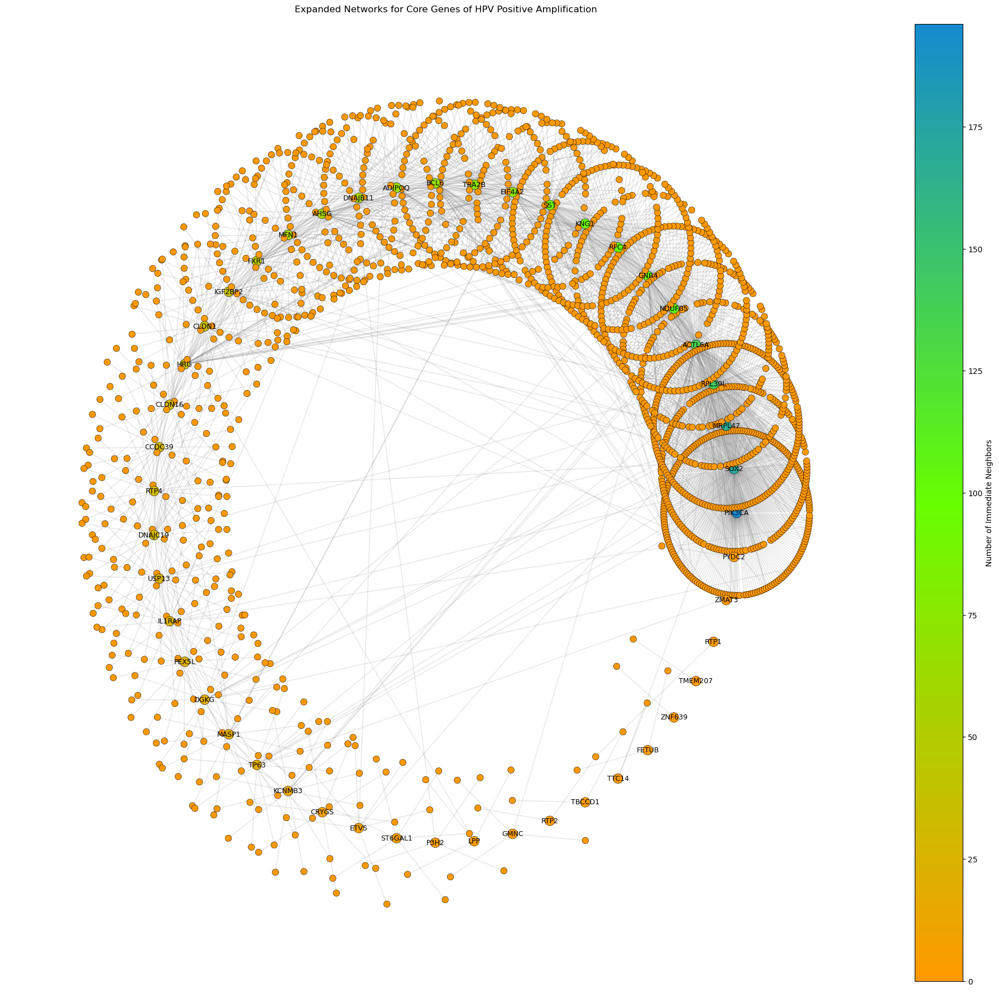

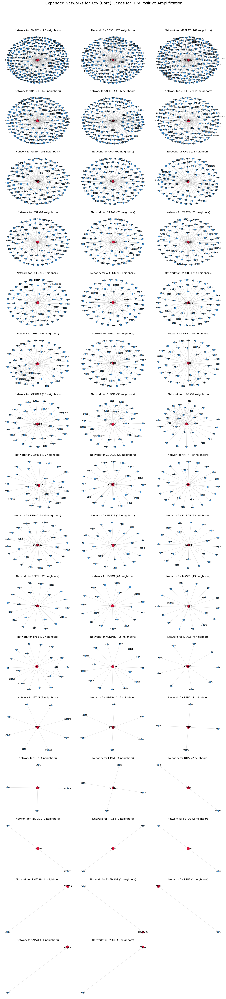

In [39]:
top_genes_and_neighbors_plotting(hpv_positive_amplification_top_genes, section_name='HPV Positive Amplification', top_number=100)

In [40]:
drugs_connected_top_genes_and_neighbors(hpv_positive_amplification_top_genes)

Number of risk genes identified from CNV analysis: 169
Number of risk genes available in the DrugBank database: 8
Number of drugs these risk genes are connected to in the DrugBank database: 24
Number of risk genes identified from CNV analysis: 169
Number of risk genes available in the PPI database: 47
Total number of immediate neighbors found through PPI: 1874
Total number of genes both risk genes and immediate neighbors in the protein interaction database: 1907
These are the top gene candidates along with the genes found to be immediate neighbors through the STRING protein interaction database.
Number of drugs these immediate neighbor genes are connected to in the DrugBank database: 3058
Total number of unique genes both risk genes and immediate neighbors in the protein interaction database: 1907
Number of drugs these genes are connected to in the DrugBank database: 3058


In [41]:
len(set(Drug_bank['drug']))

9368

In [42]:
len(set(drugbank_df['gene'].values))

4187

In [43]:
hpv_positive_amplification_top_genes

,gene,gene_name,Sample_size,amplification_count,Amplification_sum (i.e. total log2(amplification CNV) across samples),Amplification_sum_prevalence,frequency_percentage,gistic_score,p_value,q_value,significant,empirical_p_value,empirical_q_value,empirical_significant,chromosome,start,end,length,coverage_percentage
0,ENSG00000242512.9,LINC01206,221,77,202.286944,0.915326,34.841629,0.318914,2.844552e-43,2.463504e-39,True,0.000999,0.011719,True,chr3,181952343,182035644,83302,0.042009
1,ENSG00000213155.4,AC007547.1,221,77,202.286944,0.915326,34.841629,0.318914,2.844552e-43,2.463504e-39,True,0.000999,0.011719,True,chr3,181866351,181867154,804,0.000405
2,ENSG00000239805.1,AC007547.2,221,77,202.286944,0.915326,34.841629,0.318914,2.844552e-43,2.463504e-39,True,0.000999,0.011719,True,chr3,181847526,181847885,360,0.000182
3,ENSG00000240478.1,AC012081.1,221,77,202.286944,0.915326,34.841629,0.318914,2.844552e-43,2.463504e-39,True,0.000999,0.011719,True,chr3,182121884,182142137,20254,0.010214
4,ENSG00000199839.1,RNA5SP150,221,77,202.286944,0.915326,34.841629,0.318914,2.844552e-43,2.463504e-39,True,0.000999,0.011719,True,chr3,181822872,181822990,119,0.000060
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
167,ENSG00000236412.1,AC092941.2,221,73,199.747422,0.903834,33.031674,0.298552,2.637646e-39,8.834366e-37,True,0.000999,0.011719,True,chr3,188001700,188003406,1707,0.000861
168,ENSG00000225058.1,AC092941.1,221,73,199.747422,0.903834,33.031674,0.298552,2.637646e-39,8.834366e-37,True,0.000999,0.011719,True,chr3,187997422,188003990,6569,0.003313
169,ENSG00000236864.1,AC068295.1,221,73,199.747422,0.903834,33.031674,0.298552,2.637646e-39,8.834366e-37,True,0.000999,0.011719,True,chr3,187932764,187946221,13458,0.006787
170,ENSG00000270959.1,LPP-AS2,221,73,199.969814,0.904841,33.031674,0.298884,2.637646e-39,8.834366e-37,True,0.000999,0.011719,True,chr3,188151206,188154057,2852,0.001438


In [44]:
'SOX2' in hpv_positive_amplification_top_genes['gene']

False

In [45]:
### calculate significant drug candidates using significance function
hpv_positive_amp_signficant_drug_candidates = identify_significant_drug_candidates(hpv_positive_amplification_top_genes)
top_hpv_postiive_amp_significant_drug_candidates = hpv_positive_amp_signficant_drug_candidates[hpv_positive_amp_signficant_drug_candidates['empirical_fdr'] < 0.05].copy()
top_hpv_postiive_amp_significant_drug_candidates = top_hpv_postiive_amp_significant_drug_candidates[top_hpv_postiive_amp_significant_drug_candidates['hypergeom_fdr'] < 0.05]
print(f"Number of significant drug candidates identified: {top_hpv_postiive_amp_significant_drug_candidates.shape[0]}")

Total number of genes both risk genes and immediate neighbors in the protein interaction database: 1907
Total number of top genes identified as risk genes from CNV analysis: 169
Number of risk genes available in the PPI database: 47
Total number of immediate neighbors found through PPI: 1874
These are the top gene candidates along with the genes found to be immediate neighbors through the STRING protein interaction database.
---- Risk genes stats ----
Total number of risk genes identified from CNV analysis: 169
Of which 8 are found in DrugBank.
these connect to 24 unique drugs in DrugBank.
---- Neighboors stats ----
Total number of risk genes identified in DrugBank after connecting to PPI: 627
These are connected to 3077 unique drugs in DrugBank.
Of which 21 are HNC approved medications.
---- Altogether stats (risk genes + immediate neighbors) ----
Of which 627 are found in DrugBank.
these connect to 3077 unique drugs in DrugBank.


Running permutations for empirical p-values: 100%|██████████| 100000/100000 [03:28<00:00, 480.74it/s]



Universe size M=4150, risk set size n=627, drugs tested=9368
Permutation-significant (empirical FDR < 0.05): 143

Number of significant drug candidates identified: 143


In [46]:
drugbank_df[drugbank_df['drug']=='Fostamatinib']

,drug,gene,action,specific_function
19279,Fostamatinib,SYK,inhibitor,ATP binding
19280,Fostamatinib,ADORA3,antagonist,G protein-coupled adenosine receptor activity
19281,Fostamatinib,SLC18A2,inhibitor,monoamine transmembrane transporter activity
19282,Fostamatinib,FAAH,inhibitor,amidase activity
19283,Fostamatinib,SLC29A1,inhibitor,adenine transmembrane transporter activity
...,...,...,...,...
19574,Fostamatinib,STK10,inhibitor,ATP binding
19575,Fostamatinib,STK16,inhibitor,ATP binding
19576,Fostamatinib,STK17A,inhibitor,ATP binding
19577,Fostamatinib,STK17B,inhibitor,ATP binding


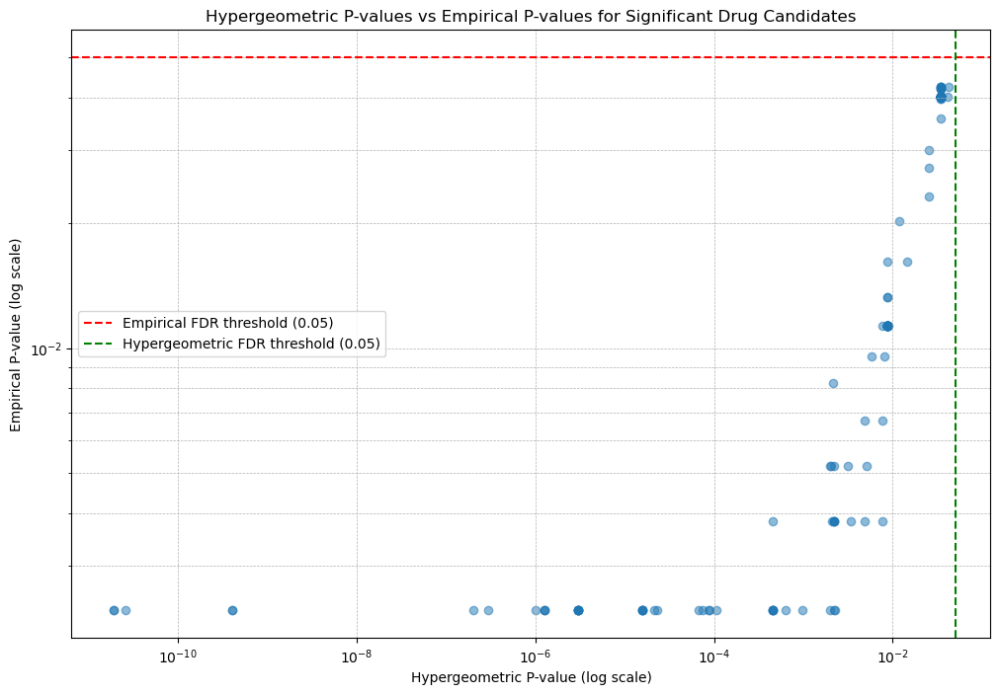

In [47]:
### plot hypergeometric p-values for significant drugs vs empirical_fdr for top_hpv_postiive_amp_significant_drug_candidates
plt.figure(figsize=(12, 8))
plt.scatter(top_hpv_postiive_amp_significant_drug_candidates['hypergeom_fdr'], top_hpv_postiive_amp_significant_drug_candidates['empirical_fdr'], alpha=0.5)
plt.xscale('log')
plt.yscale('log')
plt.title('Hypergeometric P-values vs Empirical P-values for Significant Drug Candidates')
plt.xlabel('Hypergeometric P-value (log scale)')
plt.ylabel('Empirical P-value (log scale)')
plt.axhline(y=0.05, color='r', linestyle='--', label='Empirical FDR threshold (0.05)')
plt.axvline(x=0.05, color='g', linestyle='--', label='Hypergeometric FDR threshold (0.05)')
plt.legend()
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.show()

In [48]:
top_hpv_postiive_amp_significant_drug_candidates

,drug,targets_in_drugbank,overlap_with_my_genes,a_inRisk_inDrug,b_notRisk_inDrug,c_inRisk_notDrug,d_notRisk_notDrug,expected_overlap,fold_enrichment,hypergeom_p_value,hypergeom_fdr,empirical_p_value,empirical_fdr,baseline_prob_ge2,proportion_of_targets_in_risk_set
0,NADH,144,47,47,97,580,3426,21.756145,2.160309,6.205177e-08,2.325204e-05,0.00001,0.002342,1.00000,0.326389
1,Sorafenib,11,11,11,0,616,3523,1.661928,6.618820,8.686883e-10,1.017234e-06,0.00001,0.002342,0.51088,1.000000
2,Sunitinib,9,9,9,0,618,3523,1.359759,6.618820,3.905673e-08,1.590798e-05,0.00001,0.002342,0.40649,1.000000
3,Zinc,124,52,52,72,575,3451,18.734458,2.775634,2.168867e-13,4.063589e-10,0.00001,0.002342,1.00000,0.419355
4,(S)-3-phenyllactic acid,15,12,12,3,615,3520,2.266265,5.295056,3.779703e-08,1.590798e-05,0.00001,0.002342,0.68522,0.800000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
138,KC706,4,4,4,0,623,3523,0.604337,6.618820,5.168234e-04,3.433760e-02,0.00063,0.042459,0.11001,1.000000
139,Purvalanol,9,6,6,3,621,3520,1.359759,4.412547,6.489066e-04,4.251019e-02,0.00065,0.042581,0.40442,0.666667
140,Vatalanib,4,4,4,0,623,3523,0.604337,6.618820,5.168234e-04,3.433760e-02,0.00065,0.042581,0.11116,1.000000
141,Pardoprunox,4,4,4,0,623,3523,0.604337,6.618820,5.168234e-04,3.433760e-02,0.00065,0.042581,0.11188,1.000000


In [49]:
top_hpv_postiive_amp_significant_drug_candidates.sort_values(by=['overlap_with_my_genes','empirical_fdr', 'hypergeom_fdr'], ascending=[False, True, True]).head(25)

,drug,targets_in_drugbank,overlap_with_my_genes,a_inRisk_inDrug,b_notRisk_inDrug,c_inRisk_notDrug,d_notRisk_notDrug,expected_overlap,fold_enrichment,hypergeom_p_value,hypergeom_fdr,empirical_p_value,empirical_fdr,baseline_prob_ge2,proportion_of_targets_in_risk_set
31,Fostamatinib,299,74,74,225,553,3298,45.174217,1.638103,3.947926e-06,9.732677e-04,0.00001,0.002342,1.00000,0.247492
24,Copper,146,60,60,86,567,3437,22.058313,2.720063,8.218045e-15,2.566222e-11,0.00001,0.002342,1.00000,0.410959
3,Zinc,124,52,52,72,575,3451,18.734458,2.775634,2.168867e-13,4.063589e-10,0.00001,0.002342,1.00000,0.419355
35,Zinc acetate,124,52,52,72,575,3451,18.734458,2.775634,2.168867e-13,4.063589e-10,0.00001,0.002342,1.00000,0.419355
36,Zinc chloride,97,47,47,50,580,3473,14.655181,3.207057,4.050306e-15,1.897163e-11,0.00001,0.002342,1.00000,0.484536
37,"Zinc sulfate, unspecified form",97,47,47,50,580,3473,14.655181,3.207057,4.050306e-15,1.897163e-11,0.00001,0.002342,1.00000,0.484536
0,NADH,144,47,47,97,580,3426,21.756145,2.160309,6.205177e-08,2.325204e-05,0.00001,0.002342,1.00000,0.326389
27,Artenimol,105,37,37,68,590,3455,15.863855,2.332346,1.874270e-07,6.753139e-05,0.00001,0.002342,1.00000,0.352381
57,Aripiprazole,38,16,16,22,611,3501,5.741205,2.786871,5.234628e-05,8.172999e-03,0.00006,0.009527,0.98463,0.421053
87,N-Formylmethionine,40,16,16,24,611,3499,6.043373,2.647528,1.100034e-04,1.184497e-02,0.00019,0.020226,0.98877,0.400000


Total number of genes in the direct drug gene interaction database: 169
These are the top gene candidates identified from CNV analysis, which will be connected to drugs in the DrugBank database.


Processing top direct genes: 100%|██████████| 169/169 [00:00<00:00, 3214.46it/s]
check for approved medications: 17it [00:00, 37947.40it/s]

Number of unique drugs in the final database: 10
Number of unique genes in the final database: 5
Number of approved drugs in the final database: 0


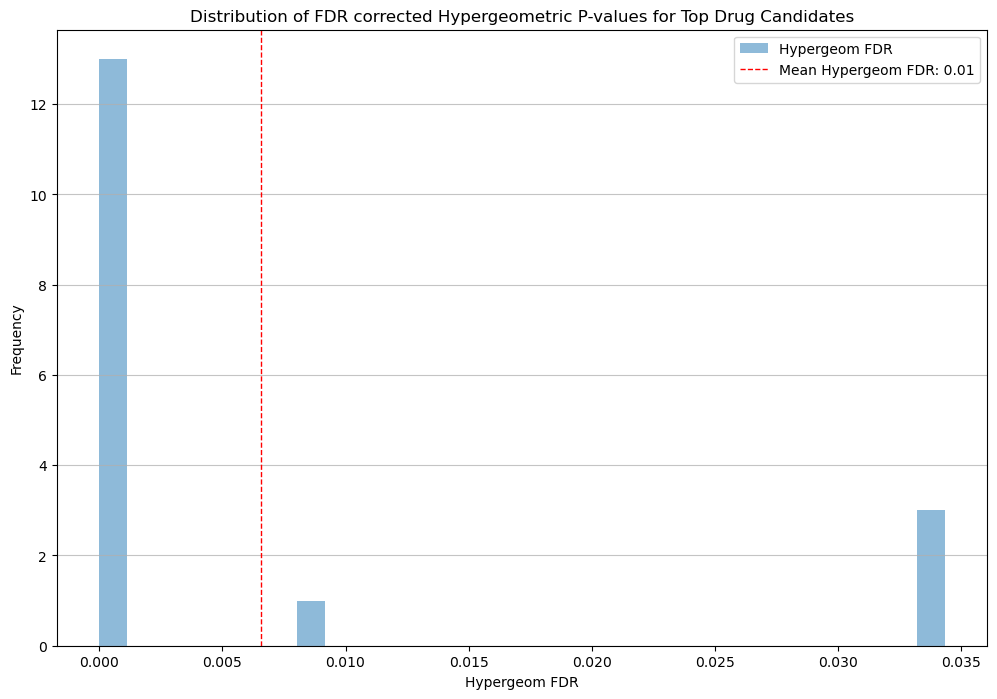

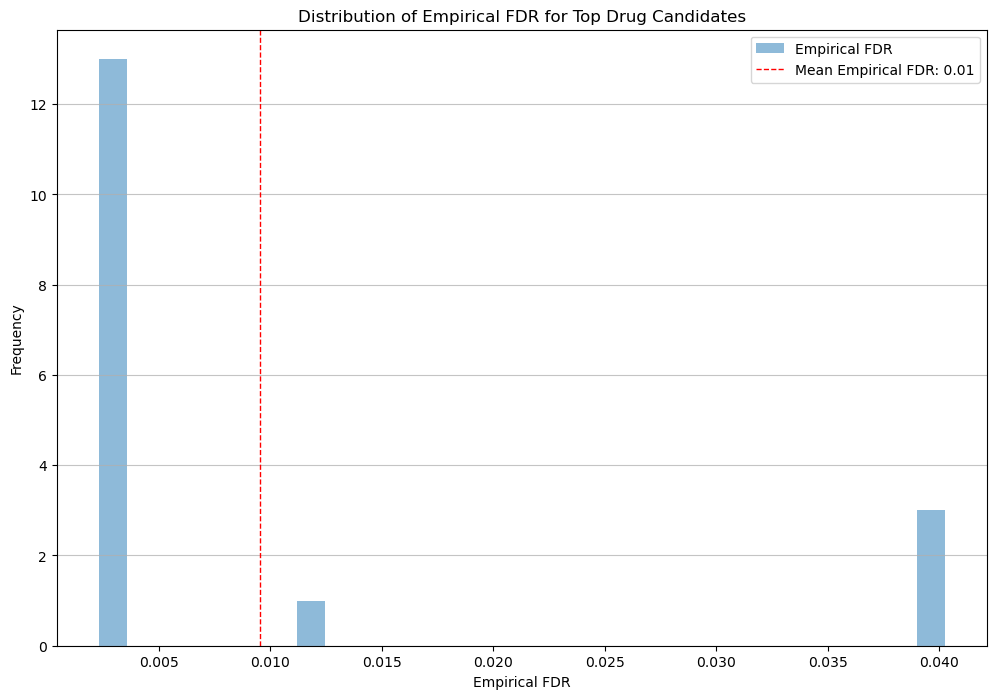

In [50]:
hpv_pos_amp_top_direct_drug_candidates = top_direct_drug_candidates(hpv_positive_amplification_top_genes, hpv_positive_amp_signficant_drug_candidates, plotting=True)

In [51]:
hpv_pos_amp_top_direct_drug_candidates[~hpv_pos_amp_top_direct_drug_candidates['ACTION'].isnull()].sort_values(by=['drug_hypergeom_fdr', 'drug_empirical_fdr'], ascending=[True, True]).reset_index(drop=True)

,GENE_TARGET,CONNECTED_TO,PPI_SCORE,DRUG,GENE_GISTIC,GENE_normalized_gistic_score,GENE_frequency_percentage,GENE_SIGNIFICANT,ACTION,SPECIFIC_FUNCTION,drug_hypergeom_p_value,drug_hypergeom_fdr,drug_empirical_p_value,drug_empirical_fdr,HNC_approved_medication
0,HRG,NA,0,Zinc chloride,0.302421,0.242965,33.484163,True,cofactor,cysteine-type endopeptidase inhibitor activity,4.050306e-15,1.897163e-11,0.00001,0.002342,False
1,HRG,NA,0,"Zinc sulfate, unspecified form",0.302421,0.242965,33.484163,True,cofactor,cysteine-type endopeptidase inhibitor activity,4.050306e-15,1.897163e-11,0.00001,0.002342,False
2,KNG1,NA,0,Zinc chloride,0.302421,0.242965,33.484163,True,cofactor,cysteine-type endopeptidase inhibitor activity,4.050306e-15,1.897163e-11,0.00001,0.002342,False
3,KNG1,NA,0,"Zinc sulfate, unspecified form",0.302421,0.242965,33.484163,True,cofactor,cysteine-type endopeptidase inhibitor activity,4.050306e-15,1.897163e-11,0.00001,0.002342,False
4,AHSG,NA,0,Zinc chloride,0.302421,0.242965,33.484163,True,chelator,cysteine-type endopeptidase inhibitor activity,4.050306e-15,1.897163e-11,0.00001,0.002342,False
5,AHSG,NA,0,"Zinc sulfate, unspecified form",0.302421,0.242965,33.484163,True,chelator,cysteine-type endopeptidase inhibitor activity,4.050306e-15,1.897163e-11,0.00001,0.002342,False
6,PIK3CA,NA,0,Buparlisib,0.302482,0.245792,33.484163,True,inhibitor,1-phosphatidylinositol-3-kinase activity,5.168234e-04,3.433760e-02,0.00057,0.040247,False
7,PIK3CA,NA,0,Copanlisib,0.302482,0.245792,33.484163,True,inhibitor,1-phosphatidylinositol-3-kinase activity,5.168234e-04,3.433760e-02,0.00057,0.040247,False
8,PIK3CA,NA,0,CH-5132799,0.302482,0.245792,33.484163,True,inhibitor,1-phosphatidylinositol-3-kinase activity,5.168234e-04,3.433760e-02,0.00057,0.040247,False


In [52]:
hpv_pos_amp_top_direct_agg = agg_top_direct_drug_candidates(hpv_pos_amp_top_direct_drug_candidates)

In [53]:
hpv_pos_amp_top_direct_agg

,DRUG,NUM_DIRECT_TARGETS_HIT,TOTAL_TARGETS_IN_DRUGBANK,PERCENTAGE_OF_TARGETS_HIT,GENE_TARGET,GENE_GISTIC,GENE_normalized_gistic_score,ACTION,SPECIFIC_FUNCTION,drug_hypergeom_p_value,drug_hypergeom_fdr,drug_empirical_p_value,drug_empirical_fdr
12,Buparlisib,1,4,25.000000,PIK3CA,0.302482,0.245792,inhibitor,1-phosphatidylinositol-3-kinase activity,5.168234e-04,3.433760e-02,0.00057,0.040247
13,Copanlisib,1,4,25.000000,PIK3CA,0.302482,0.245792,inhibitor,1-phosphatidylinositol-3-kinase activity,5.168234e-04,3.433760e-02,0.00057,0.040247
14,CH-5132799,1,4,25.000000,PIK3CA,0.302482,0.245792,inhibitor,1-phosphatidylinositol-3-kinase activity,5.168234e-04,3.433760e-02,0.00057,0.040247
15,XL765,1,5,20.000000,PIK3CA,0.302482,0.245792,NaN,1-phosphatidylinositol-3-kinase activity,7.766063e-05,8.661009e-03,0.00009,0.011287
0,Zinc chloride,3,97,3.092784,HRG,0.302421,0.242965,cofactor,cysteine-type endopeptidase inhibitor activity,4.050306e-15,1.897163e-11,0.00001,0.002342
1,"Zinc sulfate, unspecified form",3,97,3.092784,HRG,0.302421,0.242965,cofactor,cysteine-type endopeptidase inhibitor activity,4.050306e-15,1.897163e-11,0.00001,0.002342
2,Zinc chloride,3,97,3.092784,KNG1,0.302421,0.242965,cofactor,cysteine-type endopeptidase inhibitor activity,4.050306e-15,1.897163e-11,0.00001,0.002342
3,"Zinc sulfate, unspecified form",3,97,3.092784,KNG1,0.302421,0.242965,cofactor,cysteine-type endopeptidase inhibitor activity,4.050306e-15,1.897163e-11,0.00001,0.002342
4,Zinc chloride,3,97,3.092784,AHSG,0.302421,0.242965,chelator,cysteine-type endopeptidase inhibitor activity,4.050306e-15,1.897163e-11,0.00001,0.002342
5,"Zinc sulfate, unspecified form",3,97,3.092784,AHSG,0.302421,0.242965,chelator,cysteine-type endopeptidase inhibitor activity,4.050306e-15,1.897163e-11,0.00001,0.002342


Total number of genes both risk genes and immediate neighbors in the protein interaction database: 1907
Total number of top genes identified as risk genes from CNV analysis: 169
Number of risk genes available in the PPI database: 47
Total number of immediate neighbors found through PPI: 1874
These are the top gene candidates along with the genes found to be immediate neighbors through the STRING protein interaction database.


Processing connected genes: 2208it [00:03, 569.13it/s] 
check for approved medications: 1857it [00:00, 63113.38it/s]

Number of unique genes in indirect hits: 352
Number of unique drugs in indirect hits: 143
Number of approved medications identified: 0


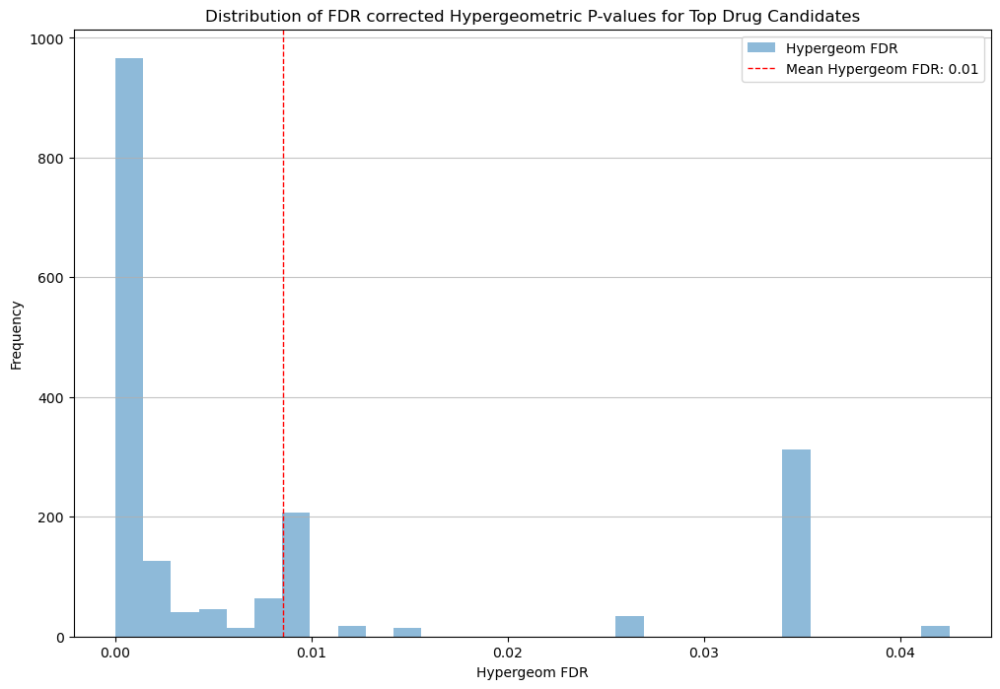

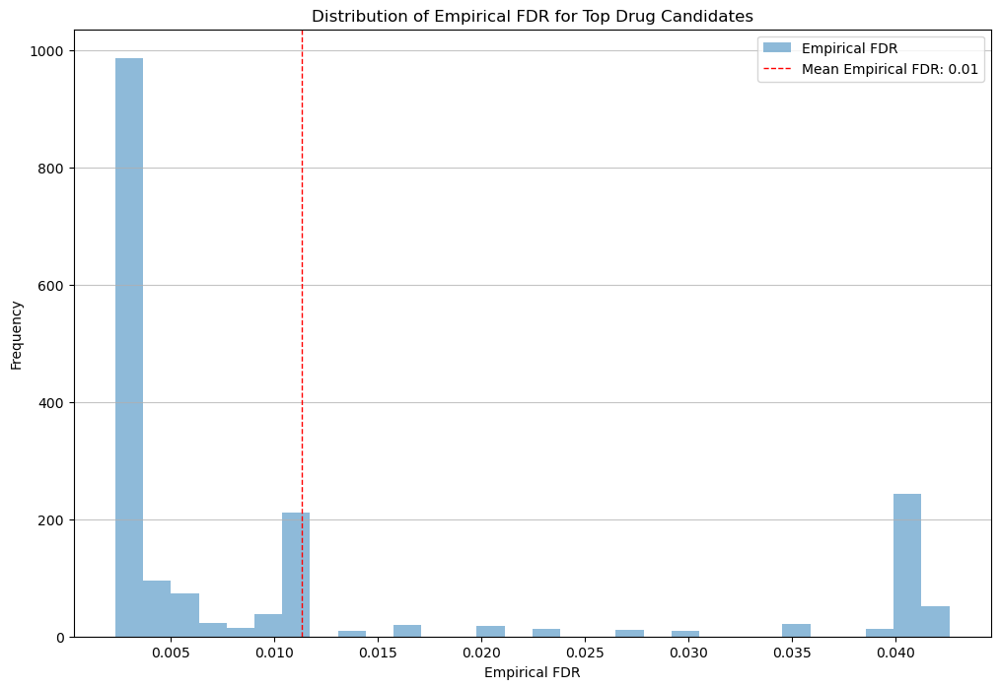

In [54]:
hpv_pos_amp_top_indirect_drug_candidates = top_indirect_drug_candidates(hpv_positive_amplification_top_genes, hpv_positive_amp_signficant_drug_candidates, plotting=True)

In [55]:
hpv_pos_amp_top_indirect_drug_candidates_agg = agg_top_indirect_drug_candidates(hpv_pos_amp_top_indirect_drug_candidates)

/var/folders/5p/swntgnbj3fbfxkx02kt3fq980000gn/T/ipykernel_51208/318329654.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_indirect_drug_candidates['num_genes_targeted'] = top_indirect_drug_candidates.groupby('DRUG')['GENE_TARGET'].transform('nunique')


In [56]:
# import pandas as pd
# import networkx as nx
# import matplotlib.pyplot as plt
# import numpy as np

# df = hpv_pos_amp_top_indirect_drug_candidates.sort_values(by=['drug_hypergeom_fdr', 'drug_empirical_fdr'], ascending=[True, True]).reset_index(drop=True).head(200)

# # Build bipartite graph
# B = nx.Graph()
# B.add_nodes_from(df["GENE_TARGET"].unique(), bipartite=0)
# B.add_nodes_from(df["DRUG"].unique(), bipartite=1)
# B.add_edges_from([(row["DRUG"], row["GENE_TARGET"]) for _, row in df.iterrows()])

# genes = sorted(df["GENE_TARGET"].unique())
# drugs = sorted(df["DRUG"].unique())

# # Central position for gene circle
# center = (0, 0)
# n_genes = len(genes)
# n_drugs = len(drugs)

# # Gene positions: small circle at center
# gene_radius = 2
# gene_angles = np.linspace(0, 2 * np.pi, n_genes, endpoint=False)
# pos = {}
# for i, gene in enumerate(genes):
#     pos[gene] = (center[0] + gene_radius * np.cos(gene_angles[i]),
#                  center[1] + gene_radius * np.sin(gene_angles[i]))

# # Drug positions: large outer circle
# drug_radius = 9
# drug_angles = np.linspace(0, 2 * np.pi, n_drugs, endpoint=False)
# for i, drug in enumerate(drugs):
#     pos[drug] = (center[0] + drug_radius * np.cos(drug_angles[i]),
#                  center[1] + drug_radius * np.sin(drug_angles[i]))

# plt.figure(figsize=(12, 12))

# nx.draw_networkx_edges(B, pos, alpha=0.20, width=0.7)

# # Draw gene nodes (center)
# nx.draw_networkx_nodes(B, pos, nodelist=genes,
#                       node_color="#3E8ED0", node_size=160, node_shape='o', label="Genes")

# # Draw drug nodes (outer halo)
# nx.draw_networkx_nodes(B, pos, nodelist=drugs,
#                       node_color="#6CBF6C", node_size=190, node_shape='s', label="Drugs")

# # Add gene labels inside circle for clarity
# nx.draw_networkx_labels(B, pos, labels={n: n for n in genes},
#                        font_size=8, font_color="black", verticalalignment="center")

# # Drug labels, around outer edge, rotate for readability
# label_pos = {}
# for i, drug in enumerate(drugs):
#     # Place label a bit further out from node
#     angle = drug_angles[i]
#     label_pos[drug] = (center[0] + (drug_radius + 1.5) * np.cos(angle),
#                        center[1] + (drug_radius + 1.5) * np.sin(angle))

# nx.draw_networkx_labels(B, label_pos, labels={n: n for n in drugs},
#                        font_size=8, font_color="gray", verticalalignment="center")

# plt.legend(loc='best', fontsize=7)
# plt.title("Circular Drug–Gene Target Network (Figure 6b-style)")
# plt.axis("off")
# plt.tight_layout()
# plt.show()


In [57]:
hpv_pos_amp_top_indirect_drug_candidates_agg.head(50)

,DRUG,CONNECTED_TO (risk gene),Number of risk or immediate neighbor genes targeted,total_genes_targeted_in_drugbank,PERCENTAGE_OF_TARGETS_HIT,Number of indirect genes connected to this risk gene,GENE_TARGET,GENE_GISTIC,GENE_normalized_gistic_score,GENE_frequency_percentage,ACTION,SPECIFIC_FUNCTION,drug_hypergeom_fdr,drug_empirical_fdr
247,somatostatin,SST,7,7,100.000000,5,"SSTR4, SSTR3, SSTR5, SSTR1, SSTR2",0.314289,0.787707,34.389140,agonist,"neuropeptide binding, G protein-coupled recept...",4.544467e-04,0.002342
283,trihexyphenidyl,SST,6,6,100.000000,1,CHRM1,0.314289,0.787707,34.389140,antagonist,G protein-coupled acetylcholine receptor activity,2.228012e-03,0.005204
14,aceclidine,SST,5,5,100.000000,1,CHRM1,0.314289,0.787707,34.389140,inhibitor,G protein-coupled acetylcholine receptor activity,8.661009e-03,0.011287
17,aclidinium,SST,5,5,100.000000,1,CHRM1,0.314289,0.787707,34.389140,antagonist,G protein-coupled acetylcholine receptor activity,8.661009e-03,0.011287
56,bethanechol,SST,5,5,100.000000,1,CHRM1,0.314289,0.787707,34.389140,agonist,G protein-coupled acetylcholine receptor activity,8.661009e-03,0.011287
94,darifenacin,SST,5,5,100.000000,1,CHRM1,0.314289,0.787707,34.389140,antagonist,G protein-coupled acetylcholine receptor activity,8.661009e-03,0.011287
117,fesoterodine,SST,5,5,100.000000,1,CHRM1,0.314289,0.787707,34.389140,antagonist,G protein-coupled acetylcholine receptor activity,8.661009e-03,0.011287
136,glycopyrronium,SST,5,5,100.000000,1,CHRM1,0.314289,0.787707,34.389140,antagonist,G protein-coupled acetylcholine receptor activity,8.661009e-03,0.011287
146,homatropine,SST,5,5,100.000000,1,CHRM1,0.314289,0.787707,34.389140,antagonist,G protein-coupled acetylcholine receptor activity,8.661009e-03,0.011287
149,homatropine methylbromide,SST,5,5,100.000000,1,CHRM1,0.314289,0.787707,34.389140,antagonist,G protein-coupled acetylcholine receptor activity,8.661009e-03,0.011287


In [58]:
'SOX2' in hpv_pos_amp_top_indirect_drug_candidates_agg['CONNECTED_TO (risk gene)'].to_list()

True

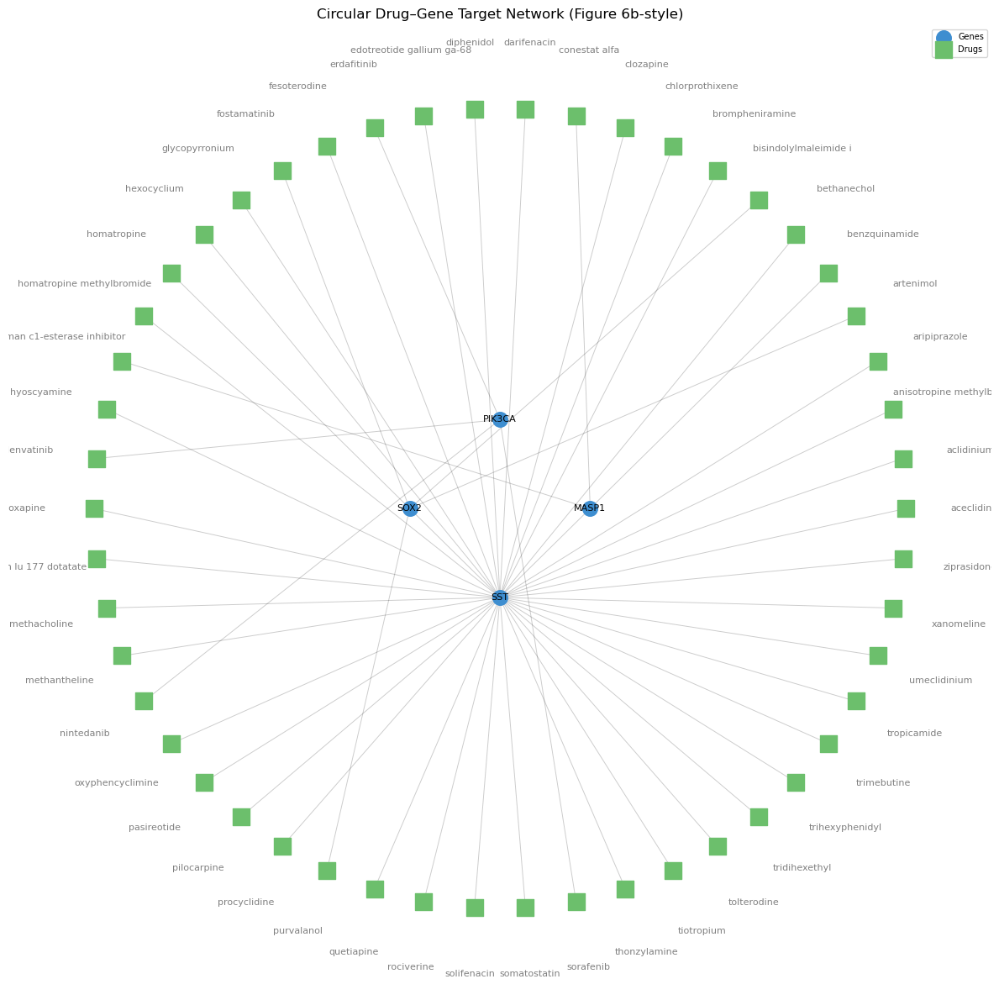

In [59]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np

df = hpv_pos_amp_top_indirect_drug_candidates_agg.head(50)

# Build bipartite graph
B = nx.Graph()
B.add_nodes_from(df["CONNECTED_TO (risk gene)"].unique(), bipartite=0)
B.add_nodes_from(df["DRUG"].unique(), bipartite=1)
B.add_edges_from([(row["DRUG"], row["CONNECTED_TO (risk gene)"]) for _, row in df.iterrows()])

genes = sorted(df["CONNECTED_TO (risk gene)"].unique())
drugs = sorted(df["DRUG"].unique())

# Central position for gene circle
center = (0, 0)
n_genes = len(genes)
n_drugs = len(drugs)

# Gene positions: small circle at center
gene_radius = 2
gene_angles = np.linspace(0, 2 * np.pi, n_genes, endpoint=False)
pos = {}
for i, gene in enumerate(genes):
    pos[gene] = (center[0] + gene_radius * np.cos(gene_angles[i]),
                 center[1] + gene_radius * np.sin(gene_angles[i]))

# Drug positions: large outer circle
drug_radius = 9
drug_angles = np.linspace(0, 2 * np.pi, n_drugs, endpoint=False)
for i, drug in enumerate(drugs):
    pos[drug] = (center[0] + drug_radius * np.cos(drug_angles[i]),
                 center[1] + drug_radius * np.sin(drug_angles[i]))

plt.figure(figsize=(12, 12))

nx.draw_networkx_edges(B, pos, alpha=0.20, width=0.7)

# Draw gene nodes (center)
nx.draw_networkx_nodes(B, pos, nodelist=genes,
                      node_color="#3E8ED0", node_size=160, node_shape='o', label="Genes")

# Draw drug nodes (outer halo)
nx.draw_networkx_nodes(B, pos, nodelist=drugs,
                      node_color="#6CBF6C", node_size=190, node_shape='s', label="Drugs")

# Add gene labels inside circle for clarity
nx.draw_networkx_labels(B, pos, labels={n: n for n in genes},
                       font_size=8, font_color="black", verticalalignment="center")

# Drug labels, around outer edge, rotate for readability
label_pos = {}
for i, drug in enumerate(drugs):
    # Place label a bit further out from node
    angle = drug_angles[i]
    label_pos[drug] = (center[0] + (drug_radius + 1.5) * np.cos(angle),
                       center[1] + (drug_radius + 1.5) * np.sin(angle))

nx.draw_networkx_labels(B, label_pos, labels={n: n for n in drugs},
                       font_size=8, font_color="gray", verticalalignment="center")

plt.legend(loc='best', fontsize=7)
plt.title("Circular Drug–Gene Target Network (Figure 6b-style)")
plt.axis("off")
plt.tight_layout()
plt.show()


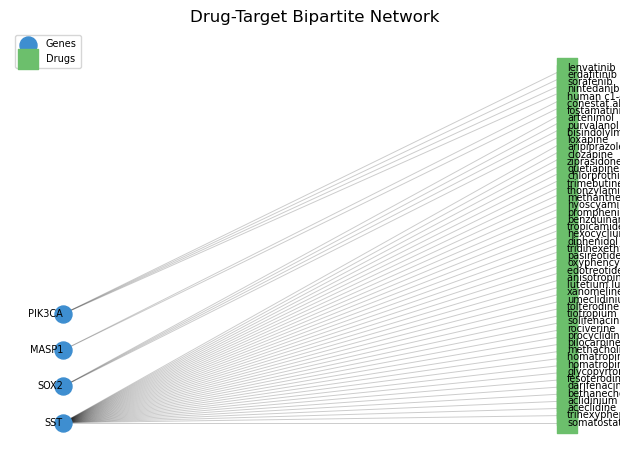

In [60]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np

df = hpv_pos_amp_top_indirect_drug_candidates_agg.head(50)

# Rebuild the bipartite graph as before
B = nx.Graph()
B.add_nodes_from(df["CONNECTED_TO (risk gene)"].unique(), bipartite=0)
B.add_nodes_from(df["DRUG"].unique(), bipartite=1)
B.add_edges_from([(row["DRUG"], row["CONNECTED_TO (risk gene)"]) for _, row in df.iterrows()])

# Separate lists for each node type
genes = list(df["CONNECTED_TO (risk gene)"].unique())
drugs = list(df["DRUG"].unique())

# Set up "ladder layout": stretch y-axis, place genes at left, drugs at right
gene_x = 0
drug_x = 20  # Increase to spread columns further apart
vertical_gap_drug = 2          # Increase to spread nodes vertically
vertical_gap_gene = 10         # Increase to spread nodes vertically

# Custom horizontal bipartite layout: genes on left, drugs on right
pos = {}
# Place genes evenly along a vertical line
for i, gene in enumerate(genes):
    pos[gene] = (0, i * vertical_gap_gene)
# Place drugs evenly along a parallel vertical line
for i, drug in enumerate(drugs):
    pos[drug] = (10, i * vertical_gap_drug)  # 10 units to the right, adjust as needed

# Draw edges
nx.draw_networkx_edges(B, pos, alpha=0.2, width=0.7)

# Draw gene nodes (left side)
nx.draw_networkx_nodes(B, pos, nodelist=genes,
                      node_color="#3E8ED0", node_size=150, node_shape='o', label="Genes")
# Draw drug nodes (right side)
nx.draw_networkx_nodes(B, pos, nodelist=drugs,
                      node_color="#6CBF6C", node_size=190, node_shape='s', label="Drugs")

# Add labels with offset to reduce overlap
nx.draw_networkx_labels(B, pos, labels={n: n for n in genes},
                       font_size=7, font_color="black", verticalalignment="center",
                       horizontalalignment="right")
nx.draw_networkx_labels(B, pos, labels={n: n for n in drugs},
                       font_size=7, font_color="black", verticalalignment="center",
                       horizontalalignment="left")

plt.legend(loc='best', fontsize=7)
plt.title("Drug-Target Bipartite Network")
plt.axis("off")
plt.tight_layout()
plt.show()


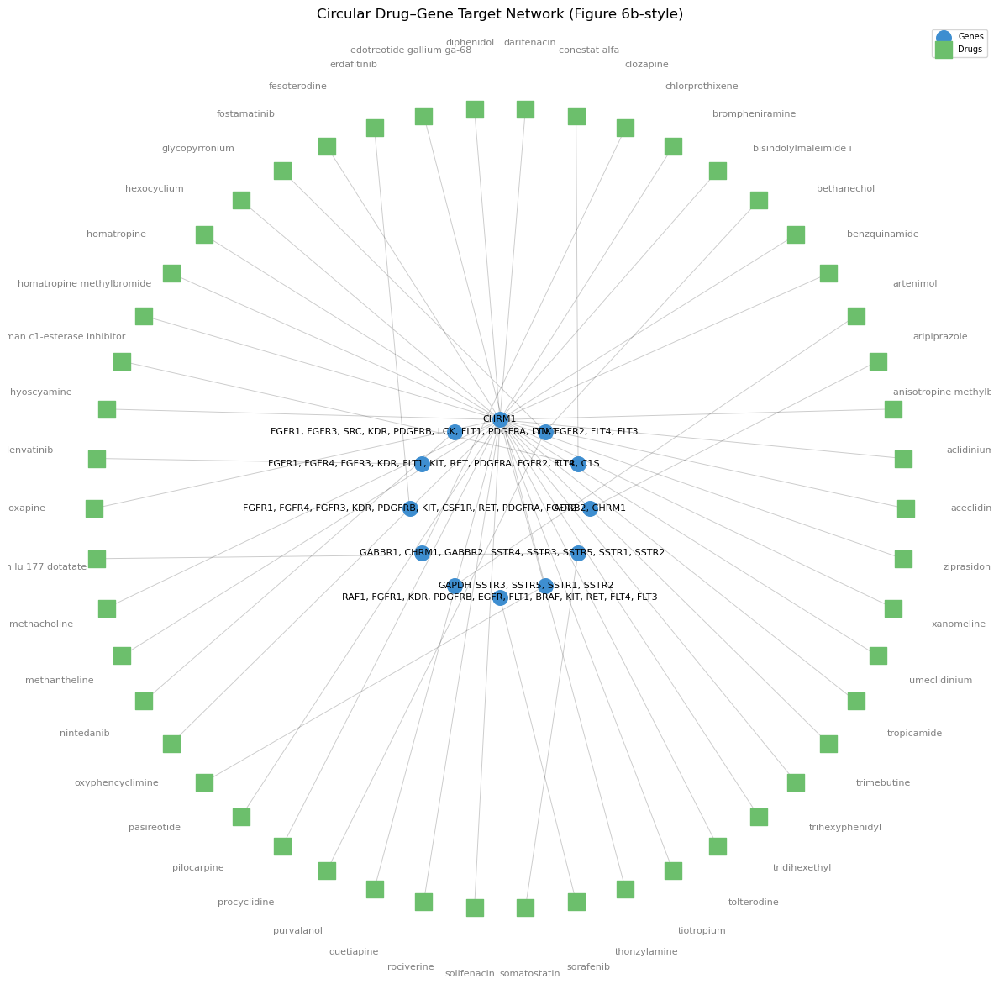

In [61]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np

df = hpv_pos_amp_top_indirect_drug_candidates_agg.head(50)

# Build bipartite graph
B = nx.Graph()
B.add_nodes_from(df["GENE_TARGET"].unique(), bipartite=0)
B.add_nodes_from(df["DRUG"].unique(), bipartite=1)
B.add_edges_from([(row["DRUG"], row["GENE_TARGET"]) for _, row in df.iterrows()])

genes = sorted(df["GENE_TARGET"].unique())
drugs = sorted(df["DRUG"].unique())

# Central position for gene circle
center = (0, 0)
n_genes = len(genes)
n_drugs = len(drugs)

# Gene positions: small circle at center
gene_radius = 2
gene_angles = np.linspace(0, 2 * np.pi, n_genes, endpoint=False)
pos = {}
for i, gene in enumerate(genes):
    pos[gene] = (center[0] + gene_radius * np.cos(gene_angles[i]),
                 center[1] + gene_radius * np.sin(gene_angles[i]))

# Drug positions: large outer circle
drug_radius = 9
drug_angles = np.linspace(0, 2 * np.pi, n_drugs, endpoint=False)
for i, drug in enumerate(drugs):
    pos[drug] = (center[0] + drug_radius * np.cos(drug_angles[i]),
                 center[1] + drug_radius * np.sin(drug_angles[i]))

plt.figure(figsize=(12, 12))

nx.draw_networkx_edges(B, pos, alpha=0.20, width=0.7)

# Draw gene nodes (center)
nx.draw_networkx_nodes(B, pos, nodelist=genes,
                      node_color="#3E8ED0", node_size=160, node_shape='o', label="Genes")

# Draw drug nodes (outer halo)
nx.draw_networkx_nodes(B, pos, nodelist=drugs,
                      node_color="#6CBF6C", node_size=190, node_shape='s', label="Drugs")

# Add gene labels inside circle for clarity
nx.draw_networkx_labels(B, pos, labels={n: n for n in genes},
                       font_size=8, font_color="black", verticalalignment="center")

# Drug labels, around outer edge, rotate for readability
label_pos = {}
for i, drug in enumerate(drugs):
    # Place label a bit further out from node
    angle = drug_angles[i]
    label_pos[drug] = (center[0] + (drug_radius + 1.5) * np.cos(angle),
                       center[1] + (drug_radius + 1.5) * np.sin(angle))

nx.draw_networkx_labels(B, label_pos, labels={n: n for n in drugs},
                       font_size=8, font_color="gray", verticalalignment="center")

plt.legend(loc='best', fontsize=7)
plt.title("Circular Drug–Gene Target Network (Figure 6b-style)")
plt.axis("off")
plt.tight_layout()
plt.show()


In [62]:
### how many of the significant drug candidates are already known to be used in HNC?
top_hpv_positive_amp_signficant_drug_candidates = hpv_positive_amp_signficant_drug_candidates[hpv_positive_amp_signficant_drug_candidates['empirical_fdr'] < 0.05].copy()  # filter for significant drugs based on empirical FDR
top_hpv_positive_amp_signficant_drug_candidates = top_hpv_positive_amp_signficant_drug_candidates[top_hpv_positive_amp_signficant_drug_candidates['hypergeom_fdr'] < 0.05]

known_hnc_medications = set(known_hnc_medications)  # ensure this is a set for faster lookup
top_hpv_positive_amp_signficant_drug_candidates['approved'] = top_hpv_positive_amp_signficant_drug_candidates['drug'].apply(
    lambda x: x.lower() in known_hnc_medications
)
print(f"Number of approved medications identified: {top_hpv_positive_amp_signficant_drug_candidates['approved'].sum()}")

Number of approved medications identified: 0


In [63]:
'Heparin' in top_hpv_positive_amp_signficant_drug_candidates['drug'].values

True

In [64]:
hpv_positive_amp_signficant_drug_candidates[hpv_positive_amp_signficant_drug_candidates['hypergeom_fdr'] < 0.05]

,drug,targets_in_drugbank,overlap_with_my_genes,a_inRisk_inDrug,b_notRisk_inDrug,c_inRisk_notDrug,d_notRisk_notDrug,expected_overlap,fold_enrichment,hypergeom_p_value,hypergeom_fdr,empirical_p_value,empirical_fdr,baseline_prob_ge2,proportion_of_targets_in_risk_set
0,NADH,144,47,47,97,580,3426,21.756145,2.160309,6.205177e-08,2.325204e-05,0.00001,0.002342,1.00000,0.326389
1,Sorafenib,11,11,11,0,616,3523,1.661928,6.618820,8.686883e-10,1.017234e-06,0.00001,0.002342,0.51088,1.000000
2,Sunitinib,9,9,9,0,618,3523,1.359759,6.618820,3.905673e-08,1.590798e-05,0.00001,0.002342,0.40649,1.000000
3,Zinc,124,52,52,72,575,3451,18.734458,2.775634,2.168867e-13,4.063589e-10,0.00001,0.002342,1.00000,0.419355
4,(S)-3-phenyllactic acid,15,12,12,3,615,3520,2.266265,5.295056,3.779703e-08,1.590798e-05,0.00001,0.002342,0.68522,0.800000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
138,KC706,4,4,4,0,623,3523,0.604337,6.618820,5.168234e-04,3.433760e-02,0.00063,0.042459,0.11001,1.000000
139,Purvalanol,9,6,6,3,621,3520,1.359759,4.412547,6.489066e-04,4.251019e-02,0.00065,0.042581,0.40442,0.666667
140,Vatalanib,4,4,4,0,623,3523,0.604337,6.618820,5.168234e-04,3.433760e-02,0.00065,0.042581,0.11116,1.000000
141,Pardoprunox,4,4,4,0,623,3523,0.604337,6.618820,5.168234e-04,3.433760e-02,0.00065,0.042581,0.11188,1.000000


In [65]:
hpv_positive_amp_signficant_drug_candidates[hpv_positive_amp_signficant_drug_candidates['empirical_fdr'] < 0.05]

,drug,targets_in_drugbank,overlap_with_my_genes,a_inRisk_inDrug,b_notRisk_inDrug,c_inRisk_notDrug,d_notRisk_notDrug,expected_overlap,fold_enrichment,hypergeom_p_value,hypergeom_fdr,empirical_p_value,empirical_fdr,baseline_prob_ge2,proportion_of_targets_in_risk_set
0,NADH,144,47,47,97,580,3426,21.756145,2.160309,6.205177e-08,2.325204e-05,0.00001,0.002342,1.00000,0.326389
1,Sorafenib,11,11,11,0,616,3523,1.661928,6.618820,8.686883e-10,1.017234e-06,0.00001,0.002342,0.51088,1.000000
2,Sunitinib,9,9,9,0,618,3523,1.359759,6.618820,3.905673e-08,1.590798e-05,0.00001,0.002342,0.40649,1.000000
3,Zinc,124,52,52,72,575,3451,18.734458,2.775634,2.168867e-13,4.063589e-10,0.00001,0.002342,1.00000,0.419355
4,(S)-3-phenyllactic acid,15,12,12,3,615,3520,2.266265,5.295056,3.779703e-08,1.590798e-05,0.00001,0.002342,0.68522,0.800000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
138,KC706,4,4,4,0,623,3523,0.604337,6.618820,5.168234e-04,3.433760e-02,0.00063,0.042459,0.11001,1.000000
139,Purvalanol,9,6,6,3,621,3520,1.359759,4.412547,6.489066e-04,4.251019e-02,0.00065,0.042581,0.40442,0.666667
140,Vatalanib,4,4,4,0,623,3523,0.604337,6.618820,5.168234e-04,3.433760e-02,0.00065,0.042581,0.11116,1.000000
141,Pardoprunox,4,4,4,0,623,3523,0.604337,6.618820,5.168234e-04,3.433760e-02,0.00065,0.042581,0.11188,1.000000


In [66]:
total_hpv_positive_amplification_top_genes = list(hpv_positive_amplification_top_genes['gene_name'].unique())
print(f"Number of unique genes in DrugBank: {len(Drug_bank[Drug_bank['gene'].isin(total_hpv_positive_amplification_top_genes)]['gene'].unique())}")
print(f"Number of unique drugs in DrugBank that connect to top hpv positive genes: {len(Drug_bank[Drug_bank['gene'].isin(total_hpv_positive_amplification_top_genes)]['drug'].unique())}")

Number of unique genes in DrugBank: 8
Number of unique drugs in DrugBank that connect to top hpv positive genes: 24


In [67]:
hpv_pos_amp_top_indirect_drug_candidates['DIRECT'] = False * len(hpv_pos_amp_top_indirect_drug_candidates)
hpv_pos_amp_top_direct_drug_candidates['DIRECT'] = True * len(hpv_pos_amp_top_direct_drug_candidates)
hpv_pos_top_amp_top_candidates = pd.concat([hpv_pos_amp_top_indirect_drug_candidates, hpv_pos_amp_top_direct_drug_candidates], axis=0)
hpv_pos_top_amp_top_candidates.to_csv('Results/hpv_pos_amp_top_drugBank_drug_candidates.csv', index=False)

#### Del

In [68]:
display_top_genes(hpv_positive_deletion_top_genes).head(50)

,gene,gene_name,Sample_size,deletion_count,Deletion_sum (i.e. total deletion CNV count across samples),Deletion_sum_prevalence,frequency_percentage,gistic_score,p_value,q_value,significant,empirical_p_value,empirical_q_value,empirical_significant,chromosome,start,end,coverage_percentage
0,ENSG00000169239.13,CA5B,221,33,-140,0.633484,14.932127,0.094593,2.284493e-08,0.000016,True,0.000999,0.025404,True,chrX,15688830,15788411,0.063818
7,ENSG00000146950.13,SHROOM2,221,32,-140,0.633484,14.479638,0.091726,7.686503e-08,0.000016,True,0.000999,0.025404,True,chrX,9786429,9949443,0.104469
8,ENSG00000234469.4,CLDN34,221,32,-140,0.633484,14.479638,0.091726,7.686503e-08,0.000016,True,0.000999,0.025404,True,chrX,9967358,9968352,0.000638
11,ENSG00000130150.12,MOSPD2,221,32,-139,0.628959,14.479638,0.091071,7.686503e-08,0.000016,True,0.000999,0.025404,True,chrX,14873421,14922327,0.031342
15,ENSG00000198759.12,EGFL6,221,32,-139,0.628959,14.479638,0.091071,7.686503e-08,0.000016,True,0.000999,0.025404,True,chrX,13569601,13633575,0.040999
16,ENSG00000174010.9,KLHL15,221,32,-139,0.628959,14.479638,0.091071,7.686503e-08,0.000016,True,0.000999,0.025404,True,chrX,23983720,24027186,0.027856
21,ENSG00000101916.12,TLR8,221,32,-139,0.628959,14.479638,0.091071,7.686503e-08,0.000016,True,0.000999,0.025404,True,chrX,12906620,12923169,0.010606
22,ENSG00000125363.14,AMELX,221,32,-139,0.628959,14.479638,0.091071,7.686503e-08,0.000016,True,0.000999,0.025404,True,chrX,11293413,11300761,0.004710
24,ENSG00000182798.10,MAGEB17,221,32,-139,0.628959,14.479638,0.091071,7.686503e-08,0.000016,True,0.000999,0.025404,True,chrX,16167481,16171464,0.002553
26,ENSG00000005889.16,ZFX,221,32,-139,0.628959,14.479638,0.091071,7.686503e-08,0.000016,True,0.000999,0.025404,True,chrX,24149173,24216255,0.042991


In [ ]:

for gene in hpv_positive_deletion_top_genes['gene_name']:
    if gene in list(drugbank_df['gene']):
        print(gene)

CA5B
TLR8
GLRA2
TLR7
STS
PDHA1
SMS
MAP3K15
GRPR
VEGFD
RPS6KA3
PCYT1B
EIF2S3
POLA1
SAT1
RAB9A
ACE2
BMX
PDK3
S100G


In [69]:
display_top_genes_and_neighbors(hpv_positive_deletion_top_genes).sort_values(by = ['Number_of_Immediate_Neighbors'], ascending = False).head(50)

Number of risk genes identified from CNV analysis: 274
Number of risk genes available in the PPI database: 89
Total number of immediate neighbors found through PPI: 1518
Total number of genes both risk genes and immediate neighbors in the protein interaction database: 1565
These are the top gene candidates along with the genes found to be immediate neighbors through the STRING protein interaction database.


,Translated_protein_1,gene_name,Translated_protein_2,Number_of_Immediate_Neighbors,gistic_score,q_value,empirical_q_value,frequency_percentage,significant
24,EIF1AX,EIF1AX,"MED1, RPS25, MRPL12, RPL10A, MRPS9, RPS20, MRP...",158,0.091071,0.000016,0.025404,14.479638,True
60,RBBP7,RBBP7,"HAT1, RB1, GATAD2A, RCOR1, BPTF, H2AZ1, PCGF6,...",136,0.091071,0.000016,0.025404,14.479638,True
25,EIF2S3,EIF2S3,"RPS29, EIF2S1, RPL14, RPL21, EIF3I, EIF4G1, EI...",135,0.091071,0.000016,0.025404,14.479638,True
51,POLA1,POLA1,"SMC2, CHTF18, POLE4, EXO1, RRM1, RECQL4, GINS1...",81,0.091071,0.000016,0.025404,14.479638,True
75,TLR7,TLR7,"CAMP, CXorf21, IFNB1, CLEC7A, IL1R1, IFIH1, CG...",64,0.091071,0.000016,0.025404,14.479638,True
0,ACE2,ACE2,"DEFA5, ADAM17, PRCP, MEP1B, GHRL, IL10, ENPEP,...",63,0.091071,0.000016,0.025404,14.479638,True
67,SH3KBP1,SH3KBP1,"UBC, LYN, ASAP2, SH3BP1, CBLC, SH3BP2, SYNJ2, ...",52,0.091071,0.000016,0.025404,14.479638,True
88,ZRSR2,ZRSR2,"SF3A3, SF3B1, SRSF6, U2AF1, SRSF7, SNRPD3, SF3...",47,0.091071,0.000016,0.025404,14.479638,True
39,MSL3,MSL3,"VPS72, KAT5, H4C7, KANSL1, PHF20, MCRS1, ATF2,...",47,0.091071,0.000016,0.025404,14.479638,True
66,SCML2,SCML2,"RBBP4, RBBP7, RNF2, RING1, EED, H2AC13, PCGF2,...",46,0.091071,0.000016,0.025404,14.479638,True


Number of risk genes identified from CNV analysis: 274
Number of risk genes available in the PPI database: 89
Total number of immediate neighbors found through PPI: 1518
Total number of genes both risk genes and immediate neighbors in the protein interaction database: 1565
These are the top gene candidates along with the genes found to be immediate neighbors through the STRING protein interaction database.


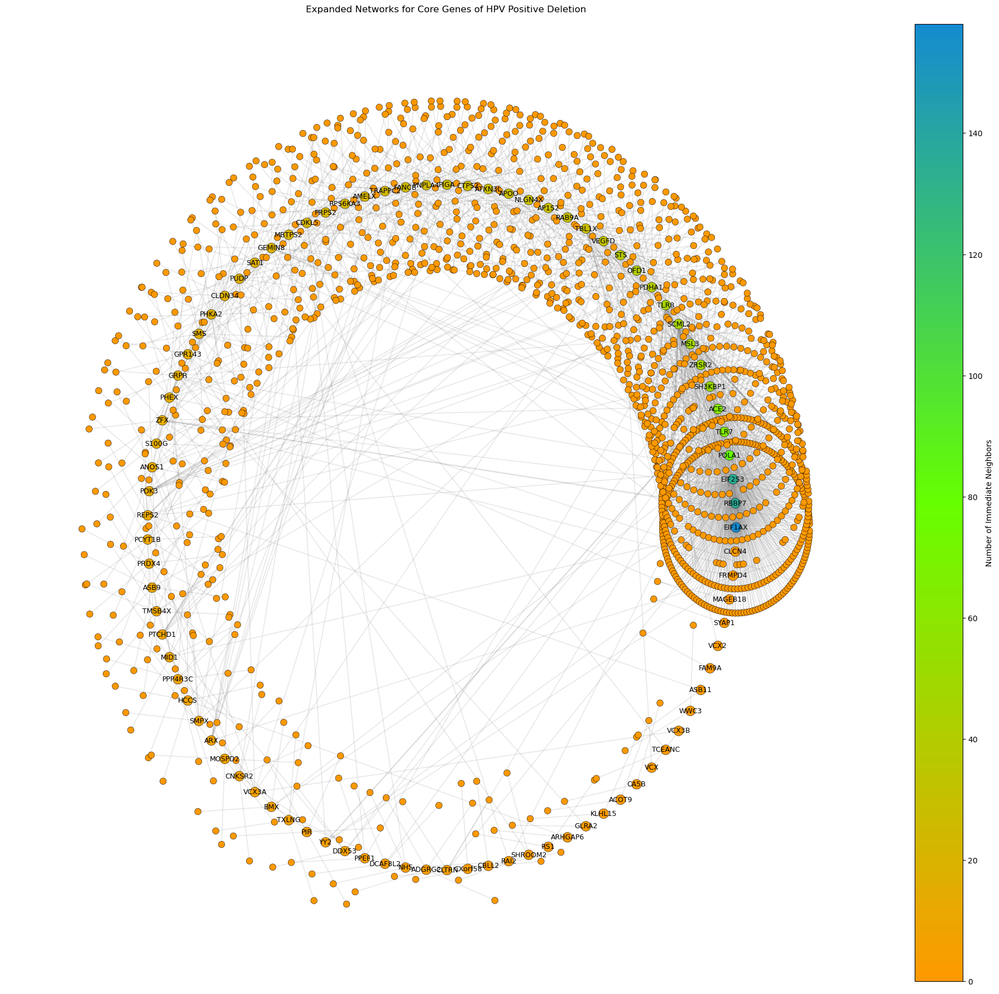

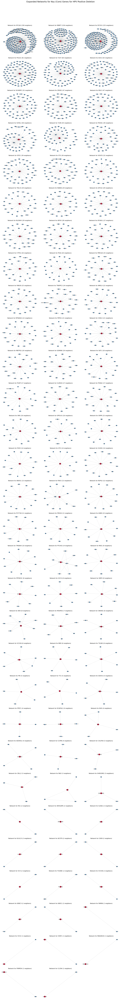

In [70]:
top_genes_and_neighbors_plotting(hpv_positive_deletion_top_genes, section_name='HPV Positive Deletion', top_number=100)

In [71]:
drugs_connected_top_genes_and_neighbors(hpv_positive_deletion_top_genes)

Number of risk genes identified from CNV analysis: 274
Number of risk genes available in the DrugBank database: 20
Number of drugs these risk genes are connected to in the DrugBank database: 63
Number of risk genes identified from CNV analysis: 274
Number of risk genes available in the PPI database: 89
Total number of immediate neighbors found through PPI: 1518
Total number of genes both risk genes and immediate neighbors in the protein interaction database: 1565
These are the top gene candidates along with the genes found to be immediate neighbors through the STRING protein interaction database.
Number of drugs these immediate neighbor genes are connected to in the DrugBank database: 1922
Total number of unique genes both risk genes and immediate neighbors in the protein interaction database: 1566
Number of drugs these genes are connected to in the DrugBank database: 1928


In [72]:
drugbank_df[drugbank_df['gene'].isin(list(hpv_positive_deletion_top_genes['gene_name'].unique()))]

,drug,gene,action,specific_function
412,Choline,PCYT1B,product of,choline-phosphate cytidylyltransferase activity
459,Spermine,SMS,ligand,spermine synthase activity
699,Glycine,GLRA2,ligand,extracellularly glycine-gated chloride channel...
828,NADH,PDHA1,None,metal ion binding
1320,Cladribine,POLA1,inhibitor,chromatin binding
...,...,...,...,...
22449,GSK2245035,TLR7,modulator,double-stranded RNA binding
22584,Selgantolimod,TLR8,agonist,DNA binding
22656,Afimetoran,TLR7,antagonist,double-stranded RNA binding
22657,Afimetoran,TLR8,antagonist,DNA binding


In [73]:
### calculate significant drug candidates using significance function
hpv_positive_del_signficant_drug_candidates = identify_significant_drug_candidates(hpv_positive_deletion_top_genes)
top_hpv_positive_del_significant_drug_candidates = hpv_positive_del_signficant_drug_candidates[hpv_positive_del_signficant_drug_candidates['empirical_fdr'] < 0.05].copy()
top_hpv_positive_del_significant_drug_candidates = top_hpv_positive_del_significant_drug_candidates[top_hpv_positive_del_significant_drug_candidates['hypergeom_fdr'] < 0.05]
print(f"Number of significant drug candidates identified: {top_hpv_positive_del_significant_drug_candidates.shape[0]}")

Total number of genes both risk genes and immediate neighbors in the protein interaction database: 1565
Total number of top genes identified as risk genes from CNV analysis: 274
Number of risk genes available in the PPI database: 89
Total number of immediate neighbors found through PPI: 1518
These are the top gene candidates along with the genes found to be immediate neighbors through the STRING protein interaction database.
---- Risk genes stats ----
Total number of risk genes identified from CNV analysis: 274
Of which 20 are found in DrugBank.
these connect to 63 unique drugs in DrugBank.
---- Neighboors stats ----
Total number of risk genes identified in DrugBank after connecting to PPI: 458
These are connected to 1939 unique drugs in DrugBank.
Of which 18 are HNC approved medications.
---- Altogether stats (risk genes + immediate neighbors) ----
Of which 458 are found in DrugBank.
these connect to 1939 unique drugs in DrugBank.


Running permutations for empirical p-values: 100%|██████████| 100000/100000 [03:19<00:00, 501.85it/s]



Universe size M=4150, risk set size n=458, drugs tested=9368
Permutation-significant (empirical FDR < 0.05): 42

Number of significant drug candidates identified: 42


In [74]:
top_hpv_positive_del_significant_drug_candidates.sort_values(by=['overlap_with_my_genes', 'empirical_fdr', 'hypergeom_fdr']).head(20)

,drug,targets_in_drugbank,overlap_with_my_genes,a_inRisk_inDrug,b_notRisk_inDrug,c_inRisk_notDrug,d_notRisk_notDrug,expected_overlap,fold_enrichment,hypergeom_p_value,hypergeom_fdr,empirical_p_value,empirical_fdr,baseline_prob_ge2,proportion_of_targets_in_risk_set
30,XL820,4,4,4,0,454,3692,0.441446,9.061135,0.000147,0.032703,0.00012,0.036263,0.06351,1.000000
32,Vatalanib,4,4,4,0,454,3692,0.441446,9.061135,0.000147,0.032703,0.00014,0.038574,0.06245,1.000000
34,Trimethyllysine,4,4,4,0,454,3692,0.441446,9.061135,0.000147,0.032703,0.00015,0.039033,0.06225,1.000000
35,Pracinostat,4,4,4,0,454,3692,0.441446,9.061135,0.000147,0.032703,0.00015,0.039033,0.06320,1.000000
36,CRx-139,4,4,4,0,454,3692,0.441446,9.061135,0.000147,0.032703,0.00019,0.046840,0.06262,1.000000
37,BMS-690514,4,4,4,0,454,3692,0.441446,9.061135,0.000147,0.032703,0.00019,0.046840,0.06385,1.000000
38,Infigratinib,4,4,4,0,454,3692,0.441446,9.061135,0.000147,0.032703,0.00021,0.046840,0.06265,1.000000
39,Pexidartinib,4,4,4,0,454,3692,0.441446,9.061135,0.000147,0.032703,0.00021,0.046840,0.06336,1.000000
40,Pemigatinib,4,4,4,0,454,3692,0.441446,9.061135,0.000147,0.032703,0.00021,0.046840,0.06265,1.000000
41,Futibatinib,4,4,4,0,454,3692,0.441446,9.061135,0.000147,0.032703,0.00021,0.046840,0.06265,1.000000


In [75]:
'Melatonin' in top_hpv_positive_del_significant_drug_candidates['drug'].values

False

Total number of genes in the direct drug gene interaction database: 274
These are the top gene candidates identified from CNV analysis, which will be connected to drugs in the DrugBank database.


Processing top direct genes: 100%|██████████| 274/274 [00:00<00:00, 453.85it/s]
check for approved medications: 3it [00:00, 19784.45it/s]

Number of unique drugs in the final database: 3
Number of unique genes in the final database: 3
Number of approved drugs in the final database: 0


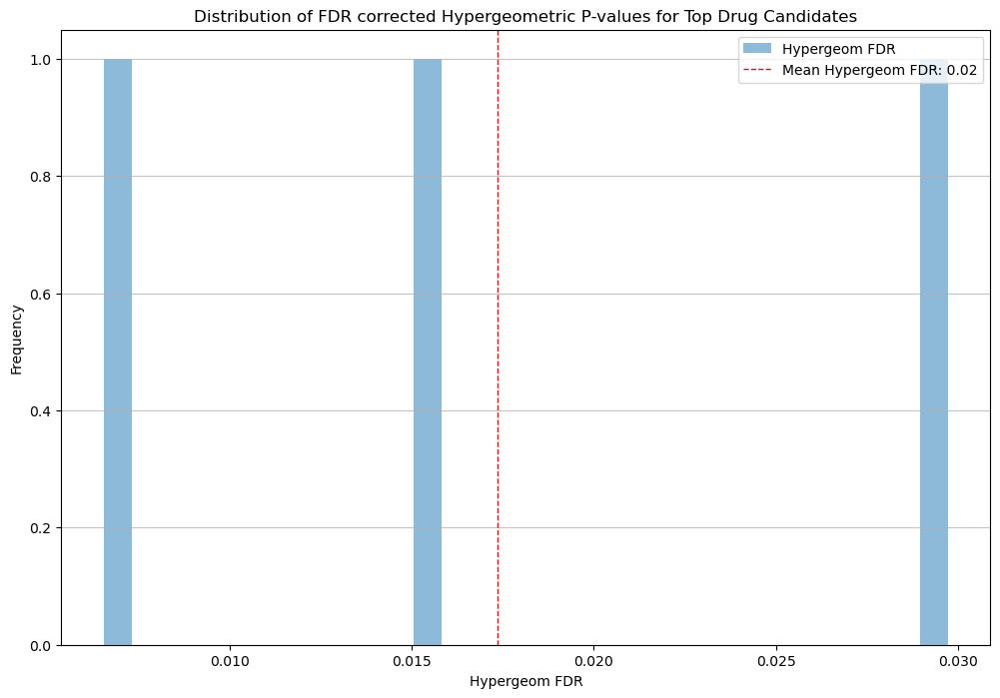

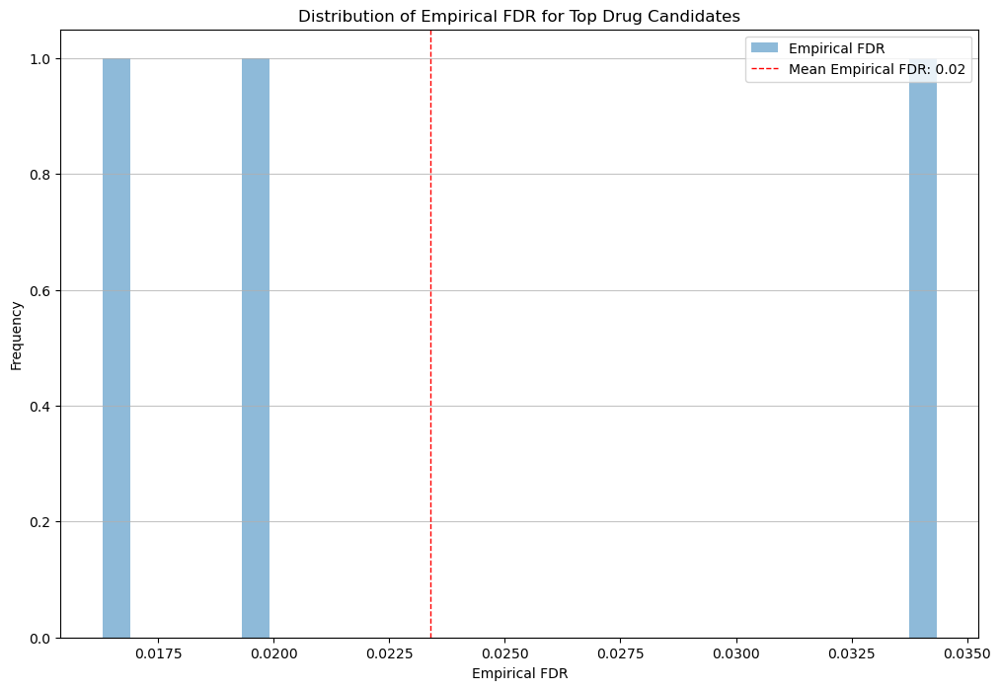

In [76]:
hpv_pos_del_top_direct_drug_candidates = top_direct_drug_candidates(hpv_positive_deletion_top_genes, hpv_positive_del_signficant_drug_candidates, plotting=True)

In [77]:
hpv_pos_del_top_direct_drug_candidates

,GENE_TARGET,CONNECTED_TO,PPI_SCORE,DRUG,GENE_GISTIC,GENE_normalized_gistic_score,GENE_frequency_percentage,GENE_SIGNIFICANT,ACTION,SPECIFIC_FUNCTION,drug_hypergeom_p_value,drug_hypergeom_fdr,drug_empirical_p_value,drug_empirical_fdr,HNC_approved_medication
0,VEGFD,NA,0,TG-100801,0.091071,0.0,14.479638,True,inhibitor,chemoattractant activity,0.000040,0.015762,0.00005,0.019516,False
1,TLR7,NA,0,Golotimod,0.091071,0.0,14.479638,True,NaN,double-stranded RNA binding,0.000016,0.006539,0.00004,0.016292,False
2,POLA1,NA,0,Cladribine,0.091071,0.0,14.479638,True,inhibitor,chromatin binding,0.000092,0.029731,0.00011,0.034349,False


In [78]:
hpv_pos_del_top_direct_drug_candidates_agg = agg_top_direct_drug_candidates(hpv_pos_del_top_direct_drug_candidates)

In [79]:
hpv_pos_del_top_direct_drug_candidates_agg

,DRUG,NUM_DIRECT_TARGETS_HIT,TOTAL_TARGETS_IN_DRUGBANK,PERCENTAGE_OF_TARGETS_HIT,GENE_TARGET,GENE_GISTIC,GENE_normalized_gistic_score,ACTION,SPECIFIC_FUNCTION,drug_hypergeom_p_value,drug_hypergeom_fdr,drug_empirical_p_value,drug_empirical_fdr
0,Golotimod,1,5,20.000000,TLR7,0.091071,0.0,NaN,double-stranded RNA binding,0.000016,0.006539,0.00004,0.016292
1,TG-100801,1,8,12.500000,VEGFD,0.091071,0.0,inhibitor,chemoattractant activity,0.000040,0.015762,0.00005,0.019516
2,Cladribine,1,12,8.333333,POLA1,0.091071,0.0,inhibitor,chromatin binding,0.000092,0.029731,0.00011,0.034349


Total number of genes both risk genes and immediate neighbors in the protein interaction database: 1565
Total number of top genes identified as risk genes from CNV analysis: 274
Number of risk genes available in the PPI database: 89
Total number of immediate neighbors found through PPI: 1518
These are the top gene candidates along with the genes found to be immediate neighbors through the STRING protein interaction database.


Processing connected genes: 1838it [00:00, 2158.30it/s]
check for approved medications: 443it [00:00, 61442.30it/s]

Number of unique genes in indirect hits: 100
Number of unique drugs in indirect hits: 42
Number of approved medications identified: 0


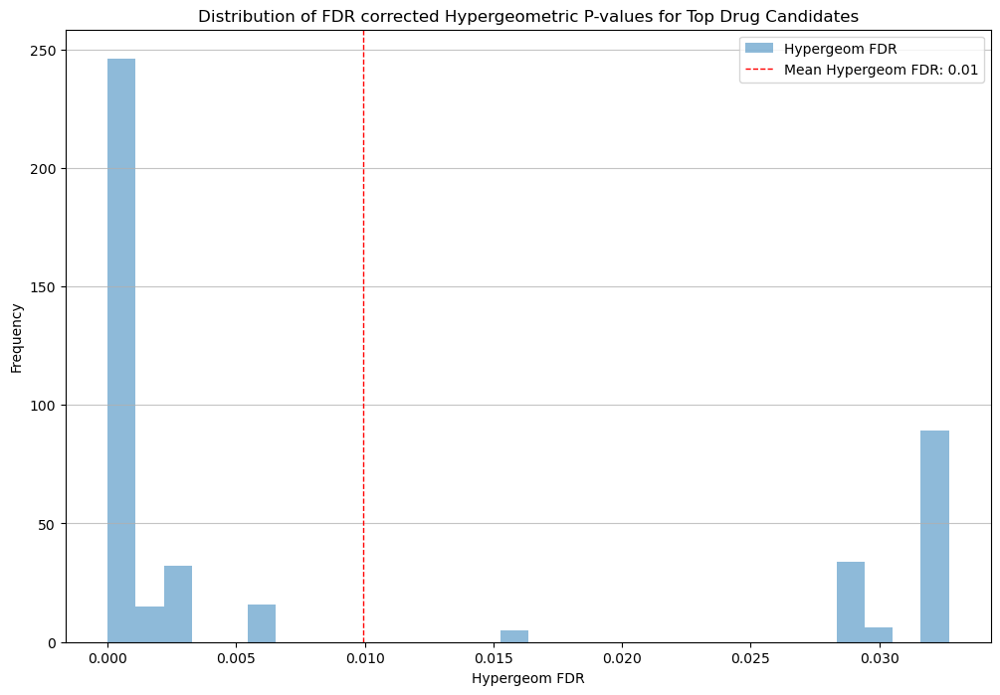

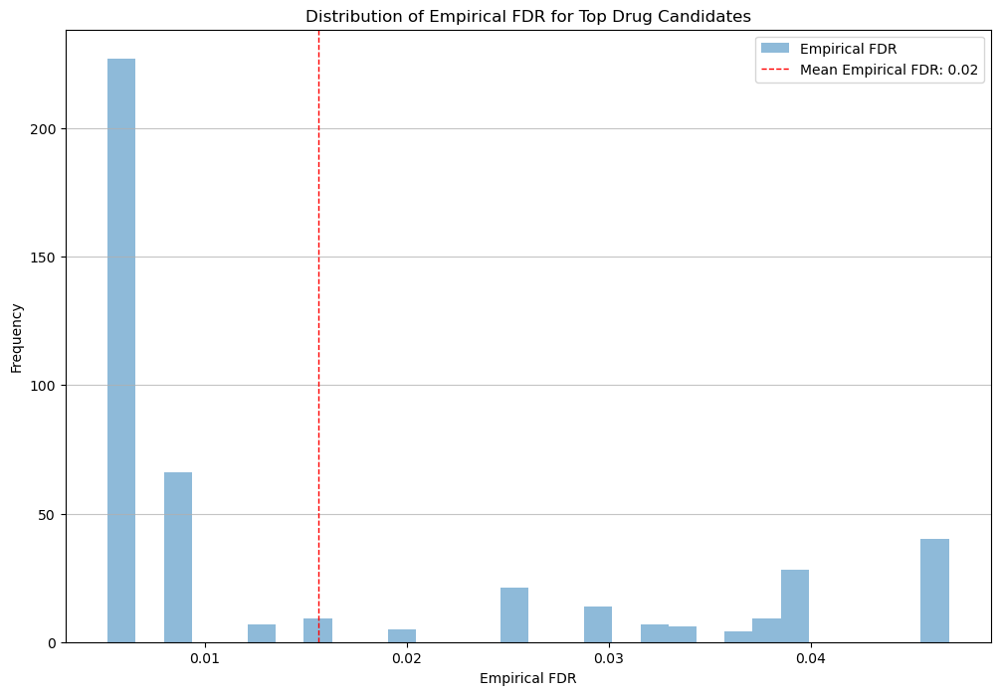

In [80]:
hpv_pos_del_top_indirect_drug_candidates = top_indirect_drug_candidates(hpv_positive_deletion_top_genes, hpv_positive_del_signficant_drug_candidates, plotting=True)

In [81]:
hpv_pos_del_top_indirect_drug_candidates.sort_values(by=['drug_hypergeom_fdr', 'drug_empirical_fdr'], ascending=[True, True]).reset_index(drop=True).head(25)

,GENE_TARGET,CONNECTED_TO,PPI_SCORE,DRUG,GENE_GISTIC,GENE_normalized_gistic_score,GENE_frequency_percentage,GENE_SIGNIFICANT,ACTION,SPECIFIC_FUNCTION,drug_hypergeom_p_value,drug_hypergeom_fdr,drug_empirical_p_value,drug_empirical_fdr,HNC_approved_medication
0,FGFR1,ANOS1,998,Nintedanib,0.091071,0.0,14.479638,True,inhibitor,ATP binding,2.871459e-10,0.000003,0.00001,0.005204,False
1,FLT1,VEGFD,999,Nintedanib,0.091071,0.0,14.479638,True,inhibitor,ATP binding,2.871459e-10,0.000003,0.00001,0.005204,False
2,FLT3,VEGFD,839,Nintedanib,0.091071,0.0,14.479638,True,inhibitor,ATP binding,2.871459e-10,0.000003,0.00001,0.005204,False
3,FLT4,VEGFD,999,Nintedanib,0.091071,0.0,14.479638,True,inhibitor,ATP binding,2.871459e-10,0.000003,0.00001,0.005204,False
4,FGFR2,VEGFD,737,Nintedanib,0.091071,0.0,14.479638,True,inhibitor,ATP binding,2.871459e-10,0.000003,0.00001,0.005204,False
5,PDGFRA,VEGFD,861,Nintedanib,0.091071,0.0,14.479638,True,inhibitor,ATP binding,2.871459e-10,0.000003,0.00001,0.005204,False
6,FGFR1,VEGFD,887,Nintedanib,0.091071,0.0,14.479638,True,inhibitor,ATP binding,2.871459e-10,0.000003,0.00001,0.005204,False
7,PDGFRB,VEGFD,809,Nintedanib,0.091071,0.0,14.479638,True,inhibitor,ATP binding,2.871459e-10,0.000003,0.00001,0.005204,False
8,KDR,VEGFD,999,Nintedanib,0.091071,0.0,14.479638,True,inhibitor,ATP binding,2.871459e-10,0.000003,0.00001,0.005204,False
9,FGFR3,VEGFD,714,Nintedanib,0.091071,0.0,14.479638,True,inhibitor,ATP binding,2.871459e-10,0.000003,0.00001,0.005204,False


In [82]:
hpv_pos_del_top_indirect_drug_candidates['DIRECT'] = False * len(hpv_pos_del_top_indirect_drug_candidates)
hpv_pos_del_top_direct_drug_candidates['DIRECT'] = True * len(hpv_pos_del_top_direct_drug_candidates)
hpv_pos_del_top_candidates = pd.concat([hpv_pos_del_top_indirect_drug_candidates, hpv_pos_del_top_direct_drug_candidates], axis=0)
hpv_pos_del_top_candidates.to_csv('Results/hpv_pos_del_top_drugBank_drug_candidates.csv', index=False)

In [83]:
hpv_pos_del_top_indirect_drug_candidates_agg = agg_top_indirect_drug_candidates(hpv_pos_del_top_indirect_drug_candidates)

/var/folders/5p/swntgnbj3fbfxkx02kt3fq980000gn/T/ipykernel_51208/318329654.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_indirect_drug_candidates['num_genes_targeted'] = top_indirect_drug_candidates.groupby('DRUG')['GENE_TARGET'].transform('nunique')


In [84]:
list(hpv_pos_del_top_indirect_drug_candidates_agg['DRUG'].unique())

['sunitinib',
 'lucitanib',
 'famitinib',
 'linifanib',
 'ripretinib',
 'surufatinib',
 'golotimod',
 'vatalanib',
 'trimethyllysine',
 'bms-690514',
 'futibatinib',
 'infigratinib',
 'pemigatinib',
 'pexidartinib',
 'nintedanib',
 'sorafenib',
 'tivozanib',
 'erdafitinib',
 'lenvatinib',
 'vorinostat',
 'amuvatinib',
 'selpercatinib',
 'pazopanib',
 'martinostat',
 'ponatinib',
 'foreskin fibroblast (neonatal)',
 'regorafenib',
 'foreskin keratinocyte (neonatal)',
 'brigatinib',
 'pd-166326',
 'semaxanib',
 'tg-100801',
 'cladribine',
 'artenimol']

In [85]:
hpv_pos_del_top_indirect_drug_candidates_agg

,DRUG,CONNECTED_TO (risk gene),Number of risk or immediate neighbor genes targeted,total_genes_targeted_in_drugbank,PERCENTAGE_OF_TARGETS_HIT,Number of indirect genes connected to this risk gene,GENE_TARGET,GENE_GISTIC,GENE_normalized_gistic_score,GENE_frequency_percentage,ACTION,SPECIFIC_FUNCTION,drug_hypergeom_fdr,drug_empirical_fdr
71,sunitinib,VEGFD,9,9,100.000000,9,"FLT1, FLT3, FLT4, PDGFRA, CSF1R, KIT, MET, PDG...",0.091071,0.0,14.479638,inhibitor,ATP binding,0.000005,0.005204
36,lucitanib,ANOS1,8,8,100.000000,1,FGFR1,0.091071,0.0,14.479638,inhibitor,ATP binding,0.000024,0.005204
37,lucitanib,VEGFD,8,8,100.000000,7,"FLT1, FLT4, FGFR2, PDGFRA, PDGFRB, KDR, FGFR3",0.091071,0.0,14.479638,inhibitor,ATP binding,0.000024,0.005204
21,famitinib,VEGFD,7,7,100.000000,7,"FLT1, FLT3, FLT4, PDGFRA, KIT, PDGFRB, KDR",0.091071,0.0,14.479638,inhibitor,ATP binding,0.000149,0.005204
35,linifanib,VEGFD,6,6,100.000000,6,"FLT1, FLT3, FLT4, CSF1R, KIT, KDR",0.091071,0.0,14.479638,modulator,ATP binding,0.000913,0.005204
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8,artenimol,PRDX4,29,104,27.884615,1,P4HB,0.091071,0.0,14.479638,ligand,actin binding,0.000306,0.008922
9,artenimol,PUDP,29,104,27.884615,1,GPI,0.091071,0.0,14.479638,ligand,carbohydrate derivative binding,0.000306,0.008922
10,artenimol,RBBP7,29,104,27.884615,1,NPM1,0.091071,0.0,14.479638,ligand,chromatin binding,0.000306,0.008922
11,artenimol,TMSB4X,29,104,27.884615,3,"ACTG1, PFN1, CFL1",0.091071,0.0,14.479638,ligand,"ATP binding, actin binding, actin filament bin...",0.000306,0.008922


#### All HPV+ results

In [86]:
all_hpv_positive_amp_top_drugs = pd.concat([hpv_pos_amp_top_direct_drug_candidates, hpv_pos_amp_top_indirect_drug_candidates], ignore_index=True)
all_hpv_positive_del_top_drugs = pd.concat([hpv_pos_del_top_direct_drug_candidates, hpv_pos_del_top_indirect_drug_candidates], ignore_index=True)
all_hpv_positive_top_drugs = pd.concat([all_hpv_positive_amp_top_drugs, all_hpv_positive_del_top_drugs], ignore_index=True)
print(f"number of unique drugs in all hpv positive top drugs: {len(all_hpv_positive_top_drugs['DRUG'].unique())}")
print(f"number of unique genes in all hpv positive top drugs: {len(all_hpv_positive_top_drugs['GENE_TARGET'].unique())}")
print(f"Number of approved drugs in all hpv positive top drugs: {all_hpv_positive_top_drugs['HNC_approved_medication'].sum()}")

number of unique drugs in all hpv positive top drugs: 153
number of unique genes in all hpv positive top drugs: 392
Number of approved drugs in all hpv positive top drugs: 0


In [87]:
agg_hpv_positive_direct = amp_del_direct_drug_candidates(hpv_pos_amp_top_direct_agg, hpv_pos_del_top_direct_drug_candidates_agg, title = 'HPV Positive Top Direct Drug Candidates Aggregated.csv')

In [88]:
agg_hpv_positive_direct

,DRUG,GENE_TARGET,NUM_DIRECT_TARGETS_HIT,TOTAL_TARGETS_IN_DRUGBANK,PERCENTAGE_OF_TARGETS_HIT,GENE_GISTIC,GENE_normalized_gistic_score,ACTION,SPECIFIC_FUNCTION,drug_hypergeom_p_value,drug_hypergeom_fdr,drug_empirical_p_value,drug_empirical_fdr,MUT_TYPE
0,Buparlisib,PIK3CA,1,4,25.000000,0.3024824233651801,0.24579176471850595,inhibitor,1-phosphatidylinositol-3-kinase activity,5.168234e-04,3.433760e-02,0.00057,0.040247,AMPLIFICATION
1,CH-5132799,PIK3CA,1,4,25.000000,0.3024824233651801,0.24579176471850595,inhibitor,1-phosphatidylinositol-3-kinase activity,5.168234e-04,3.433760e-02,0.00057,0.040247,AMPLIFICATION
2,Cladribine,POLA1,1,12,8.333333,0.091071026391761,0.0,inhibitor,chromatin binding,9.203648e-05,2.973096e-02,0.00011,0.034349,DELETION
3,Copanlisib,PIK3CA,1,4,25.000000,0.3024824233651801,0.24579176471850595,inhibitor,1-phosphatidylinositol-3-kinase activity,5.168234e-04,3.433760e-02,0.00057,0.040247,AMPLIFICATION
4,Copper,AHSG,2,146,1.369863,0.3024208458615908,0.24296541800124416,None,cysteine-type endopeptidase inhibitor activity,8.218045e-15,2.566222e-11,0.00001,0.002342,AMPLIFICATION
5,Copper,KNG1,2,146,1.369863,0.3024208458615908,0.24296541800124416,None,cysteine-type endopeptidase inhibitor activity,8.218045e-15,2.566222e-11,0.00001,0.002342,AMPLIFICATION
6,Golotimod,TLR7,1,5,20.000000,0.091071026391761,0.0,None,double-stranded RNA binding,1.605536e-05,6.539420e-03,0.00004,0.016292,DELETION
7,NADH,NDUFB5,1,144,0.694444,0.3020838945465298,0.22749968477582705,None,NADH dehydrogenase (ubiquinone) activity,6.205177e-08,2.325204e-05,0.00001,0.002342,AMPLIFICATION
8,TG-100801,VEGFD,1,8,12.500000,0.091071026391761,0.0,inhibitor,chemoattractant activity,4.038151e-05,1.576225e-02,0.00005,0.019516,DELETION
9,XL765,PIK3CA,1,5,20.000000,0.3024824233651801,0.24579176471850595,None,1-phosphatidylinositol-3-kinase activity,7.766063e-05,8.661009e-03,0.00009,0.011287,AMPLIFICATION


In [89]:
'artenimol' in hpv_pos_amp_top_indirect_drug_candidates_agg['DRUG']


False

In [90]:
agg_hpv_positive_indirect = agg_amp_del_indirect_drug_candidates(hpv_pos_amp_top_indirect_drug_candidates_agg, hpv_pos_del_top_indirect_drug_candidates_agg, title = 'HPV Positive Top Indirect Drug Candidates Aggregated.csv')

In [91]:
'Atorvastatin' in list(agg_hpv_positive_indirect['DRUG'].unique())

False

In [92]:
agg_hpv_positive_indirect.sort_values(by='PERCENTAGE_OF_TARGETS_HIT', ascending=False).head(25)

,DRUG,GENE_TARGET,CONNECTED_TO (risk gene),Number of risk or immediate neighbor genes targeted,total_genes_targeted_in_drugbank,PERCENTAGE_OF_TARGETS_HIT,Number of indirect genes connected to this risk gene,GENE_GISTIC,GENE_normalized_gistic_score,GENE_frequency_percentage,ACTION,SPECIFIC_FUNCTION,drug_hypergeom_fdr,drug_empirical_fdr,MUT_TYPE
0,abrocitinib,"JAK2, TYK2, JAK3, JAK1",PIK3CA,4,4,100.0,4,0.3024824233651801,0.24579176471850595,33.484162895927604,inhibitor,"acetylcholine receptor binding, ATP binding",0.034338,0.040247,AMPLIFICATION
62,methacholine,"CHRM1,CHRM3, CHRM4, CHRM5,CHRM2","SST,KNG1,GNB4",5,5,100.0,3,"0.3142891071420124,0.3024208458615908,0.302083...","0.7877069121227755,0.24296541800124416,0.22749...","34.38914027149321,33.484162895927604,33.484162...",agonist,G protein-coupled acetylcholine receptor activity,0.008661,0.011287,AMPLIFICATION
60,lutetium lu 177 dotatate,"SSTR4, SSTR3, SSTR5, SSTR1, SSTR2",SST,5,5,100.0,5,0.3142891071420124,0.7877069121227755,34.38914027149321,agonist,"neuropeptide binding, G protein-coupled recept...",0.008661,0.013225,AMPLIFICATION
59,lucitanib,"FGFR1, FGFR3, KDR, PDGFRB, FLT1, PDGFRA, FGFR2...","PIK3CA,ANOS1,VEGFD",8,8,100.0,8,"0.3024824233651801,0.091071026391761,0.0910710...","0.24579176471850595,0.0,0.0","33.484162895927604,14.479638009049774,14.47963...",inhibitor,ATP binding,0.000087,0.002342,"AMPLIFICATION,DELETION"
97,sorafenib,"RAF1, FGFR1, KDR, PDGFRB, EGFR, FLT1, BRAF, KI...","PIK3CA,ANOS1,CNKSR2,VEGFD",11,11,100.0,11,"0.3024824233651801,0.091071026391761,0.0910710...","0.24579176471850595,0.0,0.0,0.0","33.484162895927604,14.479638009049774,14.47963...","inhibitor, antagonist","ATP binding, actin filament binding",0.000001,0.002342,"AMPLIFICATION,DELETION"
57,linifanib,"KDR, FLT1, KIT, CSF1R, FLT4, FLT3,FLT1, FLT3, ...","PIK3CA,VEGFD",6,6,100.0,6,"0.3024824233651801,0.091071026391761","0.24579176471850595,0.0","33.484162895927604,14.479638009049774",modulator,ATP binding,0.002228,0.003824,"AMPLIFICATION,DELETION"
56,lenvatinib,"FGFR1, FGFR4, FGFR3, KDR, FLT1, KIT, RET, PDGF...","PIK3CA,ANOS1,VEGFD",10,10,100.0,10,"0.3024824233651801,0.091071026391761,0.0910710...","0.24579176471850595,0.0,0.0","33.484162895927604,14.479638009049774,14.47963...",inhibitor,ATP binding,0.000003,0.002342,"AMPLIFICATION,DELETION"
55,jnj-28312141,"LCK, KIT, NTRK3, FLT3",PIK3CA,4,4,100.0,4,0.3024824233651801,0.24579176471850595,33.484162895927604,inhibitor,ATP binding,0.034338,0.040247,AMPLIFICATION
54,infigratinib,"FGFR1, FGFR4, FGFR3, FGFR2,FGFR1,FGFR2, FGFR4,...","PIK3CA,ANOS1,VEGFD",4,4,100.0,4,"0.3024824233651801,0.091071026391761,0.0910710...","0.24579176471850595,0.0,0.0","33.484162895927604,14.479638009049774,14.47963...",inhibitor,ATP binding,0.034338,0.040247,"AMPLIFICATION,DELETION"
98,sr-123781a,"SERPINC1, F10, F2",HRG,4,4,100.0,3,0.3024208458615908,0.24296541800124416,33.484162895927604,modulator,"heparin binding, calcium ion binding",0.034338,0.040247,AMPLIFICATION


In [93]:
hpv_pos_amp_del_direct_genes = amp_del_direct_genes(hpv_positive_amplification_top_genes, hpv_positive_deletion_top_genes)

In [94]:
hpv_pos_amp_del_direct_genes[(hpv_pos_amp_del_direct_genes['MUT_TYPE']=='AMPLIFICATION,DELETION') | (hpv_pos_amp_del_direct_genes['MUT_TYPE']=='DELETION,AMPLIFICATION')]

,gene_name,gene,Sample_size,amplification_count,frequency_percentage,gistic_score,p_value,q_value,significant,empirical_p_value,empirical_q_value,empirical_significant,chromosome,start,end,length,coverage_percentage,MUT_TYPE
433,Y_RNA,ENSG00000200616.1,221,147.0,33.484163,0.302482,2.769990e-40,1.166147e-37,True,0.000999,0.011719,True,chr3,9874601,191641237,110.0,0.000075,"AMPLIFICATION,DELETION"


In [95]:
hpv_pos_top_genes = top_genes_connected_to_meds(agg_hpv_positive_direct, agg_hpv_positive_indirect, hpv_positive_amplification_top_genes, hpv_positive_deletion_top_genes)

Number of unique risk genes: 46
Number of direct risk genes: 8
Number of indirect risk genes: 46
Number of top genes connected to medications: 46


In [96]:
hpv_pos_top_genes

,gene_name,gene,Sample_size,amplification_count,frequency_percentage,gistic_score,p_value,q_value,significant,empirical_p_value,empirical_q_value,empirical_significant,chromosome,start,end,length,coverage_percentage,MUT_TYPE
113,ACE2,ENSG00000130234.12,221,0.0,14.479638,0.091071,7.686503e-08,1.568952e-05,True,0.000999,0.025404,True,chrX,15494566,15607236,NaN,0.072206,DELETION
115,ACTL6A,ENSG00000136518.17,221,74.0,33.484163,0.302084,2.769990e-40,1.166147e-37,True,0.000999,0.011719,True,chr3,179562886,179588407,25522.0,0.012871,AMPLIFICATION
117,ADIPOQ,ENSG00000181092.10,221,74.0,33.484163,0.302421,2.769990e-40,1.166147e-37,True,0.000999,0.011719,True,chr3,186842704,186858463,15760.0,0.007948,AMPLIFICATION
119,AHSG,ENSG00000145192.13,221,74.0,33.484163,0.302421,2.769990e-40,1.166147e-37,True,0.000999,0.011719,True,chr3,186613060,186621318,8259.0,0.004165,AMPLIFICATION
130,ANOS1,ENSG00000011201.12,221,0.0,14.479638,0.091071,7.686503e-08,1.568952e-05,True,0.000999,0.025404,True,chrX,8528874,8732137,NaN,0.130263,DELETION
142,BMX,ENSG00000102010.15,221,0.0,14.479638,0.091071,7.686503e-08,1.568952e-05,True,0.000999,0.025404,True,chrX,15464246,15556529,NaN,0.059141,DELETION
155,CLDN1,ENSG00000163347.6,221,73.0,33.031674,0.297817,2.637646e-39,8.834366e-37,True,0.000999,0.011719,True,chr3,190305707,190322446,16740.0,0.008442,AMPLIFICATION
159,CNKSR2,ENSG00000149970.16,221,0.0,14.479638,0.091071,7.686503e-08,1.568952e-05,True,0.000999,0.025404,True,chrX,21372801,21654695,NaN,0.180655,DELETION
167,DNAJB11,ENSG00000090520.11,221,74.0,33.484163,0.302421,2.769990e-40,1.166147e-37,True,0.000999,0.011719,True,chr3,186567403,186585800,18398.0,0.009278,AMPLIFICATION
174,EIF2S3,ENSG00000130741.11,221,0.0,14.479638,0.091071,7.686503e-08,1.568952e-05,True,0.000999,0.025404,True,chrX,24054946,24078810,NaN,0.015294,DELETION


In [97]:
hpv_pos_top_genes.to_csv('Results/CNV Results/HPV positive CNV top genes.csv')

In [98]:
### combine hpv positve amplification top direct drug candidates and hpv positive deletion top direct drug candidates
all_hpv_positive_top_direct_drug_candidates = pd.concat([hpv_pos_amp_top_direct_drug_candidates, hpv_pos_del_top_direct_drug_candidates], ignore_index=True)
print(f"number of unique drugs in all hpv positive top direct drug candidates: {len(all_hpv_positive_top_direct_drug_candidates['DRUG'].unique())}")
print(f"number of unique genes in all hpv positive top direct drug candidates: {len(all_hpv_positive_top_direct_drug_candidates['GENE_TARGET'].unique())}")
print(f"Number of approved drugs in all hpv positive top direct drug candidates: {all_hpv_positive_top_direct_drug_candidates['HNC_approved_medication'].sum()}")

number of unique drugs in all hpv positive top direct drug candidates: 13
number of unique genes in all hpv positive top direct drug candidates: 8
Number of approved drugs in all hpv positive top direct drug candidates: 0


In [99]:
hpv_pos_del_top_indirect_drug_candidates_agg

,DRUG,CONNECTED_TO (risk gene),Number of risk or immediate neighbor genes targeted,total_genes_targeted_in_drugbank,PERCENTAGE_OF_TARGETS_HIT,Number of indirect genes connected to this risk gene,GENE_TARGET,GENE_GISTIC,GENE_normalized_gistic_score,GENE_frequency_percentage,ACTION,SPECIFIC_FUNCTION,drug_hypergeom_fdr,drug_empirical_fdr
71,sunitinib,VEGFD,9,9,100.000000,9,"FLT1, FLT3, FLT4, PDGFRA, CSF1R, KIT, MET, PDG...",0.091071,0.0,14.479638,inhibitor,ATP binding,0.000005,0.005204
36,lucitanib,ANOS1,8,8,100.000000,1,FGFR1,0.091071,0.0,14.479638,inhibitor,ATP binding,0.000024,0.005204
37,lucitanib,VEGFD,8,8,100.000000,7,"FLT1, FLT4, FGFR2, PDGFRA, PDGFRB, KDR, FGFR3",0.091071,0.0,14.479638,inhibitor,ATP binding,0.000024,0.005204
21,famitinib,VEGFD,7,7,100.000000,7,"FLT1, FLT3, FLT4, PDGFRA, KIT, PDGFRB, KDR",0.091071,0.0,14.479638,inhibitor,ATP binding,0.000149,0.005204
35,linifanib,VEGFD,6,6,100.000000,6,"FLT1, FLT3, FLT4, CSF1R, KIT, KDR",0.091071,0.0,14.479638,modulator,ATP binding,0.000913,0.005204
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8,artenimol,PRDX4,29,104,27.884615,1,P4HB,0.091071,0.0,14.479638,ligand,actin binding,0.000306,0.008922
9,artenimol,PUDP,29,104,27.884615,1,GPI,0.091071,0.0,14.479638,ligand,carbohydrate derivative binding,0.000306,0.008922
10,artenimol,RBBP7,29,104,27.884615,1,NPM1,0.091071,0.0,14.479638,ligand,chromatin binding,0.000306,0.008922
11,artenimol,TMSB4X,29,104,27.884615,3,"ACTG1, PFN1, CFL1",0.091071,0.0,14.479638,ligand,"ATP binding, actin binding, actin filament bin...",0.000306,0.008922


In [100]:
### combine only direct hits of both amplification and deletion
all_hpv_positive_direct_top_drugs = pd.concat([hpv_pos_amp_top_direct_drug_candidates, hpv_pos_del_top_direct_drug_candidates], ignore_index=True)
print(f"number of unique drugs in all hpv positive direct top drugs: {len(all_hpv_positive_direct_top_drugs['DRUG'].unique())}")
print(f"number of unique genes in all hpv positive direct top drugs: {len(all_hpv_positive_direct_top_drugs['GENE_TARGET'].unique())}")
print(f"Number of approved drugs in all hpv positive direct top drugs: {all_hpv_positive_direct_top_drugs['HNC_approved_medication'].sum()}")

number of unique drugs in all hpv positive direct top drugs: 13
number of unique genes in all hpv positive direct top drugs: 8
Number of approved drugs in all hpv positive direct top drugs: 0


In [101]:
### combine only indirect hits of both amplification and deletion
all_hpv_positive_indirect_top_drugs = pd.concat([hpv_pos_amp_top_indirect_drug_candidates, hpv_pos_del_top_indirect_drug_candidates], ignore_index=True)
print(f"number of unique drugs in all hpv positive indirect top drugs: {len(all_hpv_positive_indirect_top_drugs['DRUG'].unique())}")
print(f"number of unique genes in all hpv positive indirect top drugs: {len(all_hpv_positive_indirect_top_drugs['GENE_TARGET'].unique())}")
print(f"Number of approved drugs in all hpv positive indirect top drugs: {all_hpv_positive_indirect_top_drugs['HNC_approved_medication'].sum()}")

number of unique drugs in all hpv positive indirect top drugs: 153
number of unique genes in all hpv positive indirect top drugs: 389
Number of approved drugs in all hpv positive indirect top drugs: 0


In [102]:
all_hpv_positive_top_drugs['DRUG'].unique()

array(['Zinc chloride', 'Zinc sulfate, unspecified form', 'NADH', 'XL765',
       'Buparlisib', 'Copanlisib', 'CH-5132799', 'Zinc', 'Copper',
       'Zinc acetate', 'Alteplase', 'Thrombin', 'Human thrombin',
       'Heparin', 'N-Formylmethionine', 'SR-123781A',
       'Human C1-esterase inhibitor', 'Conestat alfa', 'Artenimol',
       'Turoctocog alfa pegol', 'Aripiprazole', 'Trimebutine',
       'Somatostatin', 'KC706', 'Fostamatinib', 'Eletriptan',
       'Ziprasidone', 'Zolmitriptan', 'Dihydroergotamine', 'Clozapine',
       'Loxapine', 'Sumatriptan', 'Naratriptan', 'Rizatriptan',
       'Quetiapine', 'Aripiprazole lauroxil', 'Purvalanol',
       'Chlorprothixene', 'Pardoprunox', 'Gilteritinib', 'Enzastaurin',
       'Staurosporine', 'Tetrabromo-2-Benzotriazole', 'Midostaurin',
       'Perifosine', 'CI-1040', 'Cholic Acid', 'Bisindolylmaleimide I',
       'Regorafenib', 'Dasatinib', 'Talmapimod', 'VX-702', 'PD-166326',
       'Dilmapimod', 'Trihexyphenidyl', 'Oxyphencyclimine',
    

In [103]:
### aggregate and combine the final results for direct and indirect hits for hpv positive samples, labeling if amplification or deletion
all_hpv_positive_direct_top_drugs_agg = agg_top_direct_drug_candidates(all_hpv_positive_direct_top_drugs)
all_hpv_positive_direct_top_drugs_agg['CNV_TYPE'] = 'BOTH'
all_hpv_positive_indirect_top_drugs_agg = agg_top_indirect_drug_candidates(all_hpv_positive_indirect_top_drugs)
all_hpv_positive_indirect_top_drugs_agg['CNV_TYPE'] = 'BOTH'
all_hpv_positive_top_drugs_agg = pd.concat([all_hpv_positive_direct_top_drugs_agg, all_hpv_positive_indirect_top_drugs_agg], ignore_index=True)
all_hpv_positive_top_drugs_agg.sort_values(by=['PERCENTAGE_OF_TARGETS_HIT', 'NUM_DIRECT_TARGETS_HIT', 'drug_empirical_fdr', 'drug_hypergeom_fdr'], ascending=[False, False, True, True], inplace=True)
all_hpv_positive_top_drugs_agg.head(50)

/var/folders/5p/swntgnbj3fbfxkx02kt3fq980000gn/T/ipykernel_51208/318329654.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_indirect_drug_candidates['num_genes_targeted'] = top_indirect_drug_candidates.groupby('DRUG')['GENE_TARGET'].transform('nunique')


,DRUG,NUM_DIRECT_TARGETS_HIT,TOTAL_TARGETS_IN_DRUGBANK,PERCENTAGE_OF_TARGETS_HIT,GENE_TARGET,GENE_GISTIC,GENE_normalized_gistic_score,ACTION,SPECIFIC_FUNCTION,drug_hypergeom_p_value,drug_hypergeom_fdr,drug_empirical_p_value,drug_empirical_fdr,CNV_TYPE,CONNECTED_TO (risk gene),Number of risk or immediate neighbor genes targeted,total_genes_targeted_in_drugbank,Number of indirect genes connected to this risk gene,GENE_frequency_percentage
66,nintedanib,NaN,NaN,100.0,"FGFR1, FGFR3, SRC, KDR, PDGFRB, LCK, FLT1, PDG...",0.302482,0.245792,inhibitor,ATP binding,NaN,2.018575e-07,NaN,0.002342,BOTH,PIK3CA,12.0,12.0,12.0,33.484163
67,sorafenib,NaN,NaN,100.0,"RAF1, FGFR1, KDR, PDGFRB, EGFR, FLT1, BRAF, KI...",0.302482,0.245792,"inhibitor, antagonist","ATP binding, actin filament binding",NaN,1.017234e-06,NaN,0.002342,BOTH,PIK3CA,11.0,11.0,11.0,33.484163
68,erdafitinib,NaN,NaN,100.0,"FGFR1, FGFR4, FGFR3, KDR, PDGFRB, KIT, CSF1R, ...",0.302482,0.245792,"inhibitor, substrate",ATP binding,NaN,3.033567e-06,NaN,0.002342,BOTH,PIK3CA,10.0,10.0,10.0,33.484163
69,lenvatinib,NaN,NaN,100.0,"FGFR1, FGFR4, FGFR3, KDR, FLT1, KIT, RET, PDGF...",0.302482,0.245792,inhibitor,ATP binding,NaN,3.033567e-06,NaN,0.002342,BOTH,PIK3CA,10.0,10.0,10.0,33.484163
70,brigatinib,NaN,NaN,100.0,"IGF1R, MET, ALK, ERBB4, INSR, EGFR, ABL1, ERBB...",0.302482,0.245792,"inhibitor, binding","ATP binding, amyloid-beta binding, actin filam...",NaN,1.590798e-05,NaN,0.002342,BOTH,PIK3CA,9.0,9.0,9.0,33.484163
71,pd-166326,NaN,NaN,100.0,"FGFR1, SRC, PDGFRB, LCK, EGFR, KIT, ABL1, PDGFRA",0.302482,0.245792,inhibitor,"ATP binding, actin filament binding",NaN,1.590798e-05,NaN,0.002342,BOTH,PIK3CA,9.0,9.0,8.0,33.484163
72,sunitinib,NaN,NaN,100.0,"MET, KDR, PDGFRB, FLT1, KIT, CSF1R, PDGFRA, FL...",0.302482,0.245792,inhibitor,ATP binding,NaN,1.590798e-05,NaN,0.002342,BOTH,PIK3CA,9.0,9.0,9.0,33.484163
195,pd-166326,NaN,NaN,100.0,MAPK14,0.302084,0.227500,inhibitor,ATP binding,NaN,1.590798e-05,NaN,0.002342,BOTH,GNB4,9.0,9.0,1.0,33.484163
73,lucitanib,NaN,NaN,100.0,"FGFR1, FGFR3, KDR, PDGFRB, FLT1, PDGFRA, FGFR2...",0.302482,0.245792,inhibitor,ATP binding,NaN,8.743881e-05,NaN,0.002342,BOTH,PIK3CA,8.0,8.0,8.0,33.484163
20,somatostatin,NaN,NaN,100.0,"SSTR4, SSTR3, SSTR5, SSTR1, SSTR2",0.314289,0.787707,agonist,"neuropeptide binding, G protein-coupled recept...",NaN,4.544467e-04,NaN,0.002342,BOTH,SST,7.0,7.0,5.0,34.389140


In [104]:
### print top candidates of hpv postive all together
all_hpv_positive_top_drugs = pd.concat([all_hpv_positive_amp_top_drugs, all_hpv_positive_del_top_drugs], ignore_index=True)
all_hpv_positive_top_drugs.sort_values(by=['drug_hypergeom_fdr', 'drug_empirical_fdr'], ascending=[True, True]).reset_index(drop=True).head(50)

,GENE_TARGET,CONNECTED_TO,PPI_SCORE,DRUG,GENE_GISTIC,GENE_normalized_gistic_score,GENE_frequency_percentage,GENE_SIGNIFICANT,ACTION,SPECIFIC_FUNCTION,drug_hypergeom_p_value,drug_hypergeom_fdr,drug_empirical_p_value,drug_empirical_fdr,HNC_approved_medication,DIRECT
0,HRG,NA,0,Zinc chloride,0.302421,0.242965,33.484163,True,cofactor,cysteine-type endopeptidase inhibitor activity,4.050306e-15,1.897163e-11,0.00001,0.002342,False,17
1,HRG,NA,0,"Zinc sulfate, unspecified form",0.302421,0.242965,33.484163,True,cofactor,cysteine-type endopeptidase inhibitor activity,4.050306e-15,1.897163e-11,0.00001,0.002342,False,17
2,KNG1,NA,0,Zinc chloride,0.302421,0.242965,33.484163,True,cofactor,cysteine-type endopeptidase inhibitor activity,4.050306e-15,1.897163e-11,0.00001,0.002342,False,17
3,KNG1,NA,0,"Zinc sulfate, unspecified form",0.302421,0.242965,33.484163,True,cofactor,cysteine-type endopeptidase inhibitor activity,4.050306e-15,1.897163e-11,0.00001,0.002342,False,17
4,AHSG,NA,0,Zinc chloride,0.302421,0.242965,33.484163,True,chelator,cysteine-type endopeptidase inhibitor activity,4.050306e-15,1.897163e-11,0.00001,0.002342,False,17
5,AHSG,NA,0,"Zinc sulfate, unspecified form",0.302421,0.242965,33.484163,True,chelator,cysteine-type endopeptidase inhibitor activity,4.050306e-15,1.897163e-11,0.00001,0.002342,False,17
6,KNG1,HRG,972,Zinc chloride,0.302421,0.242965,33.484163,True,cofactor,cysteine-type endopeptidase inhibitor activity,4.050306e-15,1.897163e-11,0.00001,0.002342,False,0
7,KNG1,HRG,972,"Zinc sulfate, unspecified form",0.302421,0.242965,33.484163,True,cofactor,cysteine-type endopeptidase inhibitor activity,4.050306e-15,1.897163e-11,0.00001,0.002342,False,0
8,FGA,HRG,936,Zinc chloride,0.302421,0.242965,33.484163,True,binder,extracellular matrix structural constituent,4.050306e-15,1.897163e-11,0.00001,0.002342,False,0
9,FGA,HRG,936,"Zinc sulfate, unspecified form",0.302421,0.242965,33.484163,True,binder,extracellular matrix structural constituent,4.050306e-15,1.897163e-11,0.00001,0.002342,False,0


### HPV-

#### Amp

In [105]:
display_top_genes(hpv_negative_amplification_top_genes)

,gene,gene_name,Sample_size,amplification_count,Amplification_sum (i.e. total log2(amplification CNV) across samples),Amplification_sum_prevalence,frequency_percentage,gistic_score,p_value,q_value,significant,empirical_p_value,empirical_q_value,empirical_significant,chromosome,start,end,length,coverage_percentage
2,ENSG00000073282.14,TP63,2218,830,2018.173416,0.909907,37.421100,0.340497,0.0,0.0,True,0.000999,0.003858,True,chr3,189631389,189897276,265888,0.134087
65,ENSG00000188001.10,TPRG1,2218,819,2017.576473,0.909638,36.925158,0.335885,0.0,0.0,True,0.000999,0.003858,True,chr3,188947214,189325304,378091,0.190670
18,ENSG00000058063.16,ATP11B,2218,822,2008.158499,0.905392,37.060415,0.335542,0.0,0.0,True,0.000999,0.003858,True,chr3,182793503,182921629,128127,0.064614
25,ENSG00000205981.8,DNAJC19,2218,821,2010.439030,0.906420,37.015329,0.335514,0.0,0.0,True,0.000999,0.003858,True,chr3,180983709,180989774,6066,0.003059
26,ENSG00000114416.18,FXR1,2218,821,2010.439030,0.906420,37.015329,0.335514,0.0,0.0,True,0.000999,0.003858,True,chr3,180868141,180982753,114613,0.057799
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
429,ENSG00000121871.4,SLITRK3,2218,784,1954.939858,0.881398,35.347160,0.311549,0.0,0.0,True,0.000999,0.003858,True,chr3,165186720,165197109,10390,0.005240
445,ENSG00000152492.15,CCDC50,2218,779,1964.438408,0.885680,35.121731,0.311066,0.0,0.0,True,0.000999,0.003858,True,chr3,191329085,191398659,69575,0.035087
446,ENSG00000188958.9,UTS2B,2218,779,1964.438408,0.885680,35.121731,0.311066,0.0,0.0,True,0.000999,0.003858,True,chr3,191267168,191330536,63369,0.031957
451,ENSG00000253548.1,PYDC2,2218,779,1964.438408,0.885680,35.121731,0.311066,0.0,0.0,True,0.000999,0.003858,True,chr3,191461163,191461456,294,0.000148


In [106]:
display_top_genes_and_neighbors(hpv_negative_amplification_top_genes).sort_values(by = ['Number_of_Immediate_Neighbors'], ascending = False).head(50)

Number of risk genes identified from CNV analysis: 446
Number of risk genes available in the PPI database: 121
Total number of immediate neighbors found through PPI: 2945
Total number of genes both risk genes and immediate neighbors in the protein interaction database: 3016
These are the top gene candidates along with the genes found to be immediate neighbors through the STRING protein interaction database.


,Translated_protein_1,gene_name,Translated_protein_2,Number_of_Immediate_Neighbors,gistic_score,q_value,empirical_q_value,frequency_percentage,significant
78,PIK3CA,PIK3CA,"PRKCD, HRAS, IGF1R, PIK3AP1, YWHAZ, ROS1, THRA...",196,0.335096,0.0,0.003858,37.015329,True
80,POLR2H,POLR2H,"GTF2H5, POLR1A, GTF2H3, SUPT16H, POLR2A, POLR2...",177,0.321718,0.0,0.003858,36.068530,True
99,SOX2,SOX2,"STAT3, H3C12, EZH2, TP53, EP300, SMAD4, SHH, E...",170,0.331009,0.0,0.003858,36.654644,True
66,MRPL47,MRPL47,"MRPL27, GTPBP3, MRPL19, MRPS34, MRPL58, MRPS10...",167,0.332336,0.0,0.003858,36.789901,True
85,RPL22L1,RPL22L1,"RPS25, MED1, EIF6, RPL10A, RPL8, TEX48, RPS20,...",159,0.324905,0.0,0.003858,36.429216,True
86,RPL39L,RPL39L,"RPL27A, RPS10, MRTO4, RPS4Y2, MRPS11, RPL7A, R...",143,0.320945,0.0,0.003858,35.888188,True
32,EIF4G1,EIF4G1,"SMG6, SYNCRIP, TIA1, PABPC3, PABPN1, EIF5B, EI...",138,0.321632,0.0,0.003858,36.068530,True
2,ACTL6A,ACTL6A,"YY1, ARID2, ACTG1, KANSL3, EP400, ING3, H3C8, ...",136,0.332877,0.0,0.003858,36.834986,True
33,EIF5A2,EIF5A2,"MRPS10, MRPL19, MRPL27, RPL37, MRPL9, RPL3, RP...",134,0.324905,0.0,0.003858,36.429216,True
70,NDUFB5,NDUFB5,"MT-CO3, NDUFA8, ENSP00000497305, COX6B1, UQCR1...",109,0.332336,0.0,0.003858,36.789901,True


Number of risk genes identified from CNV analysis: 446
Number of risk genes available in the PPI database: 121
Total number of immediate neighbors found through PPI: 2945
Total number of genes both risk genes and immediate neighbors in the protein interaction database: 3016
These are the top gene candidates along with the genes found to be immediate neighbors through the STRING protein interaction database.


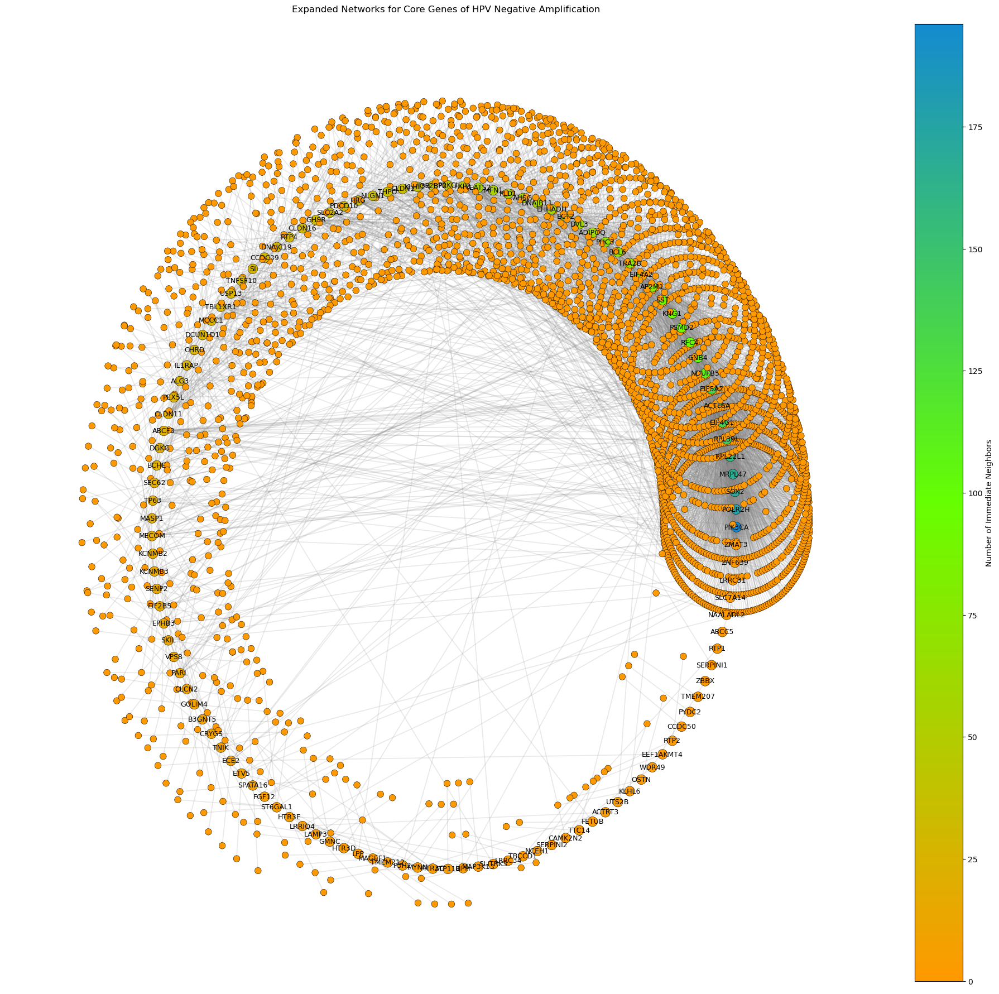

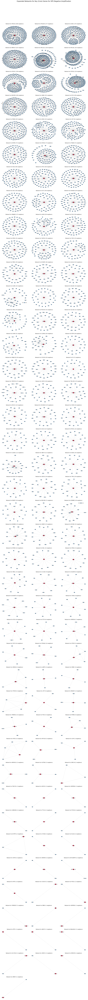

In [107]:
top_genes_and_neighbors_plotting(hpv_negative_amplification_top_genes, section_name='HPV Negative Amplification', top_number=100)

In [108]:
drugs_connected_top_genes_and_neighbors(hpv_negative_amplification_top_genes)

Number of risk genes identified from CNV analysis: 446
Number of risk genes available in the DrugBank database: 25
Number of drugs these risk genes are connected to in the DrugBank database: 82
Number of risk genes identified from CNV analysis: 446
Number of risk genes available in the PPI database: 121
Total number of immediate neighbors found through PPI: 2945
Total number of genes both risk genes and immediate neighbors in the protein interaction database: 3016
These are the top gene candidates along with the genes found to be immediate neighbors through the STRING protein interaction database.
Number of drugs these immediate neighbor genes are connected to in the DrugBank database: 3844
Total number of unique genes both risk genes and immediate neighbors in the protein interaction database: 3016
Number of drugs these genes are connected to in the DrugBank database: 3846


In [109]:
### calculate significant drug candidates using significance function
hpv_negative_amp_signficant_drug_candidates = identify_significant_drug_candidates(hpv_negative_amplification_top_genes)
top_hpv_negative_amp_signficant_drug_candidates = hpv_negative_amp_signficant_drug_candidates[hpv_negative_amp_signficant_drug_candidates['empirical_fdr'] < 0.05].copy()  # filter for significant drugs based on empirical FDR
top_hpv_negative_amp_signficant_drug_candidates = top_hpv_negative_amp_signficant_drug_candidates[top_hpv_negative_amp_signficant_drug_candidates['hypergeom_fdr'] < 0.05]
print(f"Number of significant drug candidates identified: {top_hpv_negative_amp_signficant_drug_candidates.shape[0]}")

Total number of genes both risk genes and immediate neighbors in the protein interaction database: 3016
Total number of top genes identified as risk genes from CNV analysis: 446
Number of risk genes available in the PPI database: 121
Total number of immediate neighbors found through PPI: 2945
These are the top gene candidates along with the genes found to be immediate neighbors through the STRING protein interaction database.
---- Risk genes stats ----
Total number of risk genes identified from CNV analysis: 446
Of which 25 are found in DrugBank.
these connect to 82 unique drugs in DrugBank.
---- Neighboors stats ----
Total number of risk genes identified in DrugBank after connecting to PPI: 886
These are connected to 3866 unique drugs in DrugBank.
Of which 22 are HNC approved medications.
---- Altogether stats (risk genes + immediate neighbors) ----
Of which 886 are found in DrugBank.
these connect to 3866 unique drugs in DrugBank.


Running permutations for empirical p-values: 100%|██████████| 100000/100000 [03:27<00:00, 481.65it/s]



Universe size M=4150, risk set size n=886, drugs tested=9368
Permutation-significant (empirical FDR < 0.05): 62

Number of significant drug candidates identified: 62


In [110]:
top_hpv_negative_amp_signficant_drug_candidates.sort_values(by = ['empirical_fdr', 'hypergeom_fdr'], ascending = [True, True]).reset_index(drop=True).head(20)

,drug,targets_in_drugbank,overlap_with_my_genes,a_inRisk_inDrug,b_notRisk_inDrug,c_inRisk_notDrug,d_notRisk_notDrug,expected_overlap,fold_enrichment,hypergeom_p_value,hypergeom_fdr,empirical_p_value,empirical_fdr,baseline_prob_ge2,proportion_of_targets_in_risk_set
0,Zinc chloride,97,52,52,45,834,3219,20.708916,2.510996,1.720258e-12,8.057690e-09,0.00001,0.002755,1.00000,0.536082
1,"Zinc sulfate, unspecified form",97,52,52,45,834,3219,20.708916,2.510996,1.720258e-12,8.057690e-09,0.00001,0.002755,1.00000,0.536082
2,Zinc,124,58,58,66,828,3198,26.473253,2.190891,1.343064e-10,3.145457e-07,0.00001,0.002755,1.00000,0.467742
3,Zinc acetate,124,58,58,66,828,3198,26.473253,2.190891,1.343064e-10,3.145457e-07,0.00001,0.002755,1.00000,0.467742
4,"(3AR,6R,6AS)-6-((S)-((S)-CYCLOHEX-2-ENYL)(HYDR...",14,14,14,0,872,3264,2.988916,4.683973,3.767888e-10,6.956559e-07,0.00001,0.002755,0.83617,1.000000
5,Copper,146,64,64,82,822,3182,31.170120,2.053248,4.455524e-10,6.956559e-07,0.00001,0.002755,1.00000,0.438356
6,Regorafenib,18,16,16,2,870,3262,3.842892,4.163531,1.646676e-09,2.014408e-06,0.00001,0.002755,0.92359,0.888889
7,Fostamatinib,299,107,107,192,779,3072,63.834699,1.676204,1.720246e-09,2.014408e-06,0.00001,0.002755,1.00000,0.357860
8,Ponatinib,15,14,14,1,872,3263,3.202410,4.371708,4.539686e-09,4.725309e-06,0.00001,0.002755,0.86266,0.933333
9,Nintedanib,12,12,12,0,874,3264,2.561928,4.683973,8.453730e-09,7.919454e-06,0.00001,0.002755,0.76201,1.000000


In [111]:
cancer_medications = [
    'bevacizumab', 'cetuximab', 'cisplatin', 'carboplatin', 'docetaxel', 'paclitaxel', 
    '5-fluorouracil', 'methotrexate', 'doxorubicin', 'cyclophosphamide', 'ifosfamide', 
    'etoposide', 'gemcitabine', 'irinotecan', 'oxaliplatin', 'temozolomide', 'vincristine', 
    'vinblastine', 'bleomycin', 'mitomycin', 'topotecan', 'capecitabine', 'pemetrexed', 
    'sunitinib', 'sorafenib', 'imatinib', 'erlotinib', 'gefitinib', 'lapatinib', 
    'trastuzumab', 'rituximab', 'alemtuzumab', 'bortezomib', 'lenalidomide', 'thalidomide',
    'temsirolimus', 'everolimus', 'abiraterone', 'enzalutamide', 'apalutamide', 'olaparib', 'niraparib',
    'rucaparib', 'talazoparib', 'pazopanib', 'axitinib', 'cabozantinib', 'vandetanib', 'crizotinib',
    'alectinib', 'brigatinib', 'lorlatinib', 'ceritinib', 'dabrafenib', 'trametinib', 'vemurafenib',
    'cobimetinib', 'binimetinib', 'ipilimumab', 'nivolumab', 'pembrolizumab', 'atezolizumab', 'durvalumab',
    'avelumab', 'nivolumab', 'cemiplimab', 'tivozanib', 'lenvatinib', 'regorafenib', 'ramucirumab',
    'trastuzumab emtansine', 'trastuzumab deruxtecan', 'polatuzumab vedotin', 'brentuximab vedotin',
    'inotuzumab ozogamicin', 'moxetumomab pasudotox', 'tagraxofusp', 'belantamab mafodotin']

In [112]:
for med in top_hpv_negative_amp_signficant_drug_candidates['drug'].values:
    if str.lower(med) in cancer_medications:
        print(f"Cancer medication {med} found in significant drug candidates.")

Cancer medication Sorafenib found in significant drug candidates.
Cancer medication Sunitinib found in significant drug candidates.
Cancer medication Regorafenib found in significant drug candidates.
Cancer medication Lenvatinib found in significant drug candidates.
Cancer medication Tivozanib found in significant drug candidates.
Cancer medication Brigatinib found in significant drug candidates.
Cancer medication Pazopanib found in significant drug candidates.
Cancer medication Imatinib found in significant drug candidates.


Total number of genes in the direct drug gene interaction database: 446
These are the top gene candidates identified from CNV analysis, which will be connected to drugs in the DrugBank database.


Processing top direct genes: 100%|██████████| 446/446 [00:00<00:00, 5722.05it/s]
check for approved medications: 19it [00:00, 42232.00it/s]

Number of unique drugs in the final database: 9
Number of unique genes in the final database: 9
Number of approved drugs in the final database: 0


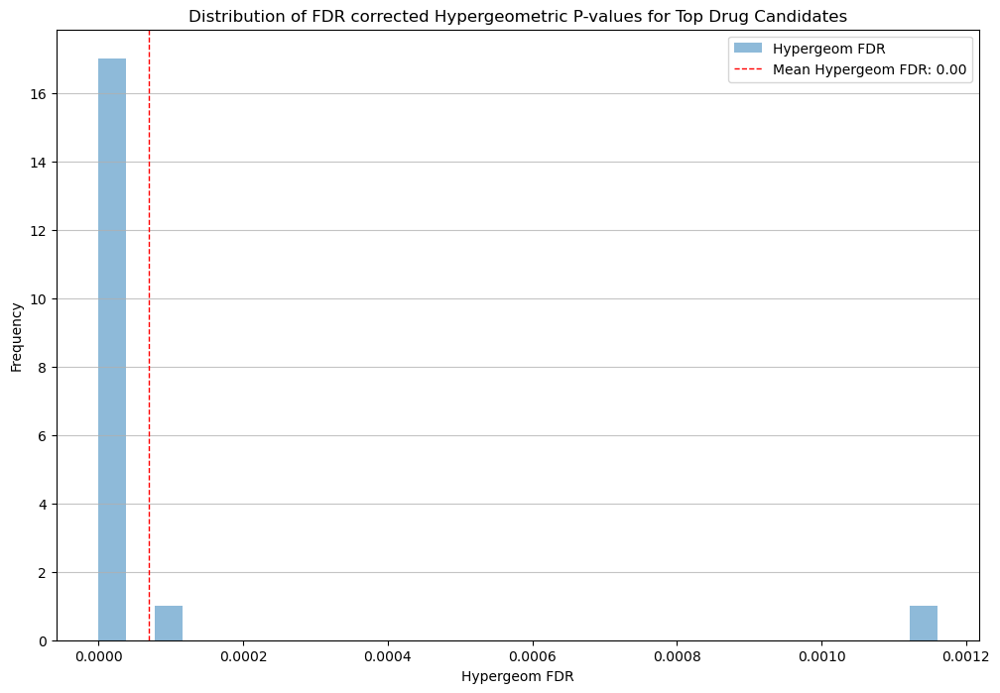

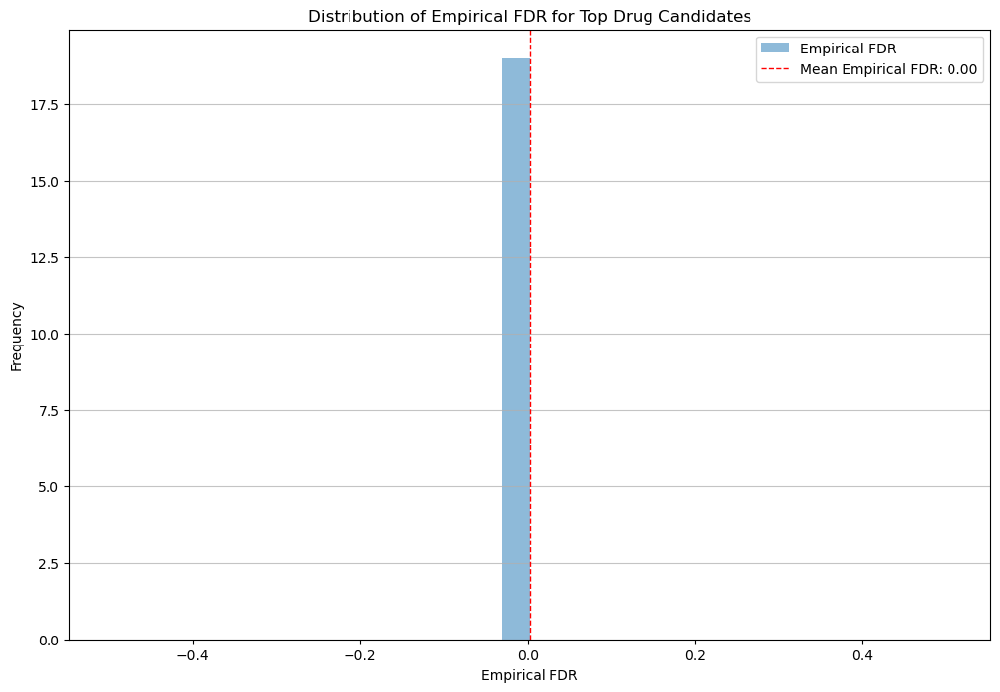

In [113]:
hpv_neg_amp_top_direct_drug_candidates = top_direct_drug_candidates(hpv_negative_amplification_top_genes, top_hpv_negative_amp_signficant_drug_candidates, plotting=True)

In [114]:
hpv_neg_amp_top_direct_drug_candidates

,GENE_TARGET,CONNECTED_TO,PPI_SCORE,DRUG,GENE_GISTIC,GENE_normalized_gistic_score,GENE_frequency_percentage,GENE_SIGNIFICANT,ACTION,SPECIFIC_FUNCTION,drug_hypergeom_p_value,drug_hypergeom_fdr,drug_empirical_p_value,drug_empirical_fdr,HNC_approved_medication
0,MAP3K13,NA,0,Fostamatinib,0.320878,0.267731,36.023445,True,inhibitor,ATP binding,1.720246e-09,2.014408e-06,0.00001,0.002755,False
1,HRG,NA,0,Zinc chloride,0.319852,0.240737,35.888188,True,cofactor,cysteine-type endopeptidase inhibitor activity,1.720258e-12,8.057690e-09,0.00001,0.002755,False
2,HRG,NA,0,"Zinc sulfate, unspecified form",0.319852,0.240737,35.888188,True,cofactor,cysteine-type endopeptidase inhibitor activity,1.720258e-12,8.057690e-09,0.00001,0.002755,False
3,MCCC1,NA,0,Biotin,0.335424,0.650309,37.060415,True,cofactor,ATP binding,4.209720e-06,1.159902e-03,0.00001,0.002755,False
4,NDUFB5,NA,0,NADH,0.332336,0.569090,36.789901,True,NaN,NADH dehydrogenase (ubiquinone) activity,4.673054e-08,3.648098e-05,0.00001,0.002755,False
5,EHHADH,NA,0,NADH,0.320878,0.267731,36.023445,True,NaN,3-hydroxyacyl-CoA dehydratase activity,4.673054e-08,3.648098e-05,0.00001,0.002755,False
6,TNIK,NA,0,Fostamatinib,0.325538,0.390298,36.429216,True,inhibitor,ATP binding,1.720246e-09,2.014408e-06,0.00001,0.002755,False
7,KNG1,NA,0,Zinc,0.319971,0.243874,35.888188,True,NaN,cysteine-type endopeptidase inhibitor activity,1.343064e-10,3.145457e-07,0.00001,0.002755,False
8,KNG1,NA,0,Copper,0.319971,0.243874,35.888188,True,NaN,cysteine-type endopeptidase inhibitor activity,4.455524e-10,6.956559e-07,0.00001,0.002755,False
9,KNG1,NA,0,Zinc acetate,0.319971,0.243874,35.888188,True,NaN,cysteine-type endopeptidase inhibitor activity,1.343064e-10,3.145457e-07,0.00001,0.002755,False


In [115]:
hpv_neg_amp_top_direct_drug_candidates['GENE_TARGET'].unique()

array(['MAP3K13', 'HRG', 'MCCC1', 'NDUFB5', 'EHHADH', 'TNIK', 'KNG1',
       'AHSG', 'PRKCI'], dtype=object)

In [116]:
### aggregate top direct drug candidates
hpv_neg_amp_top_direct_drug_candidates_agg = agg_top_direct_drug_candidates(hpv_neg_amp_top_direct_drug_candidates)

In [117]:
hpv_neg_amp_top_direct_drug_candidates_agg

,DRUG,NUM_DIRECT_TARGETS_HIT,TOTAL_TARGETS_IN_DRUGBANK,PERCENTAGE_OF_TARGETS_HIT,GENE_TARGET,GENE_GISTIC,GENE_normalized_gistic_score,ACTION,SPECIFIC_FUNCTION,drug_hypergeom_p_value,drug_hypergeom_fdr,drug_empirical_p_value,drug_empirical_fdr
17,Biotin,1,8,12.500000,MCCC1,0.335424,0.650309,cofactor,ATP binding,4.209720e-06,1.159902e-03,0.00001,0.002755
18,Bisindolylmaleimide I,1,19,5.263158,PRKCI,0.324410,0.360631,NaN,ATP binding,1.278605e-07,7.985313e-05,0.00001,0.002755
0,Zinc chloride,3,97,3.092784,HRG,0.319852,0.240737,cofactor,cysteine-type endopeptidase inhibitor activity,1.720258e-12,8.057690e-09,0.00001,0.002755
1,"Zinc sulfate, unspecified form",3,97,3.092784,HRG,0.319852,0.240737,cofactor,cysteine-type endopeptidase inhibitor activity,1.720258e-12,8.057690e-09,0.00001,0.002755
2,Zinc chloride,3,97,3.092784,KNG1,0.319971,0.243874,cofactor,cysteine-type endopeptidase inhibitor activity,1.720258e-12,8.057690e-09,0.00001,0.002755
3,"Zinc sulfate, unspecified form",3,97,3.092784,KNG1,0.319971,0.243874,cofactor,cysteine-type endopeptidase inhibitor activity,1.720258e-12,8.057690e-09,0.00001,0.002755
4,Zinc chloride,3,97,3.092784,AHSG,0.319946,0.243227,chelator,cysteine-type endopeptidase inhibitor activity,1.720258e-12,8.057690e-09,0.00001,0.002755
5,"Zinc sulfate, unspecified form",3,97,3.092784,AHSG,0.319946,0.243227,chelator,cysteine-type endopeptidase inhibitor activity,1.720258e-12,8.057690e-09,0.00001,0.002755
9,Zinc,2,124,1.612903,KNG1,0.319971,0.243874,NaN,cysteine-type endopeptidase inhibitor activity,1.343064e-10,3.145457e-07,0.00001,0.002755
10,Zinc acetate,2,124,1.612903,KNG1,0.319971,0.243874,NaN,cysteine-type endopeptidase inhibitor activity,1.343064e-10,3.145457e-07,0.00001,0.002755


Total number of genes both risk genes and immediate neighbors in the protein interaction database: 3016
Total number of top genes identified as risk genes from CNV analysis: 446
Number of risk genes available in the PPI database: 121
Total number of immediate neighbors found through PPI: 2945
These are the top gene candidates along with the genes found to be immediate neighbors through the STRING protein interaction database.


Processing connected genes: 4080it [00:03, 1060.95it/s]
check for approved medications: 1697it [00:00, 64753.77it/s]

Number of unique genes in indirect hits: 432
Number of unique drugs in indirect hits: 62
Number of approved medications identified: 0


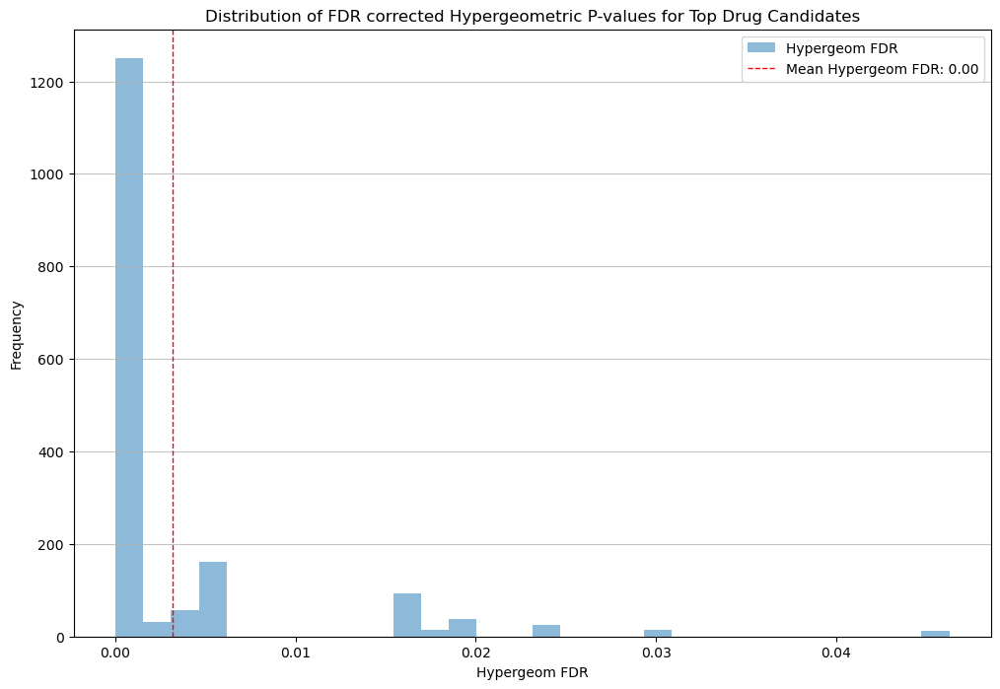

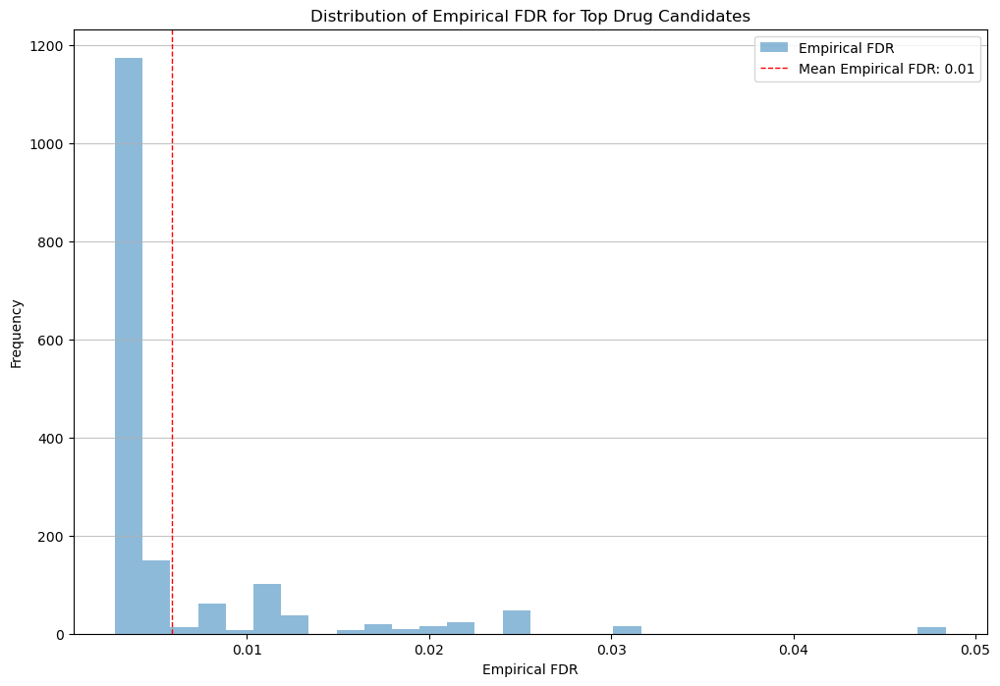

In [118]:
hpv_neg_amp_top_indirect_drug_candidates = top_indirect_drug_candidates(hpv_negative_amplification_top_genes, top_hpv_negative_amp_signficant_drug_candidates, plotting=True)

In [119]:
hpv_neg_amp_top_indirect_drug_candidates = hpv_neg_amp_top_indirect_drug_candidates[hpv_neg_amp_top_indirect_drug_candidates['DRUG'] != 'Zinc sulfate, unspecified form']  # remove rows where drug is 'Zinc sulfate, unspecified form'

In [120]:
hpv_neg_amp_top_indirect_drug_candidates['GENE_TARGET'].unique()

array(['BMPR2', 'ALDH3A2', 'HADHA', 'ACACB', 'HIBCH', 'HSD17B10',
       'ALDH9A1', 'MCCC1', 'PCCB', 'PCCA', 'ALDH6A1', 'ACADS', 'MCCC2',
       'HIBADH', 'ALDH7A1', 'ALDH1B1', 'HSD17B4', 'ALDH2', 'KNG1', 'FGA',
       'SERPINF2', 'AHSG', 'APOH', 'F13B', 'SERPINC1', 'PLAT', 'APOB',
       'SERPIND1', 'F12', 'AZGP1', 'APCS', 'VTN', 'ALB', 'AFM',
       'SERPINA1', 'APOA1', 'PLG', 'C3', 'A2M', 'F10', 'ITIH4', 'F2',
       'OPRM1', 'MAPK13', 'HTR1D', 'HTR1A', 'HTR7', 'PIK3R1', 'PRKCA',
       'DRD4', 'GPBAR1', 'HTR1F', 'PRKCG', 'PRKACA', 'MAPK11', 'MAPK1',
       'HTR1B', 'HTR1E', 'DRD2', 'MAPK12', 'DRD3', 'PRKCB', 'MAPK14',
       'PRKCE', 'CHRM2', 'PRKACB', 'CYCS', 'RIPK1', 'TNF', 'MT-CO3',
       'NDUFA8', 'COX6B1', 'UQCR11', 'NDUFS5', 'NDUFS2', 'UQCR10',
       'NDUFA2', 'UQCRH', 'NDUFB10', 'NDUFV3', 'NDUFS7', 'NDUFB1', 'SDHD',
       'COX7C', 'NDUFB4', 'COX7A1', 'NDUFB6', 'PSMA3', 'NDUFS8',
       'NDUFA10', 'NDUFB7', 'NDUFA11', 'NDUFA1', 'COX4I1', 'CYC1',
       'UQCRC2', 'COX6C', '

In [121]:
hpv_neg_amp_top_indirect_drug_candidates['DRUG'].unique()

array(['Fostamatinib', 'NADH', 'Biotin', 'Quercetin', 'Artenimol', 'Zinc',
       'Copper', 'Zinc acetate', 'Zinc chloride', 'Heparin',
       'Human C1-esterase inhibitor', 'Conestat alfa', 'Somatostatin',
       'Clozapine', 'Rizatriptan', 'Quetiapine', 'Aripiprazole lauroxil',
       'Enzastaurin', 'Tetrabromo-2-Benzotriazole', 'Midostaurin',
       'CI-1040', 'Cholic Acid', 'Bisindolylmaleimide I', 'Regorafenib',
       'PD-166326', 'Trihexyphenidyl', 'Polaprezinc',
       '6-Hydroxy-5-undecyl-4,7-benzothiazoledione', 'Azoxystrobin',
       '(5S)-3-ANILINO-5-(2,4-DIFLUOROPHENYL)-5-METHYL-1,3-OXAZOLIDINE-2,4-DIONE',
       '(S)-famoxadone',
       'METHYL (2Z)-3-METHOXY-2-{2-[(E)-2-PHENYLVINYL]PHENYL}ACRYLATE',
       'Ubiquinone Q2',
       '2-Hexyloxy-6-Hydroxymethyl-Tetrahydro-Pyran-3,4,5-Triol',
       '(3AR,6R,6AS)-6-((S)-((S)-CYCLOHEX-2-ENYL)(HYDROXY)METHYL)-6A-METHYL-4-OXO-HEXAHYDRO-2H-FURO[3,2-C]PYRROLE-6-CARBALDEHYDE',
       'Imatinib', 'Brigatinib', 'PP-121', 'Sorafenib',

In [122]:
# hpv_neg_amp_top_indirect_drug_candidates[~hpv_neg_amp_top_indirect_drug_candidates['DRUG'].isin(['Zinc chloride', 'Zinc', 'Zinc acetate', 
#                                                                                                  'Copper',
#                                                                                                  '(3AR,6R,6AS)-6-((S)-((S)-CYCLOHEX-2-ENYL)(HYDROXY)METHYL)-6A-METHYL-4-OXO-HEXAHYDRO-2H-FURO[3,2-C]PYRROLE-6-CARBALDEHYDE'])].sort_values(by=['drug_hypergeom_fdr', 'drug_empirical_fdr'], ascending=[True, True]).reset_index(drop=True).head(50)

In [123]:
hpv_neg_amp_top_indirect_drug_candidates['DIRECT'] = False * len(hpv_neg_amp_top_indirect_drug_candidates)
hpv_neg_amp_top_direct_drug_candidates['DIRECT'] = True * len(hpv_neg_amp_top_direct_drug_candidates)
hpv_neg_top_amp_top_candidates = pd.concat([hpv_neg_amp_top_indirect_drug_candidates, hpv_neg_amp_top_direct_drug_candidates], axis=0)
hpv_neg_top_amp_top_candidates.to_csv('Results/hpv_neg_amp_top_drugBank_drug_candidates.csv', index=False)

In [124]:
### aggregate top indirect drug candidates
hpv_neg_amp_top_indirect_drug_candidates_agg = agg_top_indirect_drug_candidates(hpv_neg_amp_top_indirect_drug_candidates)

/var/folders/5p/swntgnbj3fbfxkx02kt3fq980000gn/T/ipykernel_51208/318329654.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_indirect_drug_candidates['num_genes_targeted'] = top_indirect_drug_candidates.groupby('DRUG')['GENE_TARGET'].transform('nunique')


In [125]:
hpv_neg_amp_top_indirect_drug_candidates_agg['DRUG'].unique()

array(['artenimol', 'biotin', 'fostamatinib', 'nintedanib', 'sorafenib',
       'erdafitinib', 'lenvatinib', 'brigatinib', 'pd-166326',
       'sunitinib', 'lucitanib', 'famitinib', 'midostaurin',
       'selpercatinib', 'linifanib', 'ripretinib', 'amuvatinib',
       'ponatinib', 'pralsetinib', 'tivozanib', 'pp-121', 'pazopanib',
       'regorafenib', 'semaxanib', 'enzastaurin', 'bisindolylmaleimide i',
       'ci-1040', 'imatinib', 'tetrabromo-2-benzotriazole',
       'zanubrutinib', 'quercetin', 'somatostatin', 'trihexyphenidyl',
       'rizatriptan', 'quetiapine', 'aripiprazole lauroxil', 'clozapine',
       'martinostat', 'nadh', 'cholic acid', 'heparin', 'conestat alfa',
       'human c1-esterase inhibitor', 'carfilzomib'], dtype=object)

In [126]:
hpv_neg_amp_top_indirect_drug_candidates_agg.head(50)

,DRUG,CONNECTED_TO (risk gene),Number of risk or immediate neighbor genes targeted,total_genes_targeted_in_drugbank,PERCENTAGE_OF_TARGETS_HIT,Number of indirect genes connected to this risk gene,GENE_TARGET,GENE_GISTIC,GENE_normalized_gistic_score,GENE_frequency_percentage,ACTION,SPECIFIC_FUNCTION,drug_hypergeom_fdr,drug_empirical_fdr
23,artenimol,FXR1,40,104,38.461538,2,"HNRNPK, DDX5",0.335514,0.652695,37.015329,ligand,"cadherin binding, ATP binding",0.004881,0.011710
38,biotin,MCCC1,8,8,100.000000,3,"ACACA, HLCS, PC",0.335424,0.650309,37.060415,"cofactor, substrate","acetyl-CoA carboxylase activity, ATP binding",0.001160,0.002755
84,fostamatinib,KCNMB3,105,299,35.117057,1,PRKG2,0.335133,0.642680,37.015329,inhibitor,ATP binding,0.000002,0.002755
124,nintedanib,PIK3CA,12,12,100.000000,12,"FGFR1, FGFR3, SRC, KDR, PDGFRB, LCK, FLT1, PDG...",0.335096,0.641704,37.015329,inhibitor,ATP binding,0.000008,0.002755
162,sorafenib,PIK3CA,11,11,100.000000,11,"RAF1, FGFR1, KDR, PDGFRB, EGFR, FLT1, BRAF, KI...",0.335096,0.641704,37.015329,"inhibitor, antagonist","ATP binding, actin filament binding",0.000034,0.002755
70,erdafitinib,PIK3CA,10,10,100.000000,10,"FGFR1, FGFR4, FGFR3, KDR, PDGFRB, KIT, CSF1R, ...",0.335096,0.641704,37.015329,"inhibitor, substrate",ATP binding,0.000080,0.002755
111,lenvatinib,PIK3CA,10,10,100.000000,10,"FGFR1, FGFR4, FGFR3, KDR, FLT1, KIT, RET, PDGF...",0.335096,0.641704,37.015329,inhibitor,ATP binding,0.000080,0.002755
46,brigatinib,PIK3CA,9,9,100.000000,9,"IGF1R, MET, ALK, ERBB4, INSR, EGFR, ABL1, ERBB...",0.335096,0.641704,37.015329,"inhibitor, binding","ATP binding, amyloid-beta binding, actin filam...",0.000322,0.002755
126,pd-166326,PIK3CA,9,9,100.000000,8,"FGFR1, SRC, PDGFRB, LCK, EGFR, KIT, ABL1, PDGFRA",0.335096,0.641704,37.015329,inhibitor,"ATP binding, actin filament binding",0.000322,0.002755
163,sunitinib,PIK3CA,9,9,100.000000,9,"MET, KDR, PDGFRB, FLT1, KIT, CSF1R, PDGFRA, FL...",0.335096,0.641704,37.015329,inhibitor,ATP binding,0.000322,0.002755


In [127]:
hpv_neg_amp_top_indirect_drug_candidates_agg.iloc[50:66]

,DRUG,CONNECTED_TO (risk gene),Number of risk or immediate neighbor genes targeted,total_genes_targeted_in_drugbank,PERCENTAGE_OF_TARGETS_HIT,Number of indirect genes connected to this risk gene,GENE_TARGET,GENE_GISTIC,GENE_normalized_gistic_score,GENE_frequency_percentage,ACTION,SPECIFIC_FUNCTION,drug_hypergeom_fdr,drug_empirical_fdr
110,imatinib,USP13,8,11,72.727273,1,MCL1,0.332359,0.569702,36.789901,other/unknown,BH domain binding,0.046272,0.048350
122,nadh,NDUFB5,58,144,40.277778,44,"NDUFA8, NDUFS5, NDUFS2, NDUFA2, NDUFB10, NDUFV...",0.332336,0.569090,36.789901,binder,"NADH dehydrogenase (ubiquinone) activity, 4 ir...",0.000036,0.002755
26,artenimol,NDUFB5,40,104,38.461538,3,"ATP5F1A, ATP5MG, ATP5PO",0.332336,0.569090,36.789901,ligand,"ADP binding, proton transmembrane transporter ...",0.004881,0.011710
45,bisindolylmaleimide i,SOX2,15,19,78.947368,1,CDK1,0.331009,0.534184,36.654644,inhibitor,ATP binding,0.000080,0.002755
33,artenimol,SOX2,40,104,38.461538,1,GAPDH,0.331009,0.534184,36.654644,ligand,aspartic-type endopeptidase inhibitor activity,0.004881,0.011710
96,fostamatinib,SOX2,105,299,35.117057,1,CDK1,0.331009,0.534184,36.654644,inhibitor,ATP binding,0.000002,0.002755
34,artenimol,TNFSF10,40,104,38.461538,1,CYCS,0.329096,0.483872,36.564472,ligand,electron transfer activity,0.004881,0.011710
98,fostamatinib,TNFSF10,105,299,35.117057,1,RIPK1,0.329096,0.483872,36.564472,inhibitor,ATP binding,0.000002,0.002755
57,cholic acid,PLD1,16,22,72.727273,1,PLA2G1B,0.328912,0.479029,36.609558,inhibitor,bile acid binding,0.000136,0.002755
141,quercetin,PLD1,19,32,59.375000,2,"LPCAT1, LPCAT2",0.328912,0.479029,36.609558,inhibitor,1-acylglycerol-3-phosphate O-acyltransferase a...,0.000915,0.002755


#### Del

In [128]:
display_top_genes(hpv_negative_deletion_top_genes)

,gene,gene_name,Sample_size,deletion_count,Deletion_sum (i.e. total deletion CNV count across samples),Deletion_sum_prevalence,frequency_percentage,gistic_score,p_value,q_value,significant,empirical_p_value,empirical_q_value,empirical_significant,chromosome,start,end,coverage_percentage
28,ENSG00000147889.18,CDKN2A,2218,536,-1533,0.691163,24.165915,0.167026,1.677258e-204,1.640007e-201,True,0.000999,0.020412,True,chr9,21967752,21995301,0.019907
295,ENSG00000147883.12,CDKN2B,2218,524,-1512,0.681695,23.624887,0.161050,3.454177e-195,6.584986e-193,True,0.000999,0.020412,True,chr9,22002903,22009305,0.004627
6,ENSG00000242875.6,RBMY1B,2218,538,-1170,0.527502,24.256087,0.127951,4.542668e-206,1.376951e-202,True,0.000999,0.020412,True,chrY,21511338,21549094,0.065977
17,ENSG00000234414.7,RBMY1A1,2218,538,-1170,0.527502,24.256087,0.127951,4.542668e-206,1.376951e-202,True,0.000999,0.020412,True,chrY,21511372,21549326,0.066323
26,ENSG00000198692.10,EIF1AY,2218,536,-1168,0.526601,24.165915,0.127258,1.677258e-204,1.640007e-201,True,0.000999,0.020412,True,chrY,20575776,20593154,0.030368
32,ENSG00000280969.2,RPS4Y2,2218,536,-1168,0.526601,24.165915,0.127258,1.677258e-204,1.640007e-201,True,0.000999,0.020412,True,chrY,20756108,20781032,0.043554
43,ENSG00000012817.16,KDM5D,2218,536,-1168,0.526601,24.165915,0.127258,1.677258e-204,1.640007e-201,True,0.000999,0.020412,True,chrY,19703865,19744939,0.071775
50,ENSG00000169807.10,PRY2,2218,536,-1168,0.526601,24.165915,0.127258,1.677258e-204,1.640007e-201,True,0.000999,0.020412,True,chrY,22071756,22096007,0.042378
52,ENSG00000242389.8,RBMY1E,2218,536,-1168,0.526601,24.165915,0.127258,1.677258e-204,1.640007e-201,True,0.000999,0.020412,True,chrY,21903618,21918067,0.025250
58,ENSG00000169800.14,RBMY1F,2218,536,-1168,0.526601,24.165915,0.127258,1.677258e-204,1.640007e-201,True,0.000999,0.020412,True,chrY,22168542,22182982,0.025234


In [129]:
display_top_genes_and_neighbors(hpv_negative_deletion_top_genes)

Number of risk genes identified from CNV analysis: 318
Number of risk genes available in the PPI database: 27
Total number of immediate neighbors found through PPI: 460
Total number of genes both risk genes and immediate neighbors in the protein interaction database: 461
These are the top gene candidates along with the genes found to be immediate neighbors through the STRING protein interaction database.


,Translated_protein_1,gene_name,Translated_protein_2,Number_of_Immediate_Neighbors,gistic_score,q_value,empirical_q_value,frequency_percentage,significant
3,CDKN2A,CDKN2A,"DNMT3B, CCNL2, GGA3, MGMT, CDK1, CDKN2D, RASA1...",145,0.167026,1.640007e-201,0.020412,24.165915,True
4,CDKN2B,CDKN2B,"CDKN2A, SP1, CDKAL1, MDM2, CDKN1C, CCND2, CDKN...",25,0.161050,6.584986e-193,0.020412,23.624887,True
20,RBMY1A1,RBMY1A1,"RBMY1E, PRY2, BPY2B, PRYP3, HNRNPK, CDY1, ZNF3...",21,0.127951,1.376951e-202,0.020412,24.256087,True
21,RBMY1B,RBMY1B,"RBMY1A1, TSPY9P, TSPY4, RBMY1E, TSPY2, RBMY1D",6,0.127951,1.376951e-202,0.020412,24.256087,True
13,EIF1AY,EIF1AY,"MRPL3, SPDYE11, RPS16, RPS12, RPL5, WDR31, RPS...",147,0.127258,1.640007e-201,0.020412,24.165915,True
15,KDM5D,KDM5D,"NLGN4Y, AR, TMSB4Y, ATP5PO, EIF2S3, ATP5PB, AT...",27,0.127258,1.640007e-201,0.020412,24.165915,True
18,PRY2,PRY2,"DAZ3, RBMY1A1, VCY1B, RBMY1D, TRIM25, USP9Y, T...",21,0.127258,1.640007e-201,0.020412,24.165915,True
22,RBMY1D,RBMY1D,"BPY2B, PRYP3, RBMY1A1, RBMY1E, PRY2, BPY2C, CD...",13,0.127258,1.640007e-201,0.020412,24.165915,True
23,RBMY1E,RBMY1E,"TSPY8, RBMY1B, RBMY1A1, RBMY1D",4,0.127258,1.640007e-201,0.020412,24.165915,True
24,RBMY1F,RBMY1F,"BPY2, UTY, USP9Y, PRY, DDX3Y, PRY2, PRYP3, BPY...",10,0.127258,1.640007e-201,0.020412,24.165915,True


Number of risk genes identified from CNV analysis: 318
Number of risk genes available in the PPI database: 27
Total number of immediate neighbors found through PPI: 460
Total number of genes both risk genes and immediate neighbors in the protein interaction database: 461
These are the top gene candidates along with the genes found to be immediate neighbors through the STRING protein interaction database.


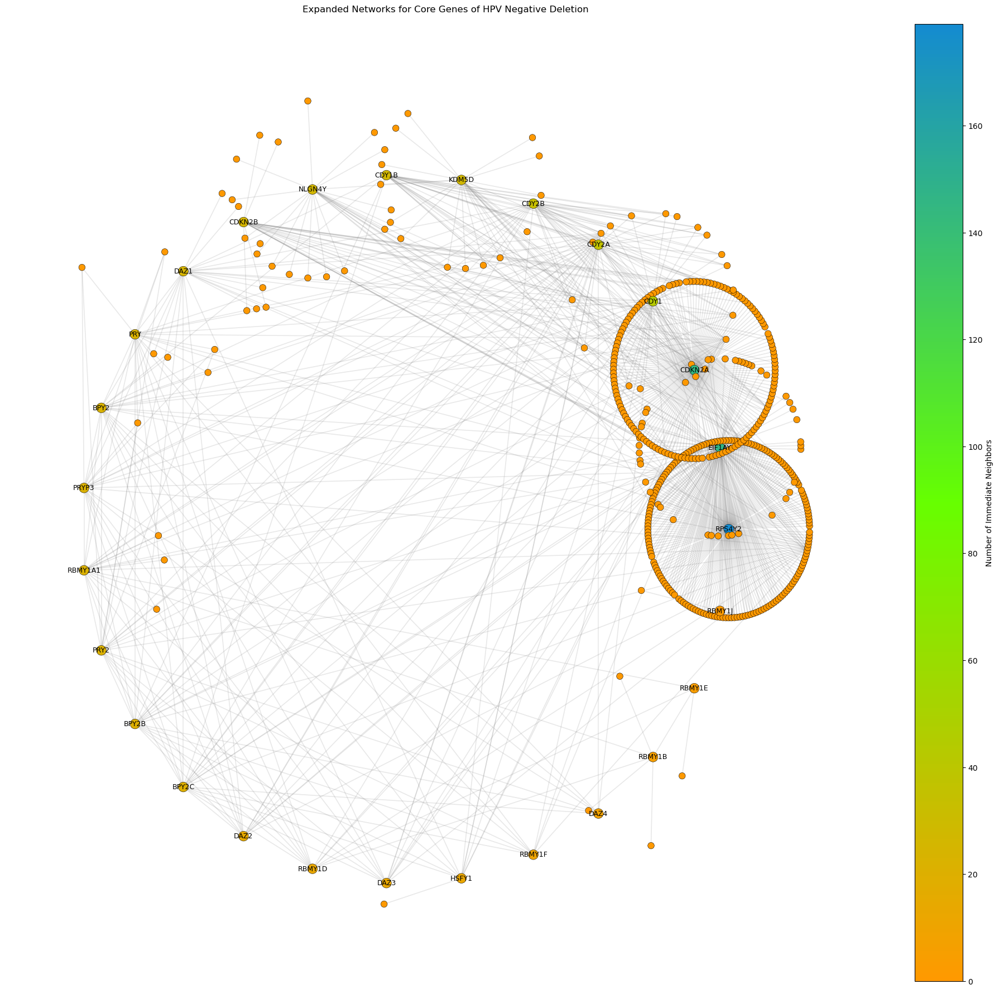

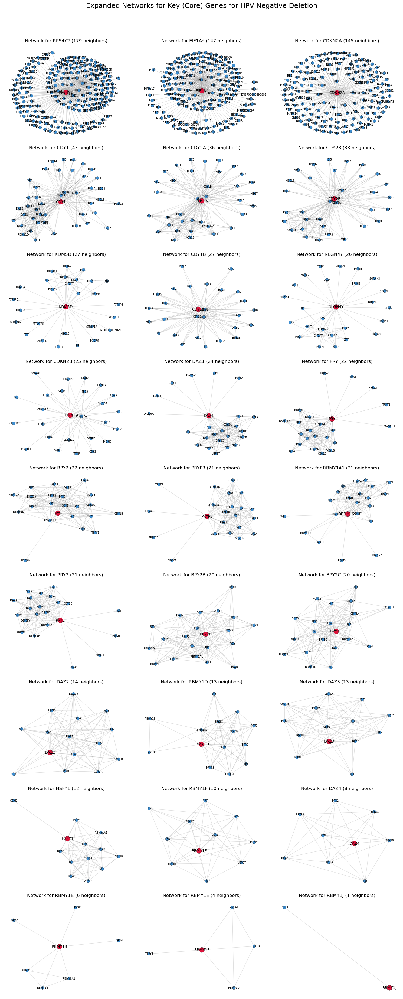

In [130]:
top_genes_and_neighbors_plotting(hpv_negative_deletion_top_genes, section_name='HPV Negative Deletion', top_number=100)

In [131]:
drugs_connected_top_genes_and_neighbors(hpv_negative_deletion_top_genes)

Number of risk genes identified from CNV analysis: 318
Number of risk genes available in the DrugBank database: 1
Number of drugs these risk genes are connected to in the DrugBank database: 1
Number of risk genes identified from CNV analysis: 318
Number of risk genes available in the PPI database: 27
Total number of immediate neighbors found through PPI: 460
Total number of genes both risk genes and immediate neighbors in the protein interaction database: 461
These are the top gene candidates along with the genes found to be immediate neighbors through the STRING protein interaction database.
Number of drugs these immediate neighbor genes are connected to in the DrugBank database: 907
Total number of unique genes both risk genes and immediate neighbors in the protein interaction database: 461
Number of drugs these genes are connected to in the DrugBank database: 907


In [132]:
### calculate significant drug candidates using significance function
hpv_negative_del_significant_drug_candidates = identify_significant_drug_candidates(hpv_negative_deletion_top_genes)
top_hpv_negative_del_significant_drug_candidates = hpv_negative_del_significant_drug_candidates[hpv_negative_del_significant_drug_candidates['empirical_fdr'] < 0.05].copy()
top_hpv_negative_del_significant_drug_candidates = top_hpv_negative_del_significant_drug_candidates[top_hpv_negative_del_significant_drug_candidates['hypergeom_fdr'] < 0.05]
print(f"Number of significant drug candidates identified: {top_hpv_negative_del_significant_drug_candidates.shape[0]}")

Total number of genes both risk genes and immediate neighbors in the protein interaction database: 461
Total number of top genes identified as risk genes from CNV analysis: 318
Number of risk genes available in the PPI database: 27
Total number of immediate neighbors found through PPI: 460
These are the top gene candidates along with the genes found to be immediate neighbors through the STRING protein interaction database.
---- Risk genes stats ----
Total number of risk genes identified from CNV analysis: 318
Of which 1 are found in DrugBank.
these connect to 1 unique drugs in DrugBank.
---- Neighboors stats ----
Total number of risk genes identified in DrugBank after connecting to PPI: 127
These are connected to 908 unique drugs in DrugBank.
Of which 10 are HNC approved medications.
---- Altogether stats (risk genes + immediate neighbors) ----
Of which 127 are found in DrugBank.
these connect to 908 unique drugs in DrugBank.


Running permutations for empirical p-values: 100%|██████████| 100000/100000 [02:52<00:00, 579.35it/s]



Universe size M=4150, risk set size n=127, drugs tested=9368
Permutation-significant (empirical FDR < 0.05): 29

Number of significant drug candidates identified: 29


In [133]:
top_hpv_negative_del_significant_drug_candidates.sort_values(by=['empirical_fdr', 'hypergeom_fdr']).head(20)

,drug,targets_in_drugbank,overlap_with_my_genes,a_inRisk_inDrug,b_notRisk_inDrug,c_inRisk_notDrug,d_notRisk_notDrug,expected_overlap,fold_enrichment,hypergeom_p_value,hypergeom_fdr,empirical_p_value,empirical_fdr,baseline_prob_ge2,proportion_of_targets_in_risk_set
9,Anisomycin,13,12,12,1,115,4022,0.397831,30.163537,5.079293e-18,4.758281e-14,0.00001,0.006691,0.05843,0.923077
2,(S)-3-phenyllactic acid,15,12,12,3,115,4020,0.459036,26.141732,1.687703e-16,7.905199e-13,0.00001,0.006691,0.07591,0.800000
10,Puromycin,13,11,11,2,116,4021,0.397831,27.649909,1.059429e-15,3.308243e-12,0.00001,0.006691,0.05847,0.846154
11,Artenimol,105,19,19,86,108,3937,3.213253,5.913011,1.780450e-10,4.169813e-07,0.00001,0.006691,0.83729,0.180952
4,Bisindolylmaleimide I,19,9,9,10,118,4013,0.581446,15.478657,1.265855e-09,2.371705e-06,0.00001,0.006691,0.11179,0.473684
12,CI-1040,15,7,7,8,120,4015,0.459036,15.249344,1.119031e-07,1.747181e-04,0.00001,0.006691,0.07429,0.466667
0,Arsenic trioxide,10,6,6,4,121,4019,0.306024,19.606299,1.387597e-07,1.857001e-04,0.00001,0.006691,0.03540,0.600000
5,Guanosine-5'-Diphosphate,52,11,11,41,116,3982,1.591325,6.912477,2.971397e-07,3.479506e-04,0.00001,0.006691,0.47636,0.211538
6,Tetrabromo-2-Benzotriazole,18,7,7,11,120,4012,0.550843,12.707787,5.124672e-07,5.334214e-04,0.00001,0.006691,0.10165,0.388889
3,Alvocidib,12,6,6,6,121,4017,0.367229,16.338583,5.804084e-07,5.437266e-04,0.00001,0.006691,0.05034,0.500000


In [134]:
'Atorvastatin' in top_hpv_negative_del_significant_drug_candidates['drug'].values

False

In [143]:
# hpv_neg_del_top_direct_drug_candidates = top_direct_drug_candidates(hpv_negative_deletion_top_genes, hpv_negative_del_significant_drug_candidates, plotting=True)

In [144]:
# hpv_neg_del_top_direct_drug_candidates

Total number of genes both risk genes and immediate neighbors in the protein interaction database: 461
Total number of top genes identified as risk genes from CNV analysis: 318
Number of risk genes available in the PPI database: 27
Total number of immediate neighbors found through PPI: 460
These are the top gene candidates along with the genes found to be immediate neighbors through the STRING protein interaction database.


Processing connected genes: 940it [00:01, 882.99it/s]
check for approved medications: 231it [00:00, 64420.49it/s]

Number of unique genes in indirect hits: 68
Number of unique drugs in indirect hits: 29
Number of approved medications identified: 0


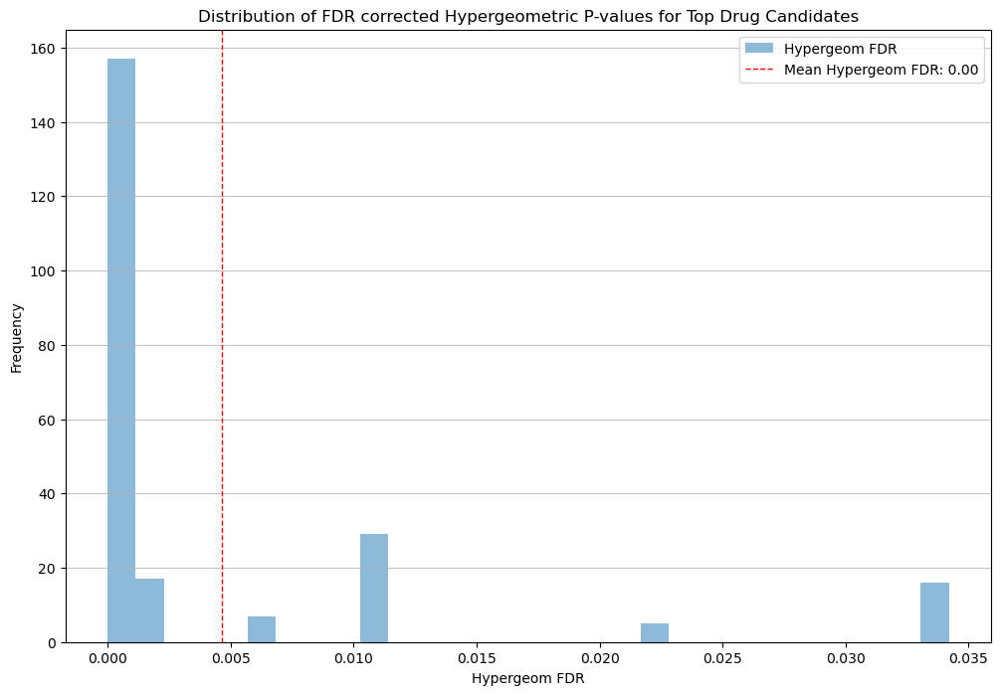

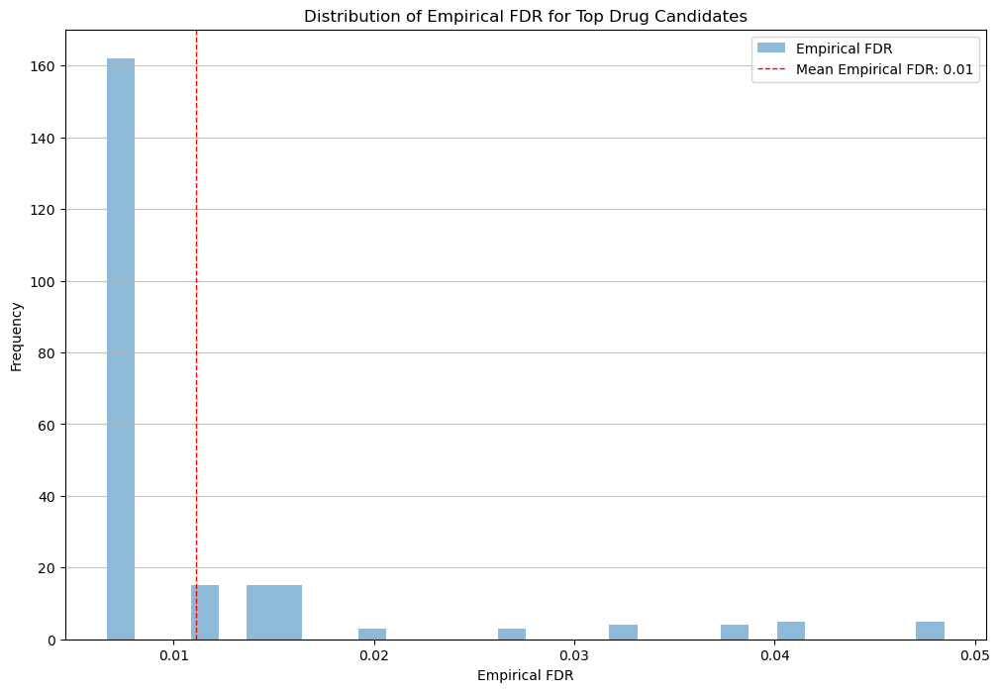

In [145]:
hpv_neg_del_top_indirect_drug_candidates = top_indirect_drug_candidates(hpv_negative_deletion_top_genes, hpv_negative_del_significant_drug_candidates, plotting=True)

In [146]:
hpv_neg_del_top_indirect_drug_candidates.sort_values(by=['drug_hypergeom_fdr', 'drug_empirical_fdr'], ascending=[True, True]).reset_index(drop=True).head(20)

,GENE_TARGET,CONNECTED_TO,PPI_SCORE,DRUG,GENE_GISTIC,GENE_normalized_gistic_score,GENE_frequency_percentage,GENE_SIGNIFICANT,ACTION,SPECIFIC_FUNCTION,drug_hypergeom_p_value,drug_hypergeom_fdr,drug_empirical_p_value,drug_empirical_fdr,HNC_approved_medication
0,RPL23,EIF1AY,884,Anisomycin,0.127258,0.126415,24.165915,True,NaN,large ribosomal subunit rRNA binding,5.079293e-18,4.758281e-14,0.00001,0.006691,False
1,RPL11,EIF1AY,889,Anisomycin,0.127258,0.126415,24.165915,True,NaN,5S rRNA binding,5.079293e-18,4.758281e-14,0.00001,0.006691,False
2,RPL8,EIF1AY,771,Anisomycin,0.127258,0.126415,24.165915,True,NaN,RNA binding,5.079293e-18,4.758281e-14,0.00001,0.006691,False
3,RPL23A,EIF1AY,844,Anisomycin,0.127258,0.126415,24.165915,True,NaN,cadherin binding,5.079293e-18,4.758281e-14,0.00001,0.006691,False
4,RPL26L1,EIF1AY,773,Anisomycin,0.127258,0.126415,24.165915,True,NaN,RNA binding,5.079293e-18,4.758281e-14,0.00001,0.006691,False
5,RPL3,EIF1AY,732,Anisomycin,0.127258,0.126415,24.165915,True,NaN,RNA binding,5.079293e-18,4.758281e-14,0.00001,0.006691,False
6,RPL11,CDKN2A,762,Anisomycin,0.167026,0.988512,24.165915,True,NaN,5S rRNA binding,5.079293e-18,4.758281e-14,0.00001,0.006691,False
7,RPL8,RPS4Y2,969,Anisomycin,0.127258,0.126415,24.165915,True,NaN,RNA binding,5.079293e-18,4.758281e-14,0.00001,0.006691,False
8,RPL23A,RPS4Y2,963,Anisomycin,0.127258,0.126415,24.165915,True,NaN,cadherin binding,5.079293e-18,4.758281e-14,0.00001,0.006691,False
9,RPL26L1,RPS4Y2,870,Anisomycin,0.127258,0.126415,24.165915,True,NaN,RNA binding,5.079293e-18,4.758281e-14,0.00001,0.006691,False


In [149]:


# hpv_neg_del_top_candidates = pd.concat([hpv_neg_del_top_indirect_drug_candidates, hpv_neg_del_top_direct_drug_candidates], axis=0)
# hpv_neg_del_top_candidates.to_csv('Results/hpv_neg_del_top_drugBank_drug_candidates.csv', index=False)


hpv_neg_del_top_indirect_drug_candidates['DIRECT'] = False * len(hpv_neg_del_top_indirect_drug_candidates)
# hpv_neg_del_top_direct_drug_candidates['DIRECT'] = True * len(hpv_neg_del_top_direct_drug_candidates)

In [150]:
### aggregate top indirect drug candidates
hpv_neg_del_top_indirect_drug_candidates_agg = agg_top_indirect_drug_candidates(hpv_neg_del_top_indirect_drug_candidates)

/var/folders/5p/swntgnbj3fbfxkx02kt3fq980000gn/T/ipykernel_51208/318329654.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_indirect_drug_candidates['num_genes_targeted'] = top_indirect_drug_candidates.groupby('DRUG')['GENE_TARGET'].transform('nunique')


In [151]:
hpv_neg_del_top_indirect_drug_candidates_agg

,DRUG,CONNECTED_TO (risk gene),Number of risk or immediate neighbor genes targeted,total_genes_targeted_in_drugbank,PERCENTAGE_OF_TARGETS_HIT,Number of indirect genes connected to this risk gene,GENE_TARGET,GENE_GISTIC,GENE_normalized_gistic_score,GENE_frequency_percentage,ACTION,SPECIFIC_FUNCTION,drug_hypergeom_fdr,drug_empirical_fdr
22,fn-1501,CDKN2A,4,4,100.000000,1,FLT3,0.167026,0.988512,24.165915,inhibitor,ATP binding,6.034554e-04,0.006691
33,olomoucine,CDKN2A,4,4,100.000000,3,"CDK1, CDK5, MAPK1",0.167026,0.988512,24.165915,"binder, inhibitor","ATP binding, acetylcholine receptor activator ...",6.034554e-04,0.006691
32,neflamapimod,CDKN2A,3,3,100.000000,3,"MAPK11, MAPK14, MAPK12",0.167026,0.988512,24.165915,inhibitor,ATP binding,1.093175e-02,0.011021
2,ag-24322,CDKN2A,3,3,100.000000,1,CDK1,0.167026,0.988512,24.165915,inhibitor,ATP binding,1.093175e-02,0.014052
30,mkc-1,CDKN2A,3,3,100.000000,1,CDK1,0.167026,0.988512,24.165915,inhibitor,ATP binding,1.093175e-02,0.014052
37,pha-793887,CDKN2A,3,3,100.000000,1,CDK1,0.167026,0.988512,24.165915,inhibitor,ATP binding,1.093175e-02,0.014052
27,hymenialdisine,CDKN2A,3,3,100.000000,2,"CDK1, CDK5",0.167026,0.988512,24.165915,inhibitor,"ATP binding, acetylcholine receptor activator ...",1.093175e-02,0.016292
46,su9516,CDKN2A,3,3,100.000000,2,"CDK1, CDK5",0.167026,0.988512,24.165915,"binder, inhibitor","ATP binding, acetylcholine receptor activator ...",1.093175e-02,0.016292
36,pd-168393,CDKN2A,3,3,100.000000,3,"ERBB2, EGFR, SRC",0.167026,0.988512,24.165915,inhibitor,"ATP binding, actin filament binding",1.093175e-02,0.019516
17,bms-690514,CDKN2A,3,4,75.000000,3,"ERBB2, EGFR, FLT3",0.167026,0.988512,24.165915,inhibitor,"ATP binding, actin filament binding",3.419710e-02,0.026230


#### all HPV-

In [152]:
all_hpv_negative_amp_top_drugs = pd.concat([hpv_neg_amp_top_direct_drug_candidates, hpv_neg_amp_top_indirect_drug_candidates], ignore_index=True)
#all_hpv_negative_del_top_drugs = pd.concat([hpv_neg_del_top_direct_drug_candidates, hpv_neg_del_top_indirect_drug_candidates], ignore_index=True)
all_hpv_negative_top_drugs = pd.concat([all_hpv_negative_amp_top_drugs, hpv_neg_del_top_indirect_drug_candidates], ignore_index=True)
print(f"number of unique drugs in all hpv negative top drugs: {len(all_hpv_negative_top_drugs['DRUG'].unique())}")
print(f"number of unique genes in all hpv negative top drugs: {len(all_hpv_negative_top_drugs['GENE_TARGET'].unique())}")
print(f"Number of approved drugs in all hpv negative top drugs: {all_hpv_negative_top_drugs['HNC_approved_medication'].sum()}")

number of unique drugs in all hpv negative top drugs: 80
number of unique genes in all hpv negative top drugs: 451
Number of approved drugs in all hpv negative top drugs: 0


In [153]:
### direct
## There were no direct drug candidates for HPV negative deletion samples.
### so then only aggregate the amplification direct drug candidates

agg_hpv_negative_direct = amp_del_direct_drug_candidates(hpv_neg_amp_top_direct_drug_candidates_agg, pd.DataFrame(), title = 'HPV Negative Top Direct Drug Candidates Aggregated.csv')
agg_hpv_negative_direct




### combine only direct hits of both amplification and deletion
# all_hpv_negative_direct_top_drugs = pd.concat([hpv_neg_amp_top_direct_drug_candidates, hpv_neg_del_top_direct_drug_candidates], ignore_index=True)
# print(f"number of unique drugs in all hpv positive direct top drugs: {len(all_hpv_negative_direct_top_drugs['DRUG'].unique())}")
# print(f"number of unique genes in all hpv positive direct top drugs: {len(all_hpv_negative_direct_top_drugs['GENE_TARGET'].unique())}")
# print(f"Number of approved drugs in all hpv positive direct top drugs: {all_hpv_negative_direct_top_drugs['HNC_approved_medication'].sum()}")
# all_hpv_negative_direct_top_drugs.to_csv('Results/CNV results/HPV Negative Top Direct Drug Candidates Aggregated.csv', index=False)



,DRUG,GENE_TARGET,NUM_DIRECT_TARGETS_HIT,TOTAL_TARGETS_IN_DRUGBANK,PERCENTAGE_OF_TARGETS_HIT,GENE_GISTIC,GENE_normalized_gistic_score,ACTION,SPECIFIC_FUNCTION,drug_hypergeom_p_value,drug_hypergeom_fdr,drug_empirical_p_value,drug_empirical_fdr,MUT_TYPE
0,Biotin,MCCC1,1.0,8.0,12.500000,0.3354235466675077,0.6503090605562907,cofactor,ATP binding,4.209720e-06,1.159902e-03,0.00001,0.002755,AMPLIFICATION
1,Bisindolylmaleimide I,PRKCI,1.0,19.0,5.263158,0.3244101604907108,0.3606314758773639,None,ATP binding,1.278605e-07,7.985313e-05,0.00001,0.002755,AMPLIFICATION
2,Copper,AHSG,2.0,146.0,1.369863,0.3199464941009524,0.24322670337225638,None,cysteine-type endopeptidase inhibitor activity,4.455524e-10,6.956559e-07,0.00001,0.002755,AMPLIFICATION
3,Copper,KNG1,2.0,146.0,1.369863,0.3199710888508473,0.24387360230333677,None,cysteine-type endopeptidase inhibitor activity,4.455524e-10,6.956559e-07,0.00001,0.002755,AMPLIFICATION
4,Fostamatinib,MAP3K13,3.0,300.0,1.000000,0.3208781522937544,0.2677314733589675,inhibitor,ATP binding,1.720246e-09,2.014408e-06,0.00001,0.002755,AMPLIFICATION
5,Fostamatinib,PRKCI,3.0,300.0,1.000000,0.3244101604907108,0.3606314758773639,inhibitor,ATP binding,1.720246e-09,2.014408e-06,0.00001,0.002755,AMPLIFICATION
6,Fostamatinib,TNIK,3.0,300.0,1.000000,0.3255380603800965,0.3902978573582221,inhibitor,ATP binding,1.720246e-09,2.014408e-06,0.00001,0.002755,AMPLIFICATION
7,NADH,EHHADH,2.0,144.0,1.388889,0.3208781522937544,0.2677314733589675,None,3-hydroxyacyl-CoA dehydratase activity,4.673054e-08,3.648098e-05,0.00001,0.002755,AMPLIFICATION
8,NADH,NDUFB5,2.0,144.0,1.388889,0.3323356522229057,0.5690902791482326,None,NADH dehydrogenase (ubiquinone) activity,4.673054e-08,3.648098e-05,0.00001,0.002755,AMPLIFICATION
9,Zinc,AHSG,2.0,124.0,1.612903,0.3199464941009524,0.24322670337225638,None,cysteine-type endopeptidase inhibitor activity,1.343064e-10,3.145457e-07,0.00001,0.002755,AMPLIFICATION


In [154]:
# ### combine only direct hits of both amplification and deletion
# all_hpv_negative_direct_top_drugs = pd.concat([hpv_neg_amp_top_direct_drug_candidates, hpv_neg_del_top_direct_drug_candidates], ignore_index=True)
# print(f"number of unique drugs in all hpv negative direct top drugs: {len(all_hpv_negative_direct_top_drugs['DRUG'].unique())}")
# print(f"number of unique genes in all hpv negative direct top drugs: {len(all_hpv_negative_direct_top_drugs['GENE_TARGET'].unique())}")
# print(f"Number of approved drugs in all hpv negative direct top drugs: {all_hpv_negative_direct_top_drugs['HNC_approved_medication'].sum()}")

In [155]:
agg_hpv_negative_indirect = agg_amp_del_indirect_drug_candidates(hpv_neg_amp_top_indirect_drug_candidates_agg, hpv_neg_del_top_indirect_drug_candidates_agg, title = 'HPV Negative Top Indirect Drug Candidates Aggregated.csv')

In [156]:
### combine only indirect hits of both amplification and deletion
all_hpv_negative_indirect_top_drugs = pd.concat([hpv_neg_amp_top_indirect_drug_candidates, hpv_neg_del_top_indirect_drug_candidates], ignore_index=True)
print(f"number of unique drugs in all hpv negative indirect top drugs: {len(all_hpv_negative_indirect_top_drugs['DRUG'].unique())}")
print(f"number of unique genes in all hpv negative indirect top drugs: {len(all_hpv_negative_indirect_top_drugs['GENE_TARGET'].unique())}")
print(f"Number of approved drugs in all hpv negative indirect top drugs: {all_hpv_negative_indirect_top_drugs['HNC_approved_medication'].sum()}")

number of unique drugs in all hpv negative indirect top drugs: 79
number of unique genes in all hpv negative indirect top drugs: 448
Number of approved drugs in all hpv negative indirect top drugs: 0


In [157]:
agg_indirect_hpv_negative = agg_amp_del_indirect_drug_candidates(hpv_neg_amp_top_indirect_drug_candidates_agg, hpv_neg_del_top_indirect_drug_candidates_agg, title = 'HPV Negative Top Indirect Drug Candidates Aggregated.csv')

In [158]:
agg_indirect_hpv_negative

,DRUG,GENE_TARGET,CONNECTED_TO (risk gene),Number of risk or immediate neighbor genes targeted,total_genes_targeted_in_drugbank,PERCENTAGE_OF_TARGETS_HIT,Number of indirect genes connected to this risk gene,GENE_GISTIC,GENE_normalized_gistic_score,GENE_frequency_percentage,ACTION,SPECIFIC_FUNCTION,drug_hypergeom_fdr,drug_empirical_fdr,MUT_TYPE
0,ag-24322,"CDK1,CDK2, CDK4","CDKN2A,CDKN2B",3,3,100.000000,2,"0.1670259155154035,0.1610497275752694","0.98851212902373,0.8589596139863831","24.165915238954017,23.6248872858431",inhibitor,ATP binding,0.010932,0.014052,DELETION
1,alsterpaullone,"CDK1, CDK5,CDK2","CDKN2A,CDKN2B",3,4,75.000000,2,"0.1670259155154035,0.1610497275752694","0.98851212902373,0.8589596139863831","24.165915238954017,23.6248872858431",inhibitor,"ATP binding, acetylcholine receptor activator ...",0.034197,0.038166,DELETION
2,alvocidib,"CDK2, CDK4, CDK6",CDKN2B,6,12,50.000000,3,0.1610497275752694,0.8589596139863831,23.6248872858431,inhibitor,ATP binding,0.000544,0.006691,DELETION
3,amuvatinib,"MET, KIT, RET, PDGFRA, FLT3",PIK3CA,6,6,100.000000,5,0.3350963834269631,0.6417039089893404,37.01532912533814,modulator,ATP binding,0.015631,0.024981,AMPLIFICATION
4,aripiprazole lauroxil,"HTR1D, HTR1A, HTR7, DRD4, HTR1B, HTR1E, DRD2, ...",GNB4,14,25,56.000000,9,0.3328770061425534,0.5833291420540316,36.834986474301175,partial agonist,"G protein-coupled serotonin receptor activity,...",0.023853,0.021365,AMPLIFICATION
5,arsenic trioxide,"MAPK1, JUN, AKT1, HDAC1,CCND1, CDKN1A","CDKN2A,CDKN2B",6,10,60.000000,4,"0.1670259155154035,0.1610497275752694","0.98851212902373,0.8589596139863831","24.165915238954017,23.6248872858431",inducer,"ATP binding, cAMP response element binding, 14...",0.000186,0.006691,DELETION
6,artenimol,"HNRNPK, DDX5,NPM1,ACTG1,ATP5F1A, ATP5MG, ATP5P...","FXR1,PIK3CA,ACTL6A,NDUFB5,SOX2,TNFSF10,P3H2,EI...",40,104,38.461538,14,"0.33551425774381,0.3350963834269631,0.33287700...","0.6526949721247277,0.6417039089893404,0.583329...","37.01532912533814,37.01532912533814,36.8349864...",ligand,"cadherin binding, ATP binding",0.004881,0.011710,"AMPLIFICATION,DELETION"
7,biotin,"ACACA, HLCS, PC,ACACB, MCCC1, PCCB, PCCA, MCCC2","MCCC1,EHHADH",8,8,100.000000,5,"0.3354235466675077,0.3208781522937544","0.6503090605562907,0.2677314733589675","37.06041478809738,36.023444544634806","cofactor, substrate","acetyl-CoA carboxylase activity, ATP binding",0.001160,0.002755,AMPLIFICATION
8,bisindolylmaleimide i,"PDPK1, PRKCZ, PRKCI, LCK, AKT1,PRKCG, MAPK11, ...","PIK3CA,GNB4,SOX2,ECT2,DVL3,RFC4,MECOM,CDKN2A",15,19,78.947368,9,"0.3350963834269631,0.3328770061425534,0.331008...","0.6417039089893404,0.5833291420540316,0.534183...","37.01532912533814,36.834986474301175,36.654643...",inhibitor,3-phosphoinositide-dependent protein kinase ac...,0.000080,0.002755,"AMPLIFICATION,DELETION"
9,bms-690514,"ERBB2, EGFR, FLT3",CDKN2A,3,4,75.000000,3,0.1670259155154035,0.98851212902373,24.165915238954017,inhibitor,"ATP binding, actin filament binding",0.034197,0.026230,DELETION


In [159]:
hpv_neg_amp_del_direct_genes = amp_del_direct_genes(hpv_negative_amplification_top_genes, hpv_negative_deletion_top_genes)

In [160]:
hpv_neg_amp_del_direct_genes

,gene_name,gene,Sample_size,amplification_count,frequency_percentage,gistic_score,p_value,q_value,significant,empirical_p_value,empirical_q_value,empirical_significant,chromosome,start,end,length,coverage_percentage,MUT_TYPE
0,ABCC5,ENSG00000114770.17,2218,801.0,36.113616,0.322154,0.000000e+00,0.000000e+00,True,0.000999,0.003858,True,chr3,183919934,184017939,98006.0,0.049424,AMPLIFICATION
1,ABCC5-AS1,ENSG00000223882.1,2218,801.0,36.113616,0.322154,0.000000e+00,0.000000e+00,True,0.000999,0.003858,True,chr3,184006338,184011419,5082.0,0.002563,AMPLIFICATION
2,ABCF3,ENSG00000161204.11,2218,800.0,36.068530,0.321668,0.000000e+00,0.000000e+00,True,0.000999,0.003858,True,chr3,184186023,184194012,7990.0,0.004029,AMPLIFICATION
3,AC006328.1,ENSG00000233619.1,2218,0.0,23.985573,0.126092,2.220067e-201,6.289117e-199,True,0.000999,0.020412,True,chrY,25487284,25487662,NaN,0.000662,DELETION
4,AC006328.2,ENSG00000284380.1,2218,0.0,23.985573,0.126092,2.220067e-201,6.289117e-199,True,0.000999,0.020412,True,chrY,25464006,25473621,NaN,0.016803,DELETION
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
759,ZNF736P4Y,ENSG00000236379.2,2218,0.0,23.985573,0.126092,2.220067e-201,6.289117e-199,True,0.000999,0.020412,True,chrY,25168599,25169841,NaN,0.002172,DELETION
760,ZNF736P5Y,ENSG00000230819.1,2218,0.0,23.985573,0.126092,2.220067e-201,6.289117e-199,True,0.000999,0.020412,True,chrY,25018499,25019303,NaN,0.001407,DELETION
761,ZNF839P1,ENSG00000217896.2,2218,0.0,24.075744,0.126349,6.132278e-203,4.273070e-200,True,0.000999,0.020412,True,chrY,18985175,18986398,NaN,0.002139,DELETION
762,ZNF885P,ENSG00000228764.1,2218,0.0,24.165915,0.127258,1.677258e-204,1.640007e-201,True,0.000999,0.020412,True,chrY,20390051,20396796,NaN,0.011788,DELETION


In [161]:
hpv_neg_direct_risk_gens = hpv_neg_amp_top_direct_drug_candidates_agg['GENE_TARGET'].unique()
hpv_neg_direct_risk_gens = hpv_neg_direct_risk_gens.tolist()

hpv_neg_indirect_risk_genes = agg_indirect_hpv_negative['CONNECTED_TO (risk gene)'].unique()
### split up the indirect risk genes if they are comma separated
indirect_risk_genes_split = []
for gene in hpv_neg_indirect_risk_genes:
    if ',' in gene:
        genes = [g.strip() for g in gene.split(',')]
        indirect_risk_genes_split.extend(genes)
    else:
        indirect_risk_genes_split.append(gene)

### combine direct and indirect risk genes
all_risk_genes = hpv_neg_direct_risk_gens + indirect_risk_genes_split
print(f'Number of unique risk genes: {len(set(all_risk_genes))}')
print('Number of direct risk genes:', len(hpv_neg_direct_risk_gens))
print('Number of indirect risk genes:', len(set(indirect_risk_genes_split)))

hpv_neg_amp_del_direct_genes
connected_top_genes_hpv_neg = hpv_neg_amp_del_direct_genes[hpv_neg_amp_del_direct_genes['gene_name'].isin(all_risk_genes)]
print(f'Number of top genes connected to medications: {len(connected_top_genes_hpv_neg)}')

Number of unique risk genes: 60
Number of direct risk genes: 9
Number of indirect risk genes: 59
Number of top genes connected to medications: 60


In [162]:
connected_top_genes_hpv_neg.to_csv('Results/CNV Results/HPV negative CNV top genes.csv')

In [163]:
connected_top_genes_hpv_neg

,gene_name,gene,Sample_size,amplification_count,frequency_percentage,gistic_score,p_value,q_value,significant,empirical_p_value,empirical_q_value,empirical_significant,chromosome,start,end,length,coverage_percentage,MUT_TYPE
187,ACTL6A,ENSG00000136518.17,2218,817.0,36.834986,0.332877,0.000000e+00,0.000000e+00,True,0.000999,0.003858,True,chr3,179562886,179588407,25522.0,0.012871,AMPLIFICATION
189,ADIPOQ,ENSG00000181092.10,2218,797.0,35.933273,0.320548,0.000000e+00,0.000000e+00,True,0.000999,0.003858,True,chr3,186842704,186858463,15760.0,0.007948,AMPLIFICATION
192,AHSG,ENSG00000145192.13,2218,796.0,35.888188,0.319946,0.000000e+00,0.000000e+00,True,0.000999,0.003858,True,chr3,186613060,186621318,8259.0,0.004165,AMPLIFICATION
197,AP2M1,ENSG00000161203.13,2218,801.0,36.113616,0.322444,0.000000e+00,0.000000e+00,True,0.000999,0.003858,True,chr3,184174689,184184091,9403.0,0.004742,AMPLIFICATION
202,BCHE,ENSG00000114200.10,2218,792.0,35.707845,0.315787,0.000000e+00,0.000000e+00,True,0.000999,0.003858,True,chr3,165772904,165837462,64559.0,0.032557,AMPLIFICATION
203,BCL6,ENSG00000113916.18,2218,798.0,35.978359,0.322926,0.000000e+00,0.000000e+00,True,0.000999,0.003858,True,chr3,187721377,187745725,24349.0,0.012279,AMPLIFICATION
210,CAMK2N2,ENSG00000163888.4,2218,800.0,36.068530,0.321632,0.000000e+00,0.000000e+00,True,0.000999,0.003858,True,chr3,184259213,184261553,2341.0,0.001181,AMPLIFICATION
217,CDKN2A,ENSG00000147889.18,2218,0.0,24.165915,0.167026,1.677258e-204,1.640007e-201,True,0.000999,0.020412,True,chr9,21967752,21995301,NaN,0.019907,DELETION
218,CDKN2B,ENSG00000147883.12,2218,0.0,23.624887,0.161050,3.454177e-195,6.584986e-193,True,0.000999,0.020412,True,chr9,22002903,22009305,NaN,0.004627,DELETION
240,CHRD,ENSG00000090539.15,2218,800.0,36.068530,0.321718,0.000000e+00,0.000000e+00,True,0.000999,0.003858,True,chr3,184380073,184390736,10664.0,0.005378,AMPLIFICATION


In [164]:
### print top candidates of hpv negative all together
all_hpv_negative_top_drugs
all_hpv_negative_top_drugs.sort_values(by=['drug_hypergeom_fdr', 'drug_empirical_fdr'], ascending=[True, True]).reset_index(drop=True)

,GENE_TARGET,CONNECTED_TO,PPI_SCORE,DRUG,GENE_GISTIC,GENE_normalized_gistic_score,GENE_frequency_percentage,GENE_SIGNIFICANT,ACTION,SPECIFIC_FUNCTION,drug_hypergeom_p_value,drug_hypergeom_fdr,drug_empirical_p_value,drug_empirical_fdr,HNC_approved_medication,DIRECT
0,RPL23,EIF1AY,884,Anisomycin,0.127258,0.126415,24.165915,True,NaN,large ribosomal subunit rRNA binding,5.079293e-18,4.758281e-14,0.00001,0.006691,False,0
1,RPL11,EIF1AY,889,Anisomycin,0.127258,0.126415,24.165915,True,NaN,5S rRNA binding,5.079293e-18,4.758281e-14,0.00001,0.006691,False,0
2,RPL8,EIF1AY,771,Anisomycin,0.127258,0.126415,24.165915,True,NaN,RNA binding,5.079293e-18,4.758281e-14,0.00001,0.006691,False,0
3,RPL23A,EIF1AY,844,Anisomycin,0.127258,0.126415,24.165915,True,NaN,cadherin binding,5.079293e-18,4.758281e-14,0.00001,0.006691,False,0
4,RPL26L1,EIF1AY,773,Anisomycin,0.127258,0.126415,24.165915,True,NaN,RNA binding,5.079293e-18,4.758281e-14,0.00001,0.006691,False,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1845,KIT,IL1RAP,923,Imatinib,0.317231,0.171791,35.572588,True,antagonist,ATP binding,3.720078e-04,4.627238e-02,0.00032,0.048350,False,0
1846,ABL1,EPHB3,943,Imatinib,0.319269,0.225408,35.888188,True,inhibitor,actin filament binding,3.720078e-04,4.627238e-02,0.00032,0.048350,False,0
1847,PDGFRB,THPO,724,Imatinib,0.321718,0.289818,36.068530,True,antagonist,ATP binding,3.720078e-04,4.627238e-02,0.00032,0.048350,False,0
1848,KIT,THPO,756,Imatinib,0.321718,0.289818,36.068530,True,antagonist,ATP binding,3.720078e-04,4.627238e-02,0.00032,0.048350,False,0
